In [1]:
# for running in collab, sagemaker etc.
import sys
sys.path.insert(0, "/home/studio-lab-user/Generative_Models_for_CERN_Fast_Simulations/utils")

In [2]:
import wandb

In [3]:
import tensorflow as tf; print(tf.config.list_physical_devices('GPU'))

2023-04-11 08:03:25.446828: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-04-11 08:03:25.447857: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-04-11 08:03:25.447867: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets, linear_model, decomposition, manifold, preprocessing
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFE
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import precision_recall_curve, roc_curve, auc, accuracy_score, confusion_matrix
from sklearn.model_selection import StratifiedKFold, KFold, train_test_split
from tensorflow.keras import layers
import pickle
import time
from numpy import load
from matplotlib import pyplot
import pickle
import argparse

import tensorflow as tf
from tensorflow import keras
print(tf.__version__)

from tensorflow.compat.v1.keras.layers import Input, Dense, LeakyReLU, Conv2D, MaxPooling2D, UpSampling2D,  Concatenate
from tensorflow.compat.v1.keras.models import Model
from tensorflow.compat.v1.keras.layers import Dense, Reshape, Flatten
from tensorflow.compat.v1.keras.layers import Dropout,BatchNormalization
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.losses import mse, binary_crossentropy, logcosh
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.utils import plot_model
from tensorflow.keras import backend as K

import os
os.environ["CUDA_VISIBLE_DEVICES"] = "1"
os.environ['TF_CPP_MIN_LOG_LEVEL'] = "3"

from scipy.stats import wasserstein_distance
import pandas as pd
from utils import sum_channels_parallel
from sklearn.metrics import mean_absolute_error
from datetime import datetime

2.11.0


In [5]:
SAVE_EXPERIMENT_DATA = True

### Load and process data

In [6]:
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time

from IPython import display
import sklearn
from sklearn.preprocessing import StandardScaler
from datetime import datetime

In [7]:
data = pd.read_pickle('../../data/data_proton_photonsum_15_2133.pkl')
print('Loaded: ',  data.shape, "max:", data.max())

# Data containing particle conditional data from particle having responses with proton photon sum in interval [70, 2312] without taking into consideration photon sums of neutron responses.
data_cond = pd.read_pickle('../../data/data_cond_photonsum_15_2133_15_3273.pkl')
print('Loaded cond: ',  data_cond.shape, "max:",data_cond.values.max(), "min:",data_cond.values.min())

Loaded:  (48714, 56, 30) max: 678.0
Loaded cond:  (48714, 12) max: 7000.0 min: -7000.0


In [8]:
# calculate min max proton sum
photon_sum_proton_min, photon_sum_proton_max = data_cond.proton_photon_sum.min(), data_cond.proton_photon_sum.max()

In [9]:
data_cond.drop(columns=['proton_photon_sum', 'neutron_photon_sum', 'Pdg'], inplace=True)
data_cond.columns, len(data_cond.columns)

(Index(['Energy', 'Vx', 'Vy', 'Vz', 'Px', 'Py', 'Pz', 'mass', 'charge'], dtype='object'),
 9)

In [10]:
data_cond.head()

,Energy,Vx,Vy,Vz,Px,Py,Pz,mass,charge
0,3192.38,0.000000e+00,0.000000e+00,0.000000e+00,0.022422,-0.182957,-3192.38,939.565413,0.0
1,3961.55,0.000000e+00,0.000000e+00,0.000000e+00,-0.076487,0.179845,3961.55,938.272081,1.0
2,2770.10,1.861170e-17,2.517190e-17,-1.689330e-13,0.305187,0.412760,-2770.10,497.611000,0.0
3,3195.12,0.000000e+00,0.000000e+00,0.000000e+00,0.560528,-0.149980,3195.11,938.272081,1.0
4,1714.07,0.000000e+00,0.000000e+00,0.000000e+00,0.457768,0.145639,-1714.07,939.565413,0.0


In [11]:
DATE_STR = datetime.now().strftime("%d_%m_%Y_%H_%M")

NAME = "vae"

EXPERIMENT_DIR_NAME = f"experiments/{NAME}_{int(photon_sum_proton_min)}_{int(photon_sum_proton_max)}_{DATE_STR}"

print("Experiment DIR: ", EXPERIMENT_DIR_NAME)

Experiment DIR:  experiments/vae_15_2133_11_04_2023_08_03


In [12]:
def create_dir(path):
    if SAVE_EXPERIMENT_DATA:
        isExist = os.path.exists(path)
        if not isExist:
            os.makedirs(path)

In [13]:
def save_scales(model_name, scaler_means, scaler_scales):
    out_fnm = f"{model_name}_scales.txt"
    res = "#means"
    for mean_ in scaler_means:
        res += "\n" + str(mean_)
    res += "\n\n#scales"
    for scale_ in scaler_scales:
        res += "\n" + str(scale_)
    
    if SAVE_EXPERIMENT_DATA:
        filepath = f"../../{EXPERIMENT_DIR_NAME}/scales/"
        create_dir(filepath)
        with open(filepath+out_fnm, mode="w") as f:
            f.write(res)

In [14]:
data = np.log(data+1)
data = np.float32(data)
print("data max", data.max(), "min", data.min())

data max 6.5206213 min 0.0


In [15]:
x_train, x_test, y_train, y_test, = train_test_split(data, data_cond, test_size=0.2, shuffle=False, random_state=42)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(38971, 56, 30) (9743, 56, 30) (38971, 9) (9743, 9)


In [16]:
scaler = StandardScaler()
# scale cond datascaler = StandardScaler()
y_train = scaler.fit_transform(y_train)
y_test = scaler.transform(y_test)
print("cond max", y_train.max(), "min", y_train.min())

#save scales
if SAVE_EXPERIMENT_DATA:
    save_scales("Proton", scaler.mean_, scaler.scale_)

cond max 22.267750474560664 min -37.89385322476621


In [17]:
dataset = tf.data.Dataset.from_tensor_slices(x_train).batch(batch_size=128)
dataset_cond = tf.data.Dataset.from_tensor_slices(y_train).batch(batch_size=128)
dataset_with_cond = tf.data.Dataset.zip((dataset,dataset_cond)).shuffle(12800)

val_dataset = tf.data.Dataset.from_tensor_slices(x_test).batch(batch_size=128)
val_dataset_cond = tf.data.Dataset.from_tensor_slices(y_test).batch(batch_size=128)
val_dataset_with_cond = tf.data.Dataset.zip((val_dataset,val_dataset_cond)).shuffle(12800)

### Define Model

In [18]:
############################ Define Models ############################
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon


latent_dim = 10
cond_dim = 9
poz_dim = 6


############################ encoder ############################

input_img = Input(shape=[56,30,1],name='input_img')
input_cond = Input(shape=cond_dim,name='input_cond')
x = Conv2D(32, kernel_size=4, strides=2, padding='same')(input_img)
x = Conv2D(64, kernel_size=4, strides=2,padding='same')(x)
x = Conv2D(128, kernel_size=4, strides=2,padding='same')(x)
x = LeakyReLU(alpha=0.1)(x)
x = Flatten()(x)
x = layers.concatenate([input_cond,x])
x = layers.Dense(latent_dim*2, activation="relu")(x)
z_mean = layers.Dense(latent_dim, name="z_mean")(x)
z_log_var = layers.Dense(latent_dim, name="z_log_var")(x)
z = Sampling()([z_mean, z_log_var])

encoder = keras.Model([input_img, input_cond], [z_mean, z_log_var, z], name="encoder")
encoder.summary()
############################ decoder ############################


x = Input(shape=(latent_dim,))
cond = Input(shape=(cond_dim,))
inputs = Concatenate(axis=1)([x, cond])

g = Dense(7*4*128)(inputs)
g = Reshape((7,4,128))(g)

g = UpSampling2D()(g)
g = Conv2D(128, kernel_size=4, padding='same')(g)
g = BatchNormalization()(g)
g = LeakyReLU(alpha=0)(g)

g = UpSampling2D()(g)
g = Conv2D(64, kernel_size=4, padding='same')(g)
g = BatchNormalization()(g)
g = LeakyReLU(alpha=0)(g)

g = UpSampling2D()(g)
g = Conv2D(32, kernel_size=4, padding='same')(g)
g = BatchNormalization()(g)
g = LeakyReLU(alpha=0)(g)

outputs = Conv2D(1, kernel_size=(1,3) ,activation='relu')(g)

generator = Model([x, cond], outputs, name='generator')
generator.summary()


# define losses
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
d_acc_r = keras.metrics.BinaryAccuracy(name="d_acc_r", threshold=0.5)
d_acc_f = keras.metrics.BinaryAccuracy(name="d_acc_r", threshold=0.5)
g_acc = keras.metrics.BinaryAccuracy(name="g_acc_g", threshold=0.5)

# define optimizer
vae_optimizer = tf.keras.optimizers.RMSprop(1e-4)

Model: "encoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_img (InputLayer)         [(None, 56, 30, 1)]  0           []                               
                                                                                                  
 conv2d (Conv2D)                (None, 28, 15, 32)   544         ['input_img[0][0]']              
                                                                                                  
 conv2d_1 (Conv2D)              (None, 14, 8, 64)    32832       ['conv2d[0][0]']                 
                                                                                                  
 conv2d_2 (Conv2D)              (None, 7, 4, 128)    131200      ['conv2d_1[0][0]']               
                                                                                            

In [19]:
#trainin params

EPOCHS = 200
noise_dim = 10
num_examples_to_generate = 16

START_GENERATING_IMG_FROM_IDX = 20
# Seed to reuse for generating samples for comparison during training
seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed_cond = y_test[START_GENERATING_IMG_FROM_IDX:START_GENERATING_IMG_FROM_IDX+num_examples_to_generate]

### function to calculate ws distance between orginal and generated channels
org=np.exp(x_test)-1
ch_org = org.reshape(-1, 56, 30)
ch_org = pd.DataFrame(sum_channels_parallel(ch_org)).values
del org

In [20]:
# start a new wandb run to track this script
wandb.init(
    # set the wandb project where this run will be logged
    project="Generative Models for CERN Fast Simulations",

    # track hyperparameters and run metadata
    config={
    "Model": NAME,
    "dataset": "proton_data",
    "epochs": EPOCHS,
    "Date": DATE_STR,
    "Proton_min": photon_sum_proton_min,
    "Proton_max": photon_sum_proton_max,
    "Experiment_dir_name": EXPERIMENT_DIR_NAME
    },
    
    tags=[f"proton_min_{photon_sum_proton_min}", f"proton_max_{photon_sum_proton_max}", "probabilities"]
)

wandb: Currently logged in as: bedkowski-patrick (generative-models-cern). Use `wandb login --relogin` to force relogin


In [21]:
def calculate_ws_ch(n_calc):
    ws= [0,0,0,0,0]
    for j in range(n_calc):
        z = np.random.normal(0,1,(x_test.shape[0],10))
        z_c = y_test
        results = generator.predict([z,z_c])
        results = np.exp(results)-1
        try:
            ch_gen = np.array(results).reshape(-1,56,30)
            ch_gen = pd.DataFrame(sum_channels_parallel(ch_gen)).values
            for i in range(5):
                ws[i] = ws[i] + wasserstein_distance(ch_org[:,i], ch_gen[:,i])
            ws = np.array(ws)
        except ValueError as e:
            print(e)

    ws = ws/n_calc
    ws_mean = ws.sum()/5
    print("ws mean",f'{ws_mean:.2f}', end=" ")
    for n, score in enumerate(ws):
        print("ch"+str(n+1),f'{score:.2f}',end=" ")
    return ws_mean


####################### training ##############################
@tf.function
def train_step(batch,step):

    images, cond = batch
    step=step
    BATCH_SIZE = tf.shape(images)[0]
    
    reshape_images = tf.reshape(images,(-1, 56, 30, 1))
    
    #train vae
    with tf.GradientTape() as tape:
        z_mean, z_log_var, z = encoder([images, cond])
        image = generator([z, cond])

        # Generate a random tensor with the same shape as image
        rand_tensor = tf.random.uniform(shape=image.shape, minval=0, maxval=1)

        # Create a boolean mask indicating which elements of image should be replaced
        mask = tf.cast(rand_tensor < image, tf.bool)

        # Create a new tensor by selecting elements from image where mask is True, and elements from max_tensor where mask is False
        updated_image = tf.where(mask, tf.ones_like(image), image)

        reconstruction_loss = tf.reduce_mean(
            tf.reduce_sum(
                keras.losses.mean_squared_error(reshape_images, updated_image), axis=(1, 2)
            )
        )
        kl_loss = -0.5 * (1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var))
        kl_loss = tf.reduce_mean(tf.reduce_sum(kl_loss, axis=1))
        total_loss = 0.7 * kl_loss + reconstruction_loss
    grads = tape.gradient(total_loss, generator.trainable_weights+encoder.trainable_weights)
    vae_optimizer.apply_gradients(zip(grads, generator.trainable_weights+encoder.trainable_weights))

    return total_loss, reconstruction_loss, kl_loss

In [22]:
if SAVE_EXPERIMENT_DATA:
    filepath_mod = f"../../{EXPERIMENT_DIR_NAME}/models/"
    create_dir(filepath_mod)

history = []
history_loss = []
def train(dataset, epochs):
    tf_step = tf.Variable(0, dtype=float)
    step=0
    generate_and_save_images(generator,
                             epochs,
                             [seed, seed_cond])
    
    for epoch in range(epochs):
        start = time.time()

        for batch in dataset:
            total_loss, reconstruction_loss, kl_loss =train_step(batch,tf_step)
            history.append([total_loss, reconstruction_loss, kl_loss])
            tf_step.assign_add(1)
            step = step+1

            if step%100==0:
                print("%d [Total loss: %.2f] [Recon_loss: %.2f] [KL loss: %.2f]"% (
                    step, total_loss, reconstruction_loss, kl_loss))

        generate_and_save_images(generator,
                                 epoch,
                                 [seed, seed_cond]
                                 )

        if SAVE_EXPERIMENT_DATA:
            # Save the model every epoch
            encoder.compile()
            generator.compile()
            encoder.save(os.path.join(filepath_mod, "enc_"+NAME + "_"+ str(epoch) +".h5"))
            generator.save(os.path.join(filepath_mod, "gen_"+NAME + "_"+ str(epoch) +".h5"))
            np.savez(os.path.join(filepath_mod, "history_"+NAME+".npz"),
                     np.array(history))
        ws_mean = calculate_ws_ch(min(epoch//5+1, 5))
        
        wandb.log({
            'ws_mean': ws_mean, 
            'epoch': epoch
        })

        print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

    return history

In [23]:
if SAVE_EXPERIMENT_DATA:
    filepath_img = f"../../{EXPERIMENT_DIR_NAME}/images/"
    create_dir(filepath_img)

def generate_and_save_images(model, epoch, test_input):
    
    SUPTITLE_TXT = f"\nModel: VAE proton data" \
               f"\nPhotonsum interval: [{photon_sum_proton_min}, {photon_sum_proton_max}]" \
               f"\nEPOCH: {epoch}"
    # Notice `training` is set to False.
    # This is so all layers run in inference mode (batchnorm).
    predictions = model(test_input, training=False)  # returns 16 responses
    fig, axs = plt.subplots(2, 7, figsize=(15, 5))
    fig.suptitle(SUPTITLE_TXT, x=0.1, horizontalalignment='left')
    
    for i in range(0, 14):
        if i < 7:
            x = x_test[START_GENERATING_IMG_FROM_IDX+i].reshape(56, 30)
        else:
            x = predictions[i-7].numpy().reshape(56, 30)
        #x[x<=0]=x.max()*-0.1
        im = axs[i // 7, i % 7].imshow(x, cmap='gnuplot')
        axs[i // 7, i % 7].axis('off')
        fig.colorbar(im, ax=axs[i // 7, i % 7])

    fig.tight_layout(rect=[0, 0, 1, 0.975])
    if SAVE_EXPERIMENT_DATA:
        plt.savefig(os.path.join(filepath_img, 'image_at_epoch_{:04d}.png'.format(epoch)))
    plt.show()

### Train model

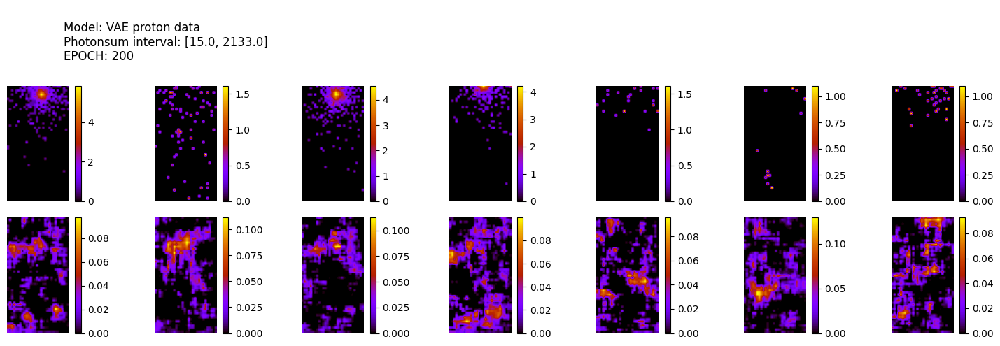

100 [Total loss: 96.81] [Recon_loss: 95.94] [KL loss: 1.25]
200 [Total loss: 96.24] [Recon_loss: 95.45] [KL loss: 1.13]
300 [Total loss: 101.38] [Recon_loss: 100.51] [KL loss: 1.24]


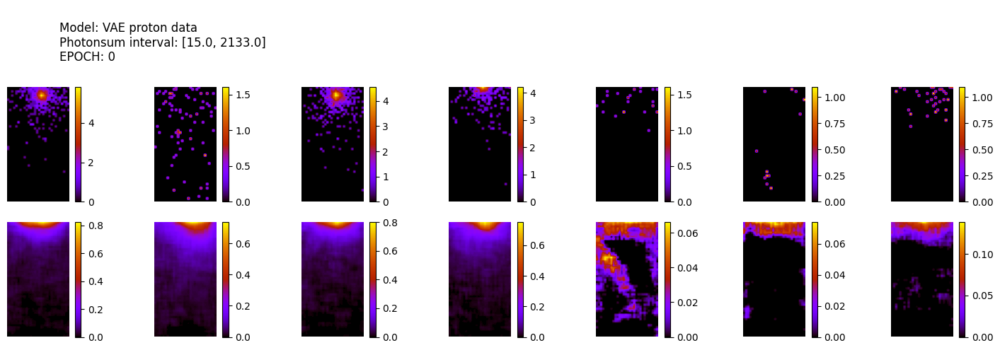

305/305 [==============================] - 2s 4ms/step
ws mean 36.66 ch1 84.73 ch2 6.42 ch3 0.34 ch4 0.02 ch5 91.78 Time for epoch 1 is 24.1724636554718 sec
400 [Total loss: 80.78] [Recon_loss: 80.31] [KL loss: 0.68]
500 [Total loss: 101.36] [Recon_loss: 100.71] [KL loss: 0.93]
600 [Total loss: 92.14] [Recon_loss: 91.52] [KL loss: 0.89]


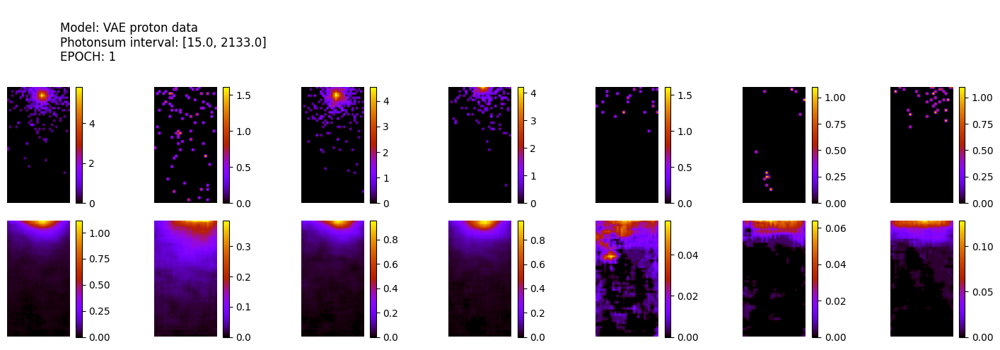

305/305 [==============================] - 1s 4ms/step
ws mean 35.25 ch1 81.45 ch2 6.24 ch3 0.30 ch4 0.02 ch5 88.23 Time for epoch 2 is 17.57027292251587 sec
700 [Total loss: 96.21] [Recon_loss: 95.61] [KL loss: 0.86]
800 [Total loss: 74.95] [Recon_loss: 74.64] [KL loss: 0.45]
900 [Total loss: 82.54] [Recon_loss: 82.18] [KL loss: 0.51]


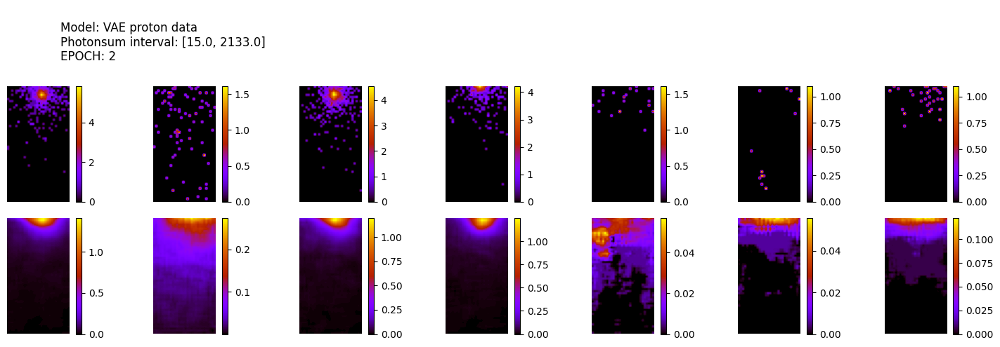

305/305 [==============================] - 1s 4ms/step
ws mean 36.05 ch1 82.85 ch2 6.85 ch3 0.30 ch4 0.02 ch5 90.21 Time for epoch 3 is 17.904780864715576 sec
1000 [Total loss: 82.98] [Recon_loss: 82.65] [KL loss: 0.47]
1100 [Total loss: 77.67] [Recon_loss: 77.39] [KL loss: 0.41]
1200 [Total loss: 108.21] [Recon_loss: 107.73] [KL loss: 0.69]


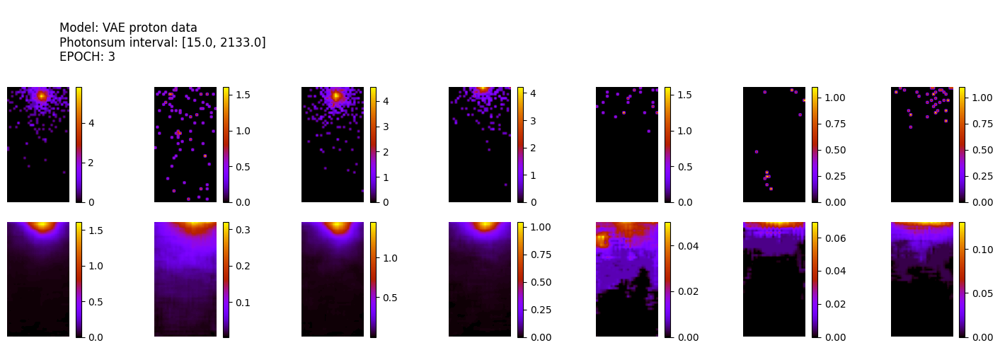

305/305 [==============================] - 1s 4ms/step
ws mean 34.81 ch1 80.17 ch2 6.42 ch3 0.33 ch4 0.02 ch5 87.09 Time for epoch 4 is 17.689422845840454 sec
1300 [Total loss: 105.32] [Recon_loss: 104.83] [KL loss: 0.70]
1400 [Total loss: 97.70] [Recon_loss: 97.31] [KL loss: 0.55]
1500 [Total loss: 98.73] [Recon_loss: 98.39] [KL loss: 0.48]


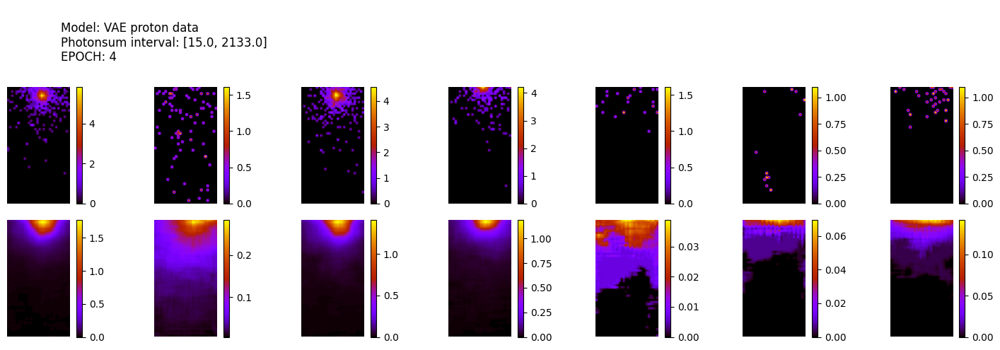

305/305 [==============================] - 1s 4ms/step
ws mean 32.89 ch1 76.38 ch2 5.43 ch3 0.31 ch4 0.02 ch5 82.29 Time for epoch 5 is 18.043254375457764 sec
1600 [Total loss: 83.96] [Recon_loss: 83.79] [KL loss: 0.24]
1700 [Total loss: 99.73] [Recon_loss: 99.40] [KL loss: 0.47]
1800 [Total loss: 108.62] [Recon_loss: 108.26] [KL loss: 0.52]


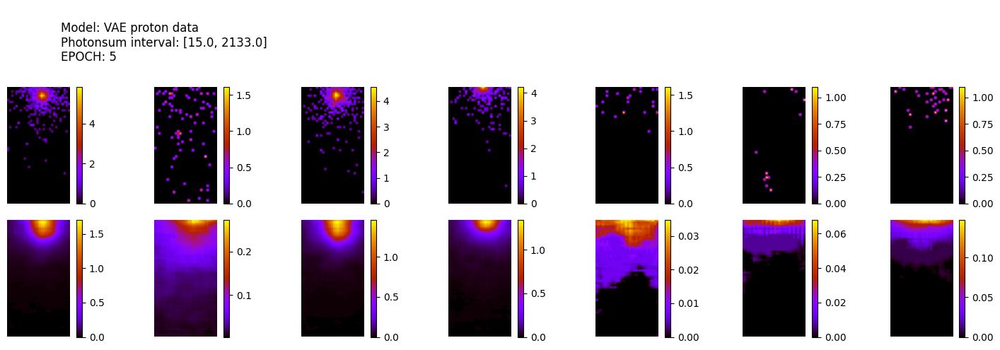

305/305 [==============================] - 1s 4ms/step
ws mean 33.34 ch1 75.81 ch2 7.10 ch3 0.30 ch4 0.02 ch5 83.46 Time for epoch 6 is 19.862810134887695 sec
1900 [Total loss: 108.55] [Recon_loss: 108.18] [KL loss: 0.53]
2000 [Total loss: 74.98] [Recon_loss: 74.84] [KL loss: 0.20]
2100 [Total loss: 105.33] [Recon_loss: 105.05] [KL loss: 0.41]


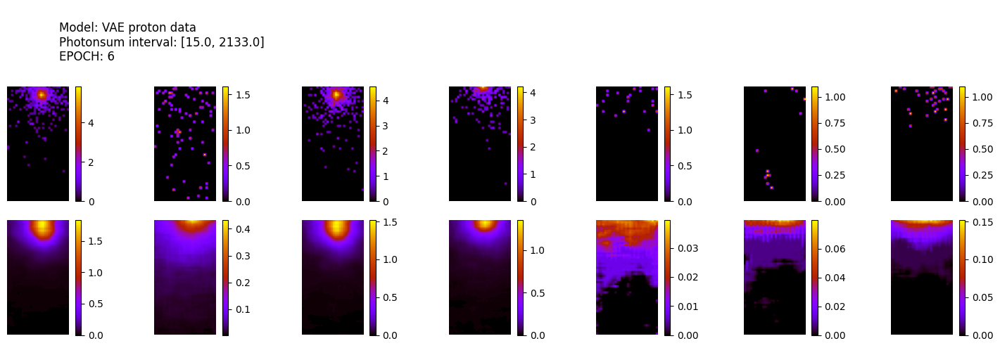

305/305 [==============================] - 1s 4ms/step
ws mean 28.12 ch1 64.57 ch2 5.37 ch3 0.29 ch4 0.02 ch5 70.35 Time for epoch 7 is 20.288517236709595 sec
2200 [Total loss: 89.84] [Recon_loss: 89.59] [KL loss: 0.36]
2300 [Total loss: 86.39] [Recon_loss: 86.25] [KL loss: 0.20]
2400 [Total loss: 93.12] [Recon_loss: 92.88] [KL loss: 0.34]


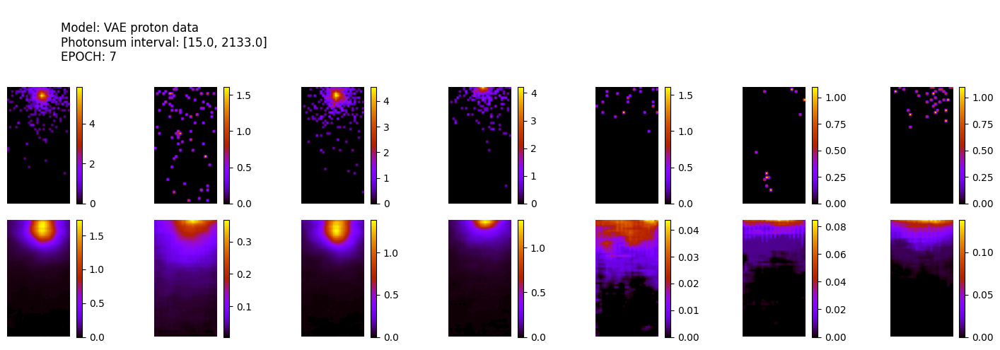

305/305 [==============================] - 1s 4ms/step
ws mean 30.66 ch1 70.71 ch2 5.53 ch3 0.31 ch4 0.02 ch5 76.71 Time for epoch 8 is 20.382229328155518 sec
2500 [Total loss: 92.47] [Recon_loss: 92.26] [KL loss: 0.30]
2600 [Total loss: 112.49] [Recon_loss: 112.26] [KL loss: 0.33]
2700 [Total loss: 84.84] [Recon_loss: 84.74] [KL loss: 0.15]


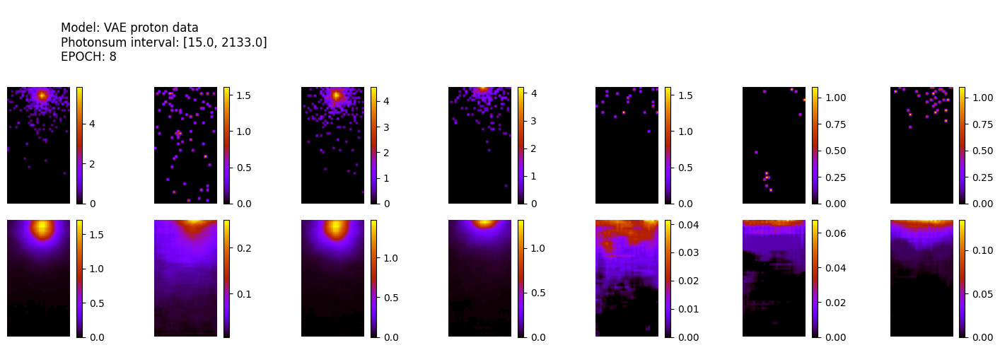

305/305 [==============================] - 1s 4ms/step
ws mean 33.18 ch1 76.30 ch2 6.24 ch3 0.32 ch4 0.02 ch5 83.03 Time for epoch 9 is 20.179492473602295 sec
2800 [Total loss: 103.84] [Recon_loss: 103.68] [KL loss: 0.23]
2900 [Total loss: 88.85] [Recon_loss: 88.71] [KL loss: 0.20]
3000 [Total loss: 84.30] [Recon_loss: 84.21] [KL loss: 0.13]


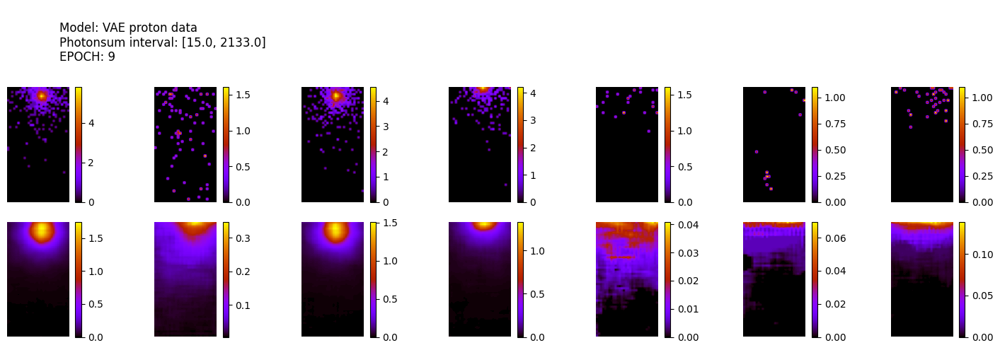

305/305 [==============================] - 1s 4ms/step
ws mean 31.63 ch1 72.80 ch2 5.88 ch3 0.31 ch4 0.02 ch5 79.16 Time for epoch 10 is 20.489222288131714 sec
3100 [Total loss: 93.74] [Recon_loss: 93.64] [KL loss: 0.15]
3200 [Total loss: 99.58] [Recon_loss: 99.43] [KL loss: 0.22]
3300 [Total loss: 86.92] [Recon_loss: 86.80] [KL loss: 0.16]


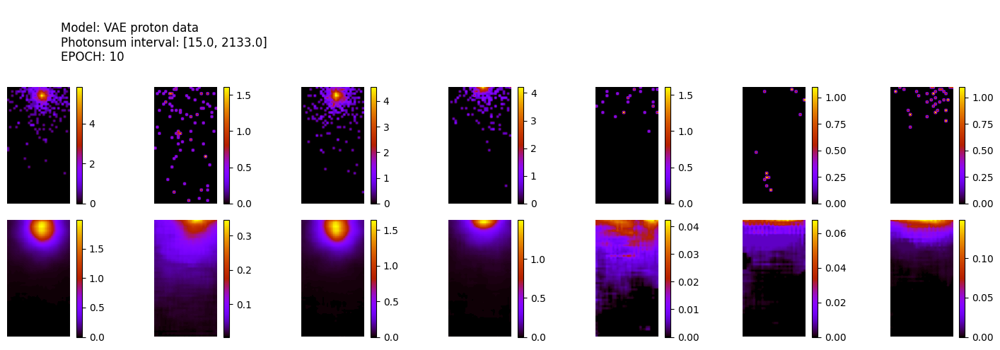

305/305 [==============================] - 1s 4ms/step
ws mean 30.71 ch1 70.46 ch2 5.92 ch3 0.29 ch4 0.01 ch5 76.85 Time for epoch 11 is 22.808226585388184 sec
3400 [Total loss: 90.82] [Recon_loss: 90.70] [KL loss: 0.17]
3500 [Total loss: 101.00] [Recon_loss: 100.85] [KL loss: 0.22]
3600 [Total loss: 100.17] [Recon_loss: 100.04] [KL loss: 0.19]


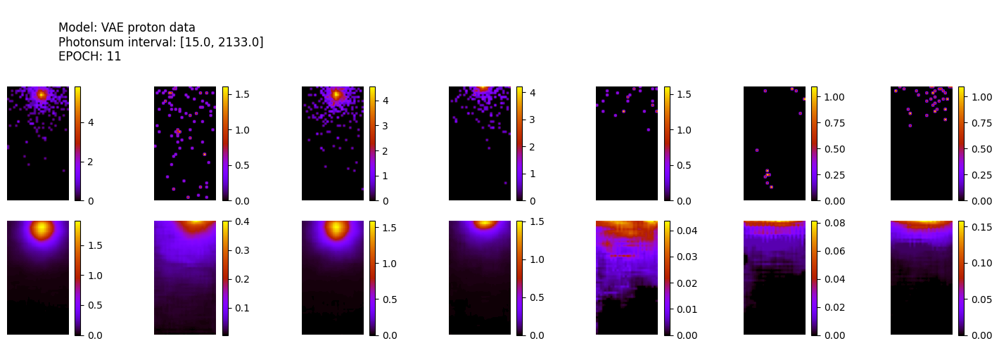

305/305 [==============================] - 1s 4ms/step
ws mean 29.90 ch1 69.08 ch2 5.36 ch3 0.28 ch4 0.01 ch5 74.77 Time for epoch 12 is 22.575565576553345 sec
3700 [Total loss: 96.98] [Recon_loss: 96.80] [KL loss: 0.26]
3800 [Total loss: 77.61] [Recon_loss: 77.56] [KL loss: 0.07]
3900 [Total loss: 75.36] [Recon_loss: 75.29] [KL loss: 0.10]


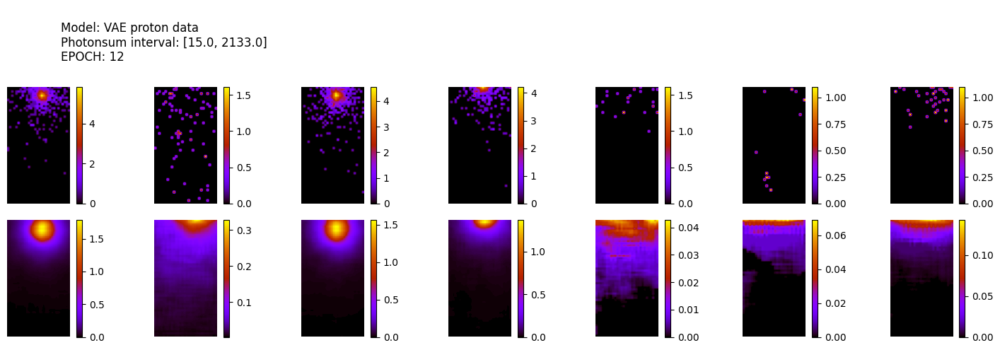

305/305 [==============================] - 1s 4ms/step
ws mean 33.17 ch1 76.34 ch2 6.21 ch3 0.31 ch4 0.02 ch5 82.99 Time for epoch 13 is 22.82875108718872 sec
4000 [Total loss: 105.06] [Recon_loss: 104.97] [KL loss: 0.14]
4100 [Total loss: 93.27] [Recon_loss: 93.14] [KL loss: 0.19]
4200 [Total loss: 98.40] [Recon_loss: 98.28] [KL loss: 0.17]


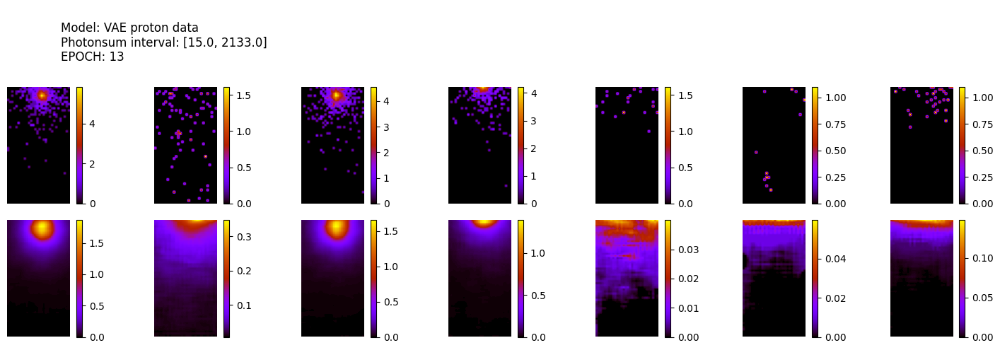

305/305 [==============================] - 1s 4ms/step
ws mean 30.47 ch1 70.59 ch2 5.19 ch3 0.30 ch4 0.01 ch5 76.26 Time for epoch 14 is 22.871896743774414 sec
4300 [Total loss: 83.15] [Recon_loss: 83.09] [KL loss: 0.08]
4400 [Total loss: 96.99] [Recon_loss: 96.82] [KL loss: 0.25]
4500 [Total loss: 98.88] [Recon_loss: 98.79] [KL loss: 0.13]


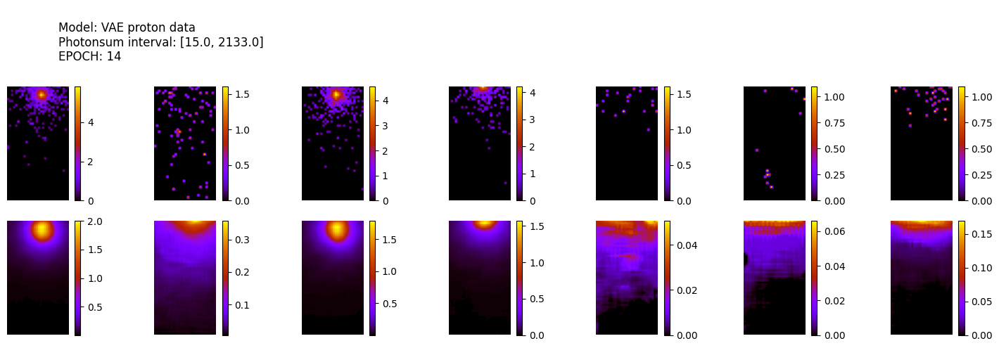

305/305 [==============================] - 1s 4ms/step
ws mean 28.23 ch1 65.84 ch2 4.47 ch3 0.27 ch4 0.01 ch5 70.54 Time for epoch 15 is 22.659035682678223 sec
4600 [Total loss: 89.81] [Recon_loss: 89.74] [KL loss: 0.10]
4700 [Total loss: 110.42] [Recon_loss: 110.21] [KL loss: 0.30]
4800 [Total loss: 87.73] [Recon_loss: 87.50] [KL loss: 0.34]


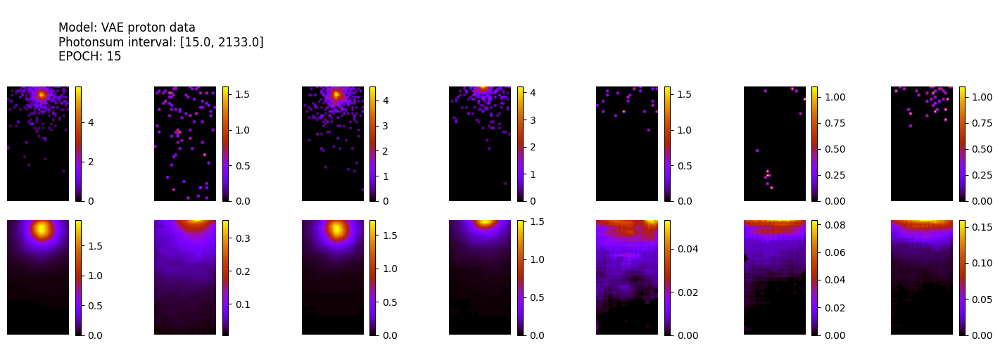

305/305 [==============================] - 1s 4ms/step
ws mean 30.09 ch1 69.71 ch2 5.24 ch3 0.28 ch4 0.01 ch5 75.19 Time for epoch 16 is 25.176257371902466 sec
4900 [Total loss: 90.48] [Recon_loss: 90.39] [KL loss: 0.13]
5000 [Total loss: 91.49] [Recon_loss: 91.38] [KL loss: 0.16]
5100 [Total loss: 96.99] [Recon_loss: 96.90] [KL loss: 0.14]


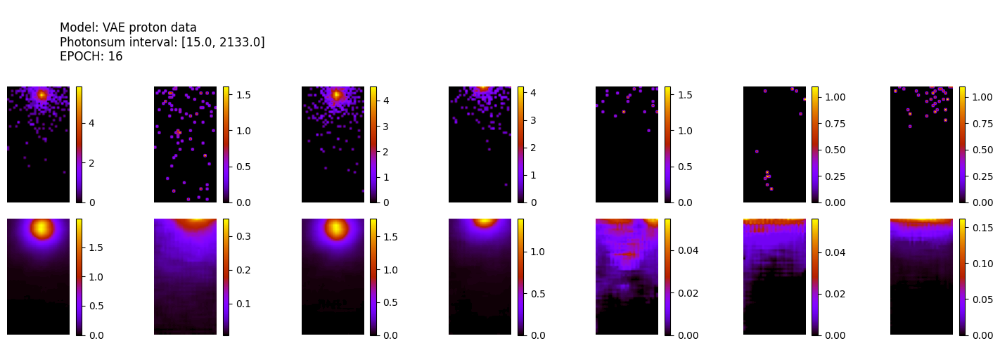

305/305 [==============================] - 1s 4ms/step
ws mean 28.66 ch1 65.90 ch2 5.40 ch3 0.28 ch4 0.01 ch5 71.73 Time for epoch 17 is 25.183878421783447 sec
5200 [Total loss: 103.26] [Recon_loss: 103.19] [KL loss: 0.10]
5300 [Total loss: 94.04] [Recon_loss: 93.98] [KL loss: 0.09]
5400 [Total loss: 72.39] [Recon_loss: 72.37] [KL loss: 0.04]


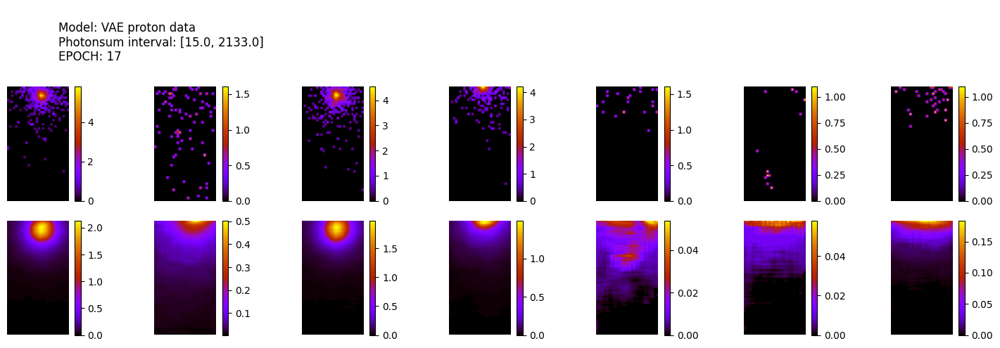

305/305 [==============================] - 1s 4ms/step
ws mean 27.04 ch1 62.05 ch2 5.22 ch3 0.27 ch4 0.01 ch5 67.64 Time for epoch 18 is 24.970664501190186 sec
5500 [Total loss: 101.48] [Recon_loss: 101.31] [KL loss: 0.24]
5600 [Total loss: 85.09] [Recon_loss: 84.99] [KL loss: 0.14]
5700 [Total loss: 79.88] [Recon_loss: 79.82] [KL loss: 0.09]


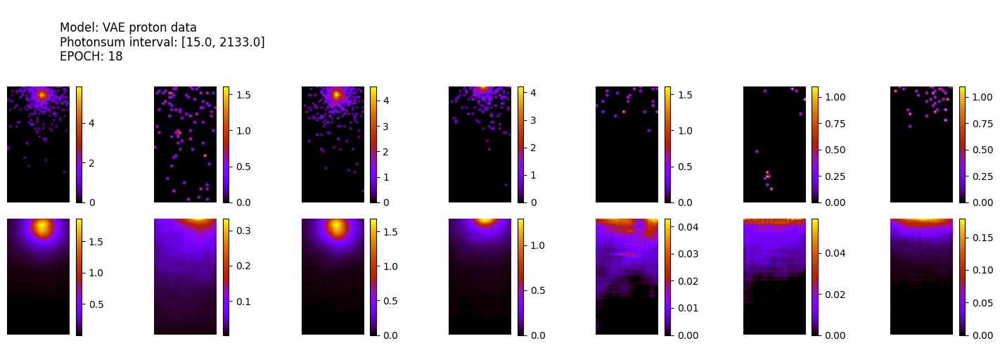

305/305 [==============================] - 1s 4ms/step
ws mean 34.16 ch1 78.37 ch2 6.63 ch3 0.31 ch4 0.02 ch5 85.49 Time for epoch 19 is 25.198249340057373 sec
5800 [Total loss: 78.88] [Recon_loss: 78.85] [KL loss: 0.05]
5900 [Total loss: 98.73] [Recon_loss: 98.68] [KL loss: 0.07]
6000 [Total loss: 79.28] [Recon_loss: 79.24] [KL loss: 0.07]
6100 [Total loss: 94.51] [Recon_loss: 94.44] [KL loss: 0.10]


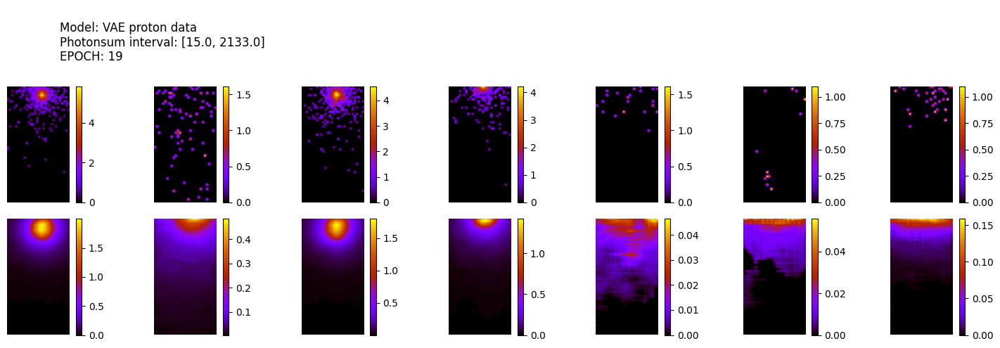

305/305 [==============================] - 1s 4ms/step
ws mean 29.42 ch1 67.62 ch2 5.57 ch3 0.27 ch4 0.01 ch5 73.61 Time for epoch 20 is 25.205732822418213 sec
6200 [Total loss: 102.52] [Recon_loss: 102.40] [KL loss: 0.17]
6300 [Total loss: 105.15] [Recon_loss: 105.04] [KL loss: 0.15]
6400 [Total loss: 96.42] [Recon_loss: 96.30] [KL loss: 0.17]


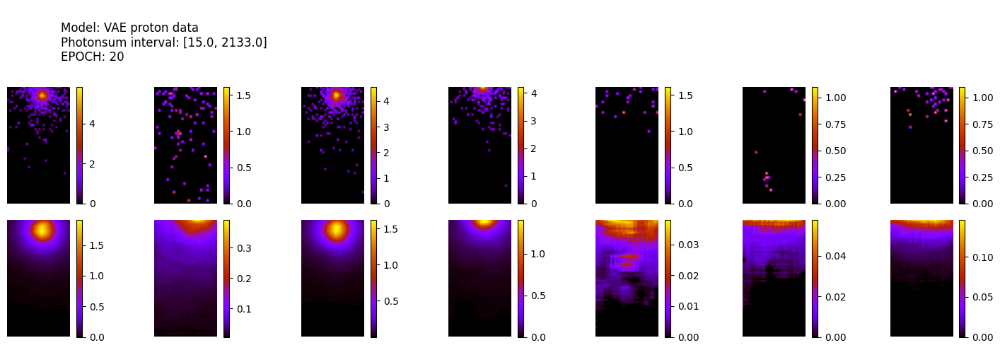

305/305 [==============================] - 1s 4ms/step
ws mean 30.23 ch1 69.80 ch2 5.38 ch3 0.28 ch4 0.01 ch5 75.66 Time for epoch 21 is 27.545878887176514 sec
6500 [Total loss: 81.54] [Recon_loss: 81.51] [KL loss: 0.04]
6600 [Total loss: 75.21] [Recon_loss: 75.19] [KL loss: 0.03]
6700 [Total loss: 100.45] [Recon_loss: 100.40] [KL loss: 0.07]


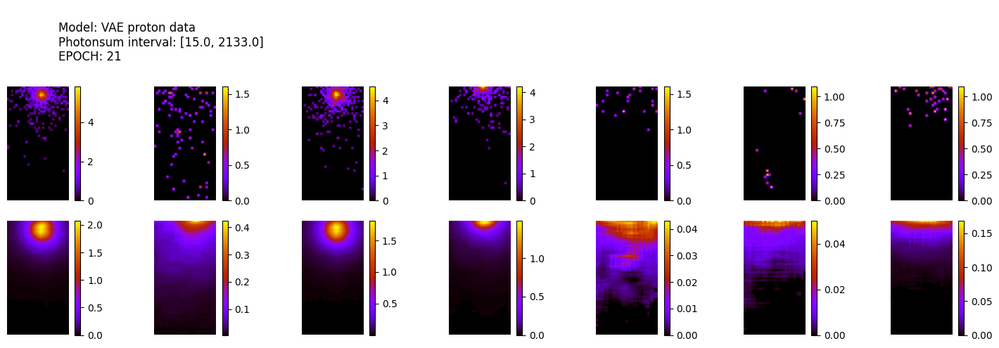

305/305 [==============================] - 1s 4ms/step
ws mean 28.05 ch1 64.92 ch2 4.85 ch3 0.28 ch4 0.01 ch5 70.20 Time for epoch 22 is 27.219828844070435 sec
6800 [Total loss: 75.22] [Recon_loss: 75.21] [KL loss: 0.03]
6900 [Total loss: 87.92] [Recon_loss: 87.80] [KL loss: 0.17]
7000 [Total loss: 81.44] [Recon_loss: 81.38] [KL loss: 0.09]


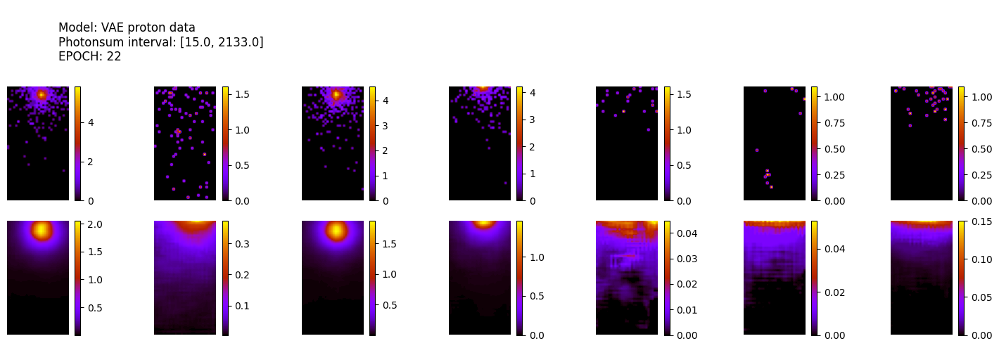

305/305 [==============================] - 1s 4ms/step
ws mean 29.99 ch1 69.07 ch2 5.55 ch3 0.27 ch4 0.01 ch5 75.05 Time for epoch 23 is 27.456047296524048 sec
7100 [Total loss: 89.03] [Recon_loss: 88.79] [KL loss: 0.34]
7200 [Total loss: 85.29] [Recon_loss: 85.17] [KL loss: 0.16]
7300 [Total loss: 88.96] [Recon_loss: 88.90] [KL loss: 0.09]


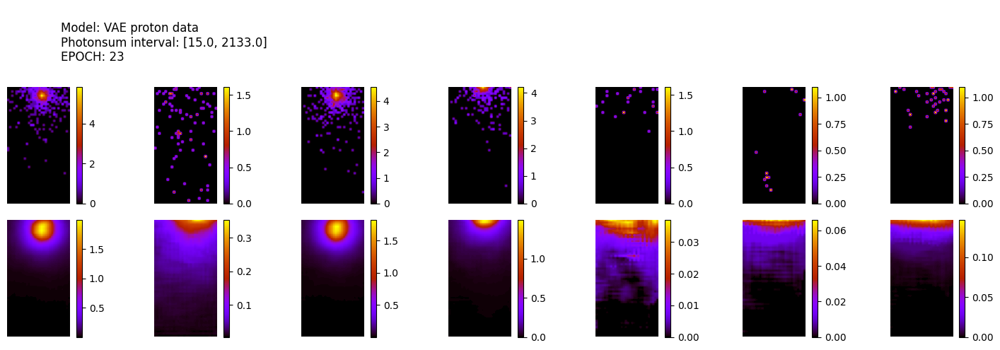

305/305 [==============================] - 1s 4ms/step
ws mean 30.60 ch1 70.67 ch2 5.45 ch3 0.28 ch4 0.01 ch5 76.59 Time for epoch 24 is 27.519124269485474 sec
7400 [Total loss: 99.82] [Recon_loss: 99.78] [KL loss: 0.06]
7500 [Total loss: 104.74] [Recon_loss: 104.65] [KL loss: 0.12]
7600 [Total loss: 97.24] [Recon_loss: 97.16] [KL loss: 0.11]


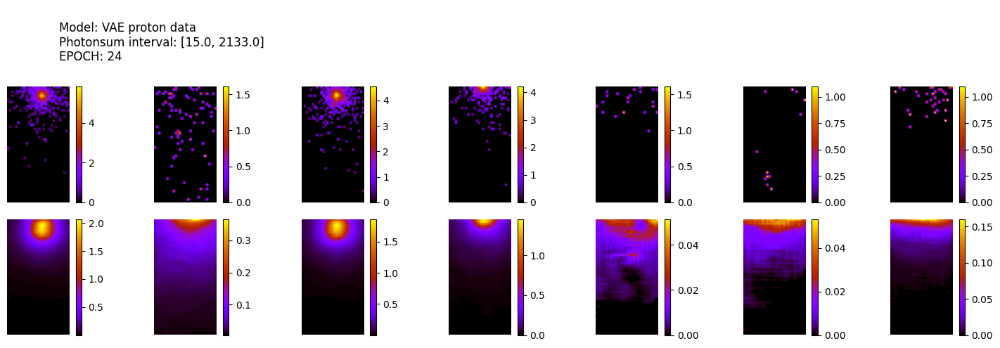

305/305 [==============================] - 1s 4ms/step
ws mean 28.95 ch1 66.64 ch2 5.39 ch3 0.28 ch4 0.01 ch5 72.44 Time for epoch 25 is 27.500239610671997 sec
7700 [Total loss: 97.77] [Recon_loss: 97.58] [KL loss: 0.27]
7800 [Total loss: 83.92] [Recon_loss: 83.82] [KL loss: 0.15]
7900 [Total loss: 91.77] [Recon_loss: 91.68] [KL loss: 0.13]


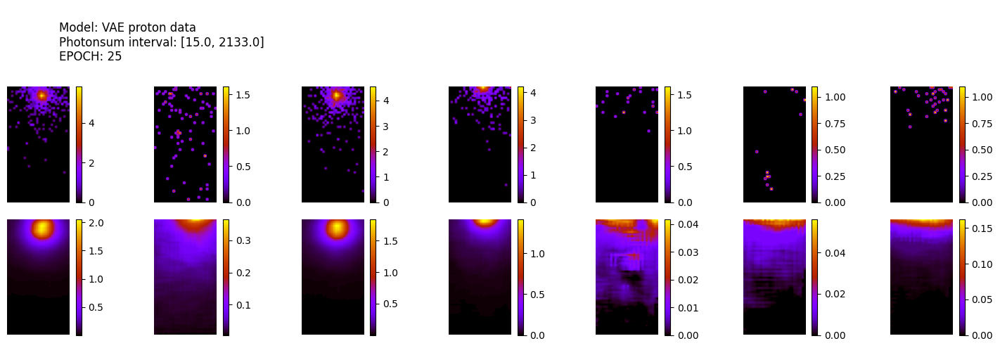

305/305 [==============================] - 1s 4ms/step
ws mean 30.41 ch1 69.90 ch2 5.79 ch3 0.28 ch4 0.01 ch5 76.05 Time for epoch 26 is 27.198601007461548 sec
8000 [Total loss: 103.27] [Recon_loss: 103.05] [KL loss: 0.31]
8100 [Total loss: 99.61] [Recon_loss: 99.54] [KL loss: 0.09]
8200 [Total loss: 97.90] [Recon_loss: 97.76] [KL loss: 0.20]


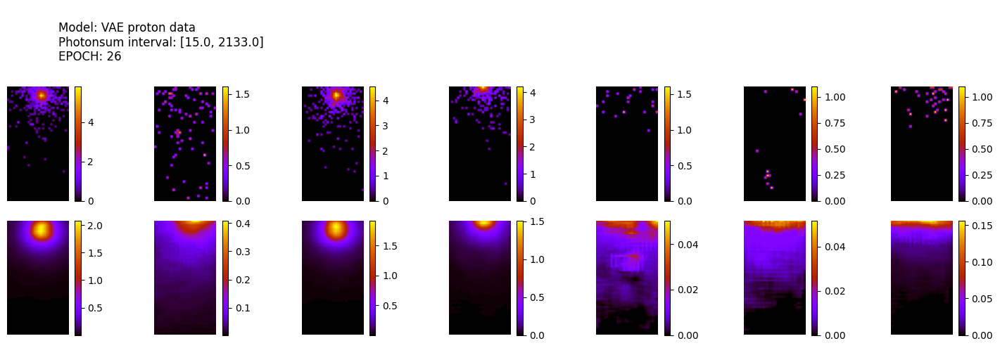

305/305 [==============================] - 1s 4ms/step
ws mean 28.10 ch1 65.24 ch2 4.78 ch3 0.26 ch4 0.01 ch5 70.19 Time for epoch 27 is 27.49961566925049 sec
8300 [Total loss: 85.52] [Recon_loss: 85.49] [KL loss: 0.04]
8400 [Total loss: 92.94] [Recon_loss: 92.92] [KL loss: 0.02]
8500 [Total loss: 89.61] [Recon_loss: 89.51] [KL loss: 0.13]


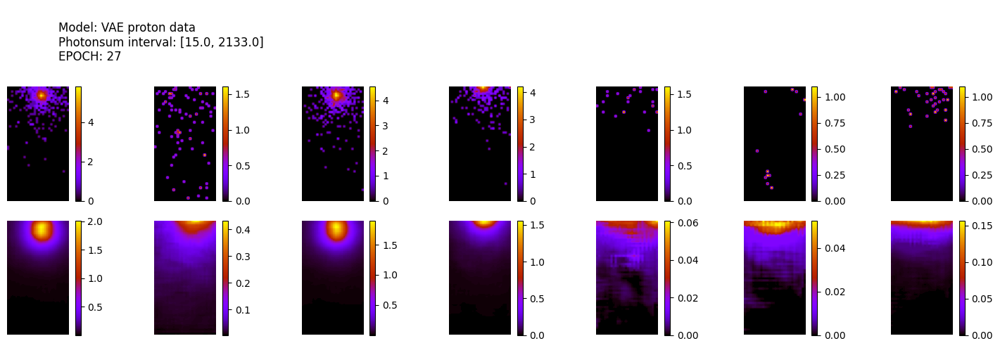

305/305 [==============================] - 1s 4ms/step
ws mean 28.69 ch1 66.37 ch2 5.05 ch3 0.27 ch4 0.01 ch5 71.76 Time for epoch 28 is 27.526214361190796 sec
8600 [Total loss: 83.12] [Recon_loss: 83.08] [KL loss: 0.05]
8700 [Total loss: 93.72] [Recon_loss: 93.67] [KL loss: 0.08]
8800 [Total loss: 86.18] [Recon_loss: 86.15] [KL loss: 0.05]


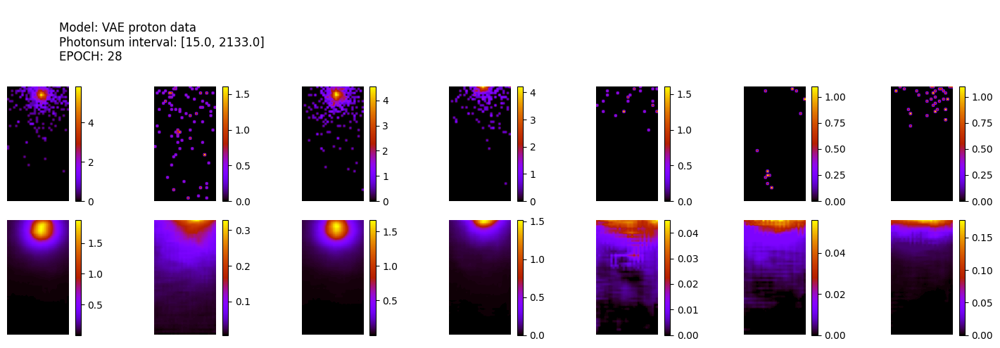

305/305 [==============================] - 1s 4ms/step
ws mean 30.37 ch1 70.25 ch2 5.37 ch3 0.27 ch4 0.01 ch5 75.93 Time for epoch 29 is 27.556392192840576 sec
8900 [Total loss: 85.75] [Recon_loss: 85.63] [KL loss: 0.17]
9000 [Total loss: 97.82] [Recon_loss: 97.72] [KL loss: 0.14]
9100 [Total loss: 91.06] [Recon_loss: 91.03] [KL loss: 0.05]


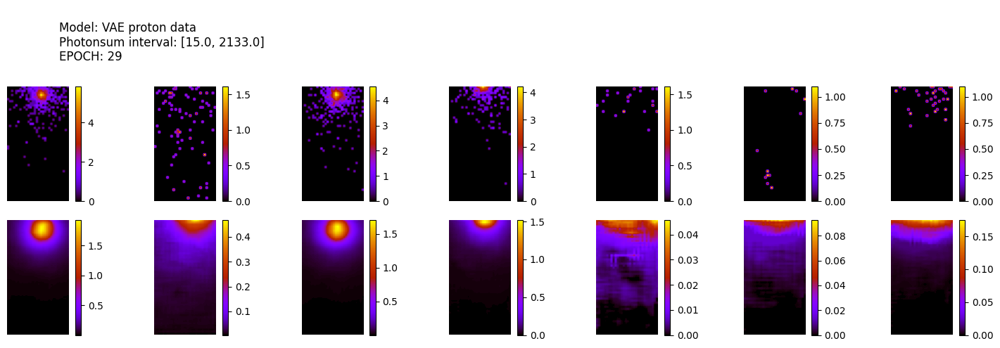

305/305 [==============================] - 1s 4ms/step
ws mean 29.79 ch1 68.80 ch2 5.39 ch3 0.27 ch4 0.01 ch5 74.48 Time for epoch 30 is 27.533140420913696 sec
9200 [Total loss: 91.77] [Recon_loss: 91.75] [KL loss: 0.04]
9300 [Total loss: 85.54] [Recon_loss: 85.43] [KL loss: 0.15]
9400 [Total loss: 97.48] [Recon_loss: 97.45] [KL loss: 0.05]


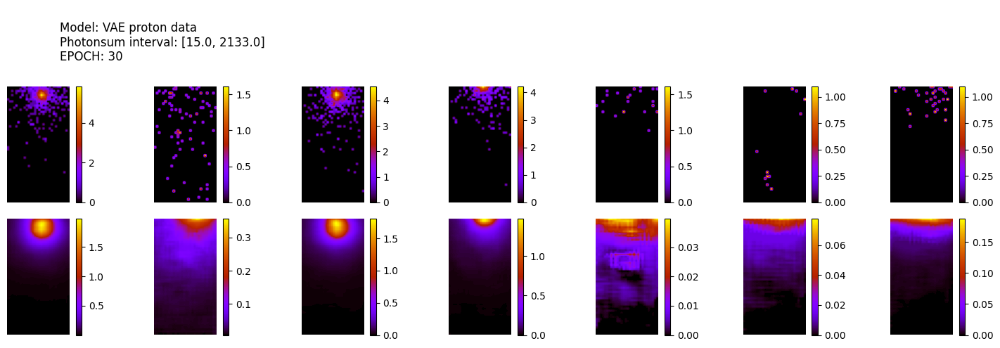

305/305 [==============================] - 1s 4ms/step
ws mean 30.16 ch1 69.68 ch2 5.44 ch3 0.29 ch4 0.01 ch5 75.38 Time for epoch 31 is 27.48035454750061 sec
9500 [Total loss: 82.31] [Recon_loss: 82.28] [KL loss: 0.04]
9600 [Total loss: 91.37] [Recon_loss: 91.33] [KL loss: 0.05]
9700 [Total loss: 95.72] [Recon_loss: 95.69] [KL loss: 0.05]


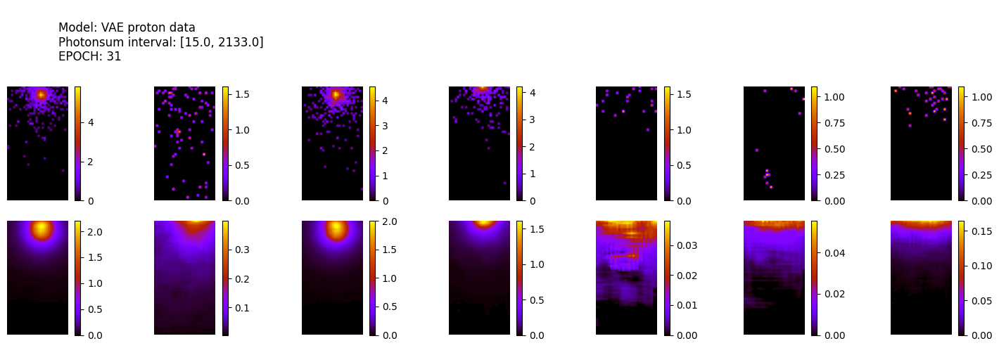

305/305 [==============================] - 1s 4ms/step
ws mean 28.22 ch1 64.89 ch2 5.31 ch3 0.26 ch4 0.01 ch5 70.62 Time for epoch 32 is 27.24146270751953 sec
9800 [Total loss: 89.28] [Recon_loss: 89.22] [KL loss: 0.10]
9900 [Total loss: 89.62] [Recon_loss: 89.58] [KL loss: 0.06]
10000 [Total loss: 93.70] [Recon_loss: 93.53] [KL loss: 0.23]


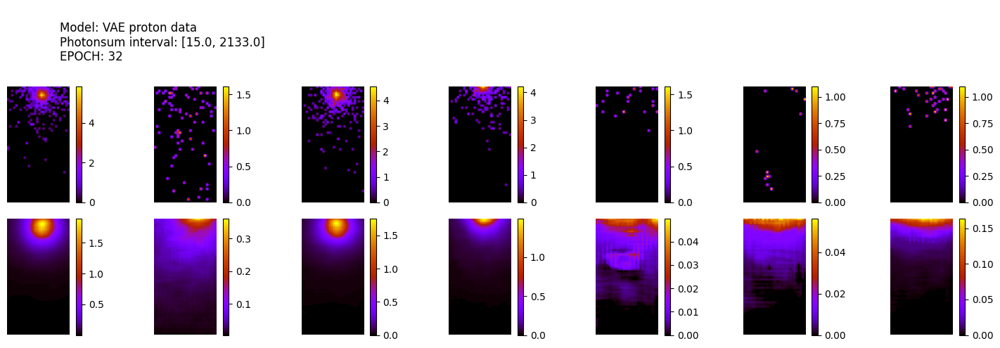

305/305 [==============================] - 1s 4ms/step
ws mean 31.41 ch1 72.25 ch2 5.94 ch3 0.29 ch4 0.01 ch5 78.54 Time for epoch 33 is 27.531243801116943 sec
10100 [Total loss: 90.40] [Recon_loss: 90.35] [KL loss: 0.07]
10200 [Total loss: 104.66] [Recon_loss: 104.51] [KL loss: 0.21]
10300 [Total loss: 83.96] [Recon_loss: 83.94] [KL loss: 0.03]


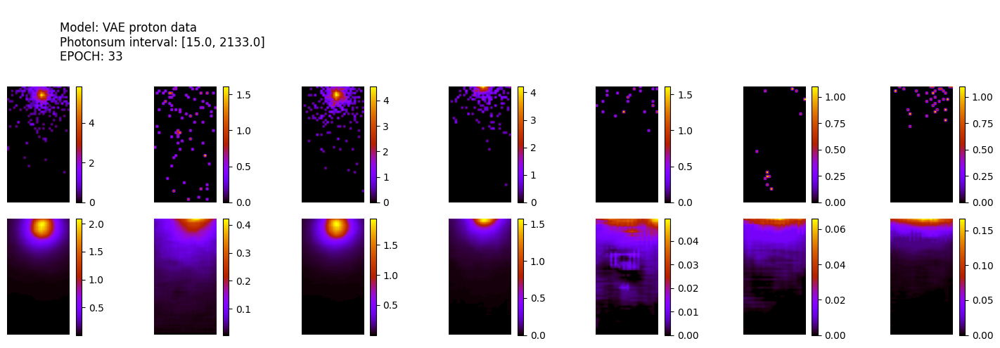

305/305 [==============================] - 1s 4ms/step
ws mean 29.20 ch1 67.34 ch2 5.29 ch3 0.28 ch4 0.01 ch5 73.07 Time for epoch 34 is 27.559845209121704 sec
10400 [Total loss: 90.05] [Recon_loss: 89.99] [KL loss: 0.08]
10500 [Total loss: 98.25] [Recon_loss: 98.14] [KL loss: 0.16]
10600 [Total loss: 87.65] [Recon_loss: 87.53] [KL loss: 0.18]


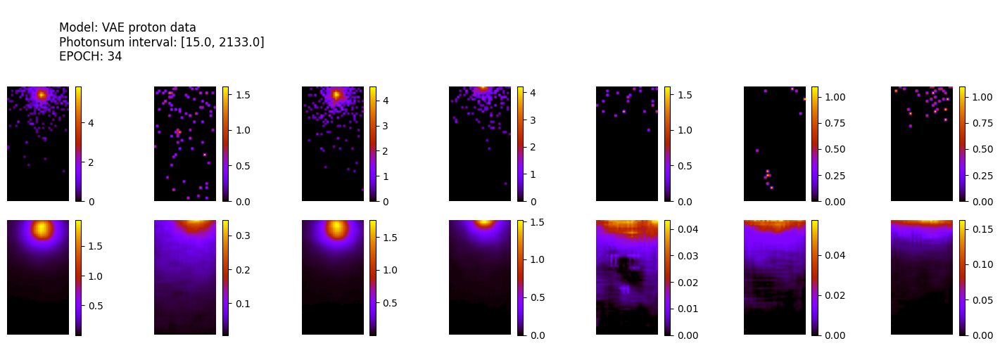

305/305 [==============================] - 1s 4ms/step
ws mean 31.04 ch1 71.63 ch2 5.67 ch3 0.28 ch4 0.01 ch5 77.61 Time for epoch 35 is 27.479187965393066 sec
10700 [Total loss: 98.14] [Recon_loss: 98.09] [KL loss: 0.07]
10800 [Total loss: 101.31] [Recon_loss: 101.27] [KL loss: 0.07]
10900 [Total loss: 87.16] [Recon_loss: 87.10] [KL loss: 0.10]


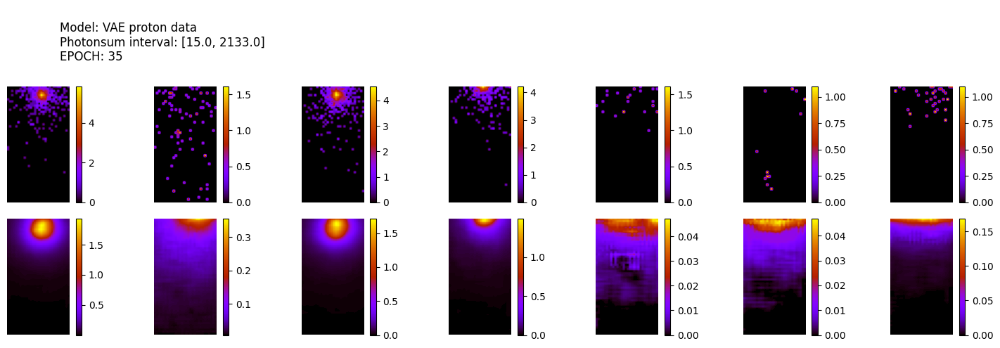

305/305 [==============================] - 1s 4ms/step
ws mean 29.39 ch1 67.75 ch2 5.40 ch3 0.28 ch4 0.01 ch5 73.52 Time for epoch 36 is 27.5146803855896 sec
11000 [Total loss: 101.05] [Recon_loss: 101.03] [KL loss: 0.03]
11100 [Total loss: 84.79] [Recon_loss: 84.74] [KL loss: 0.07]
11200 [Total loss: 95.88] [Recon_loss: 95.82] [KL loss: 0.08]


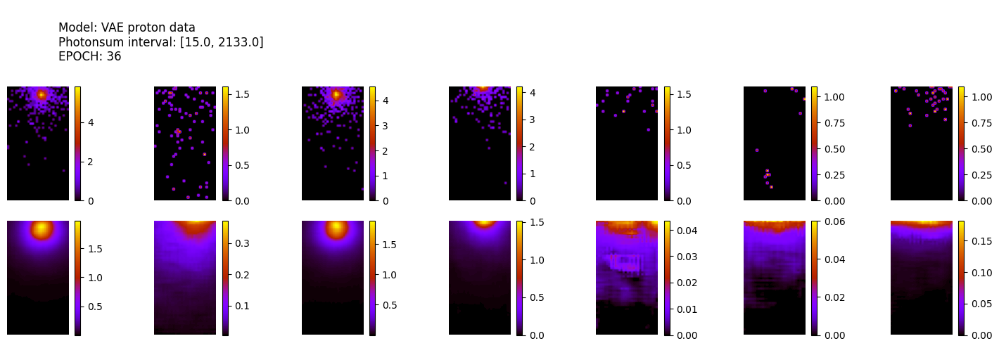

305/305 [==============================] - 1s 4ms/step
ws mean 29.84 ch1 69.06 ch2 5.18 ch3 0.28 ch4 0.01 ch5 74.66 Time for epoch 37 is 27.50164818763733 sec
11300 [Total loss: 86.93] [Recon_loss: 86.79] [KL loss: 0.20]
11400 [Total loss: 96.92] [Recon_loss: 96.88] [KL loss: 0.06]
11500 [Total loss: 101.86] [Recon_loss: 101.69] [KL loss: 0.24]


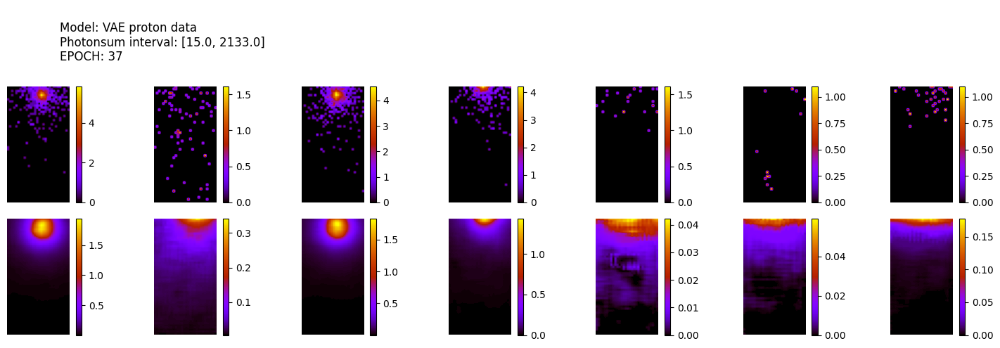

305/305 [==============================] - 1s 4ms/step
ws mean 30.29 ch1 69.54 ch2 5.85 ch3 0.28 ch4 0.01 ch5 75.78 Time for epoch 38 is 27.43339252471924 sec
11600 [Total loss: 81.75] [Recon_loss: 81.72] [KL loss: 0.05]
11700 [Total loss: 105.75] [Recon_loss: 105.64] [KL loss: 0.15]
11800 [Total loss: 93.85] [Recon_loss: 93.80] [KL loss: 0.08]


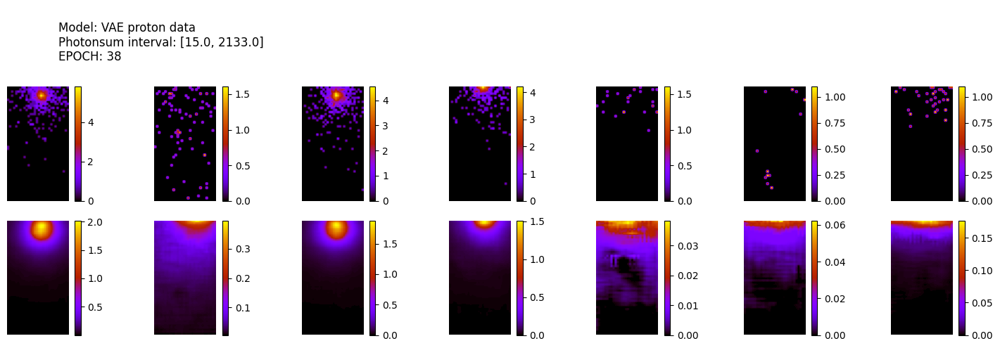

305/305 [==============================] - 1s 4ms/step
ws mean 28.90 ch1 66.47 ch2 5.42 ch3 0.27 ch4 0.01 ch5 72.31 Time for epoch 39 is 27.635098934173584 sec
11900 [Total loss: 97.68] [Recon_loss: 97.65] [KL loss: 0.04]
12000 [Total loss: 86.01] [Recon_loss: 85.99] [KL loss: 0.02]
12100 [Total loss: 92.56] [Recon_loss: 92.52] [KL loss: 0.05]
12200 [Total loss: 92.44] [Recon_loss: 92.43] [KL loss: 0.01]


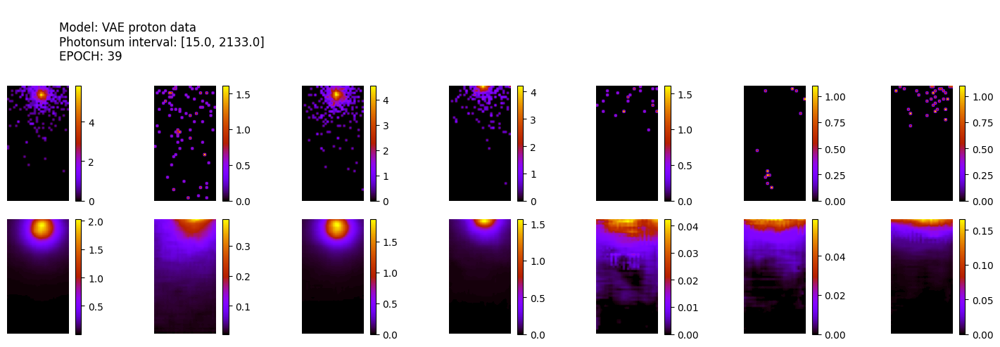

305/305 [==============================] - 1s 4ms/step
ws mean 29.26 ch1 67.46 ch2 5.35 ch3 0.26 ch4 0.01 ch5 73.23 Time for epoch 40 is 27.56160593032837 sec
12300 [Total loss: 77.01] [Recon_loss: 76.96] [KL loss: 0.08]
12400 [Total loss: 77.99] [Recon_loss: 77.97] [KL loss: 0.03]
12500 [Total loss: 85.94] [Recon_loss: 85.89] [KL loss: 0.07]


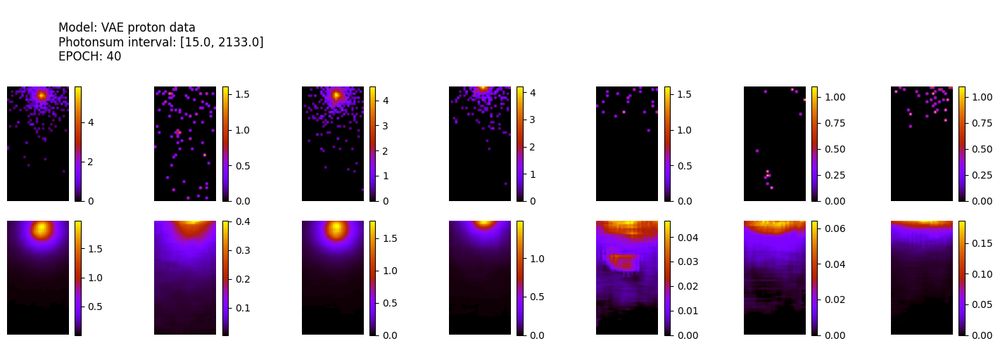

305/305 [==============================] - 1s 4ms/step
ws mean 27.30 ch1 63.46 ch2 4.56 ch3 0.26 ch4 0.01 ch5 68.22 Time for epoch 41 is 27.573371171951294 sec
12600 [Total loss: 74.59] [Recon_loss: 74.57] [KL loss: 0.02]
12700 [Total loss: 81.91] [Recon_loss: 81.86] [KL loss: 0.07]
12800 [Total loss: 98.17] [Recon_loss: 98.05] [KL loss: 0.17]


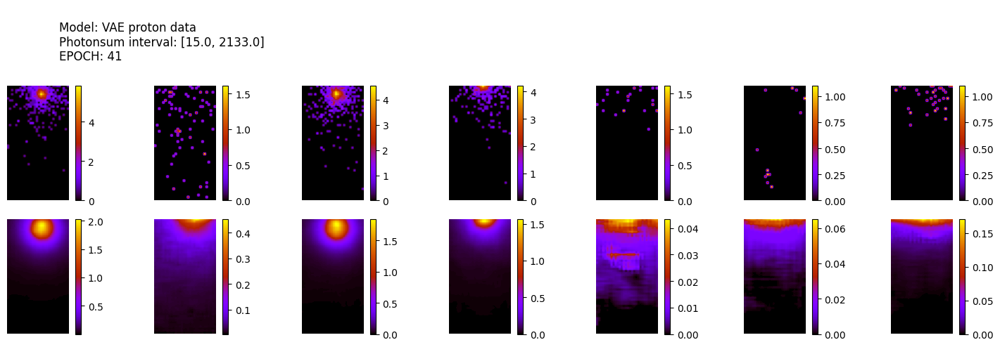

305/305 [==============================] - 1s 4ms/step
ws mean 28.07 ch1 64.93 ch2 4.95 ch3 0.26 ch4 0.01 ch5 70.22 Time for epoch 42 is 27.302438020706177 sec
12900 [Total loss: 96.31] [Recon_loss: 96.29] [KL loss: 0.03]
13000 [Total loss: 97.99] [Recon_loss: 97.95] [KL loss: 0.06]
13100 [Total loss: 99.79] [Recon_loss: 99.77] [KL loss: 0.03]


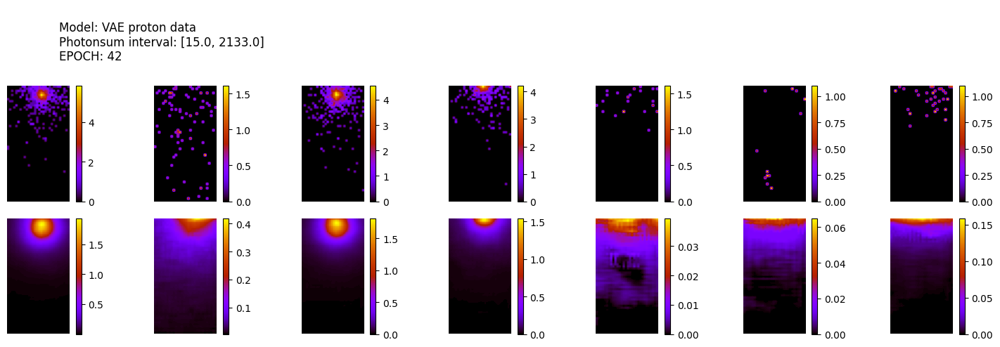

305/305 [==============================] - 1s 4ms/step
ws mean 30.57 ch1 70.21 ch2 5.86 ch3 0.28 ch4 0.01 ch5 76.50 Time for epoch 43 is 27.532655954360962 sec
13200 [Total loss: 100.35] [Recon_loss: 100.21] [KL loss: 0.20]
13300 [Total loss: 100.03] [Recon_loss: 100.00] [KL loss: 0.04]
13400 [Total loss: 93.83] [Recon_loss: 93.76] [KL loss: 0.09]


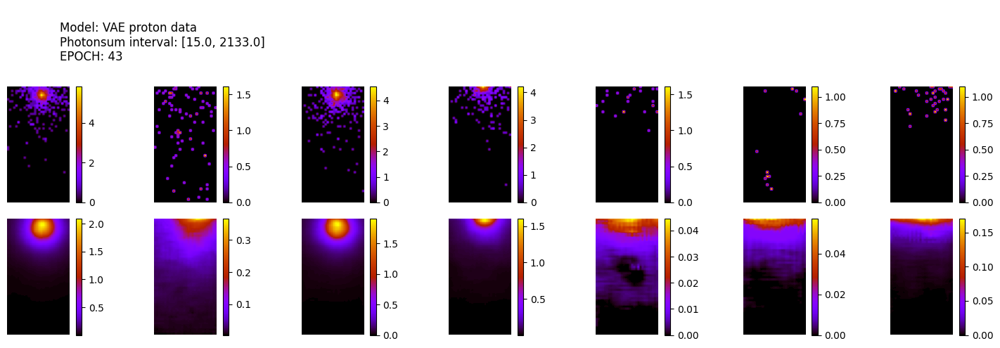

305/305 [==============================] - 1s 4ms/step
ws mean 28.31 ch1 65.08 ch2 5.31 ch3 0.26 ch4 0.01 ch5 70.87 Time for epoch 44 is 27.59337592124939 sec
13500 [Total loss: 102.37] [Recon_loss: 102.12] [KL loss: 0.37]
13600 [Total loss: 79.71] [Recon_loss: 79.70] [KL loss: 0.02]
13700 [Total loss: 94.46] [Recon_loss: 94.34] [KL loss: 0.17]


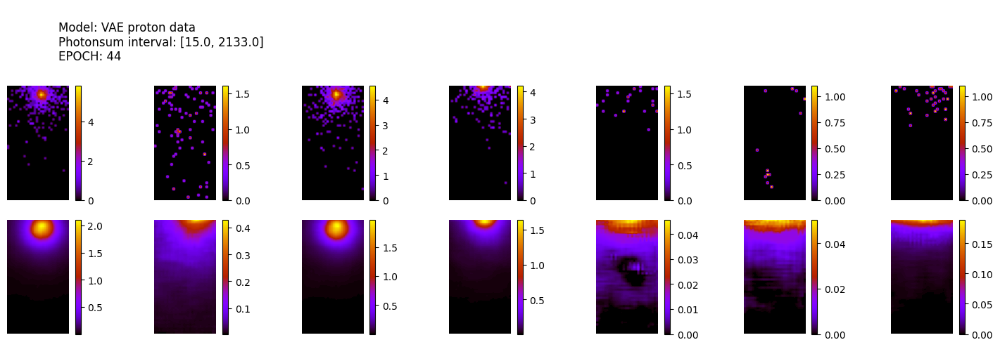

305/305 [==============================] - 1s 4ms/step
ws mean 27.10 ch1 62.64 ch2 4.81 ch3 0.26 ch4 0.01 ch5 67.77 Time for epoch 45 is 27.567053079605103 sec
13800 [Total loss: 95.44] [Recon_loss: 95.35] [KL loss: 0.12]
13900 [Total loss: 95.60] [Recon_loss: 95.56] [KL loss: 0.06]
14000 [Total loss: 78.77] [Recon_loss: 78.69] [KL loss: 0.12]


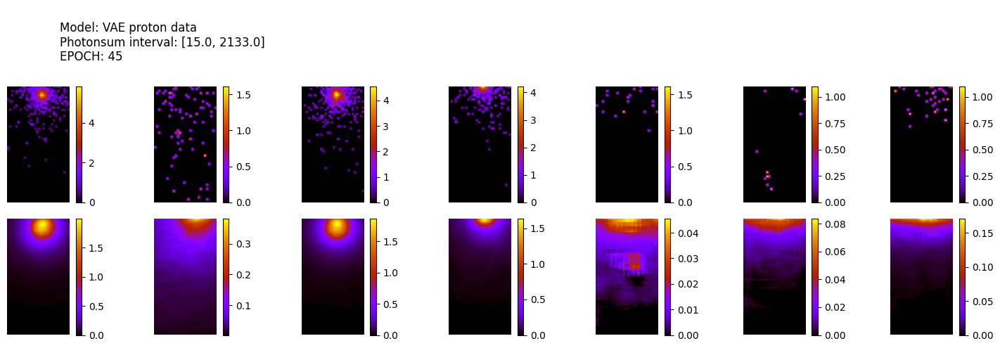

305/305 [==============================] - 1s 4ms/step
ws mean 28.81 ch1 66.46 ch2 5.23 ch3 0.26 ch4 0.01 ch5 72.07 Time for epoch 46 is 27.58421516418457 sec
14100 [Total loss: 113.53] [Recon_loss: 113.34] [KL loss: 0.27]
14200 [Total loss: 97.63] [Recon_loss: 97.62] [KL loss: 0.02]
14300 [Total loss: 95.97] [Recon_loss: 95.92] [KL loss: 0.07]


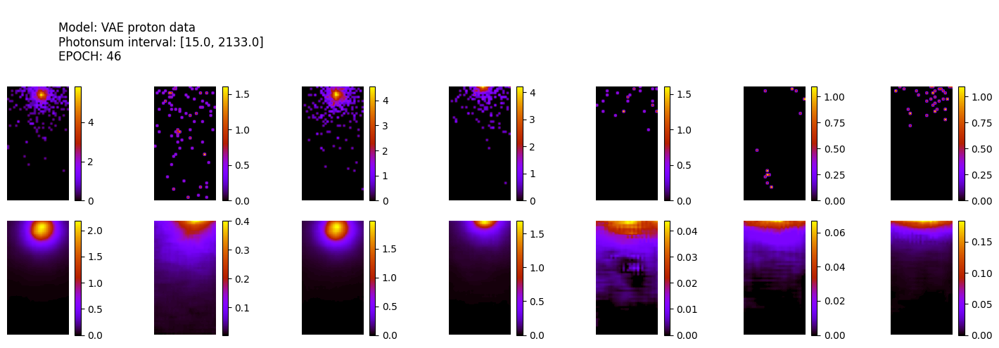

305/305 [==============================] - 1s 4ms/step
ws mean 27.97 ch1 64.14 ch2 5.42 ch3 0.27 ch4 0.01 ch5 69.99 Time for epoch 47 is 28.8526930809021 sec
14400 [Total loss: 94.94] [Recon_loss: 94.86] [KL loss: 0.13]
14500 [Total loss: 88.23] [Recon_loss: 88.03] [KL loss: 0.30]
14600 [Total loss: 99.78] [Recon_loss: 99.73] [KL loss: 0.08]


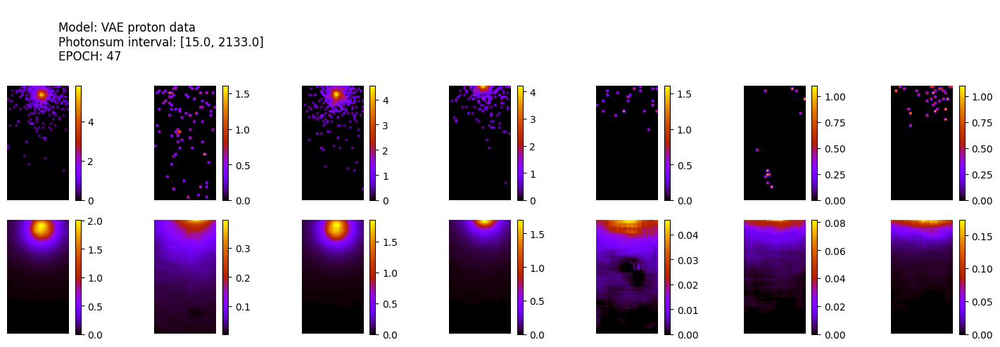

305/305 [==============================] - 1s 4ms/step
ws mean 29.40 ch1 67.76 ch2 5.42 ch3 0.27 ch4 0.01 ch5 73.53 Time for epoch 48 is 27.61306142807007 sec
14700 [Total loss: 99.48] [Recon_loss: 98.95] [KL loss: 0.76]
14800 [Total loss: 76.65] [Recon_loss: 76.63] [KL loss: 0.02]
14900 [Total loss: 82.37] [Recon_loss: 82.35] [KL loss: 0.02]


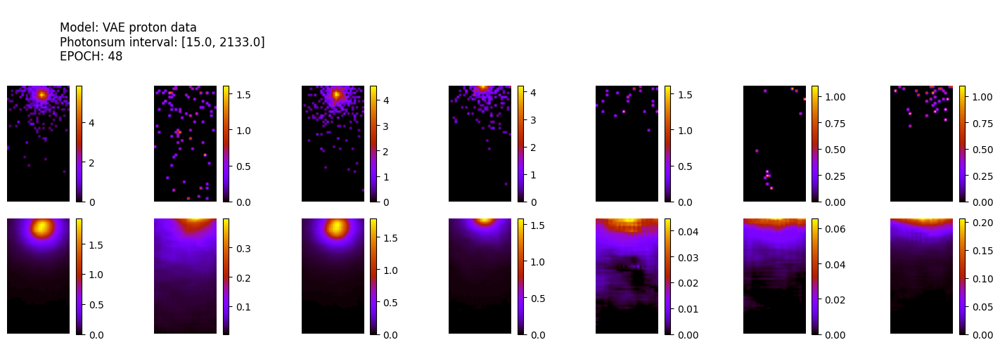

305/305 [==============================] - 1s 4ms/step
ws mean 29.05 ch1 67.10 ch2 5.20 ch3 0.26 ch4 0.01 ch5 72.69 Time for epoch 49 is 27.593650341033936 sec
15000 [Total loss: 82.67] [Recon_loss: 82.56] [KL loss: 0.15]
15100 [Total loss: 105.69] [Recon_loss: 105.60] [KL loss: 0.14]
15200 [Total loss: 82.43] [Recon_loss: 82.42] [KL loss: 0.01]


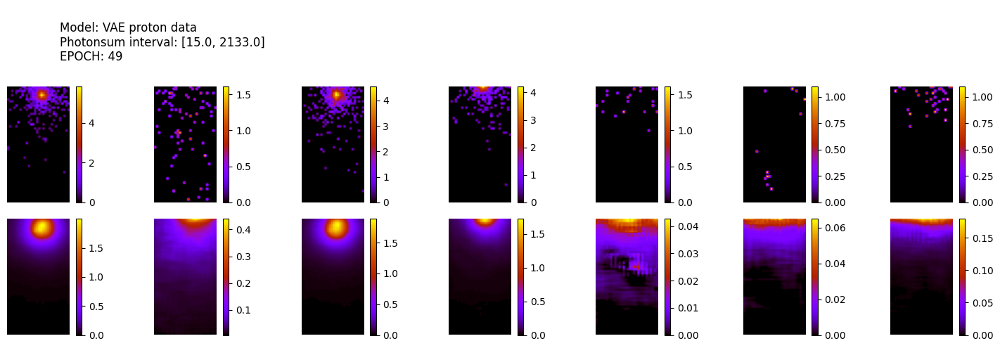

305/305 [==============================] - 1s 4ms/step
ws mean 28.85 ch1 66.15 ch2 5.61 ch3 0.26 ch4 0.01 ch5 72.23 Time for epoch 50 is 27.627713918685913 sec
15300 [Total loss: 76.23] [Recon_loss: 76.20] [KL loss: 0.03]
15400 [Total loss: 92.78] [Recon_loss: 92.75] [KL loss: 0.03]
15500 [Total loss: 95.38] [Recon_loss: 95.35] [KL loss: 0.04]


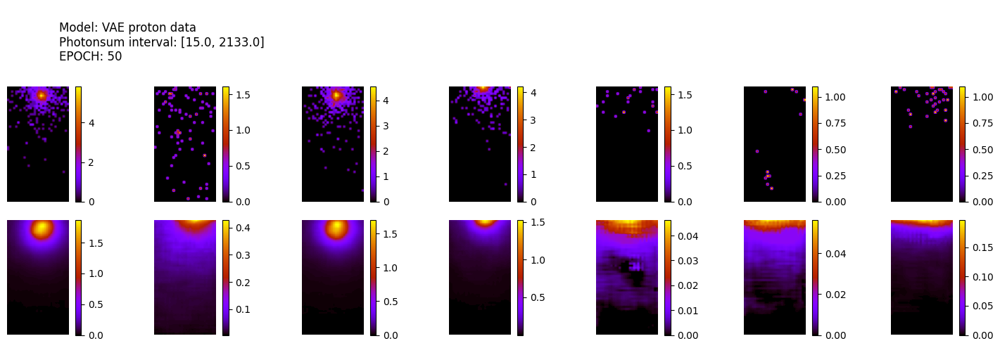

305/305 [==============================] - 1s 4ms/step
ws mean 29.85 ch1 68.89 ch2 5.46 ch3 0.26 ch4 0.01 ch5 74.64 Time for epoch 51 is 27.871652841567993 sec
15600 [Total loss: 86.14] [Recon_loss: 86.12] [KL loss: 0.03]
15700 [Total loss: 93.30] [Recon_loss: 93.27] [KL loss: 0.03]
15800 [Total loss: 117.52] [Recon_loss: 117.12] [KL loss: 0.57]


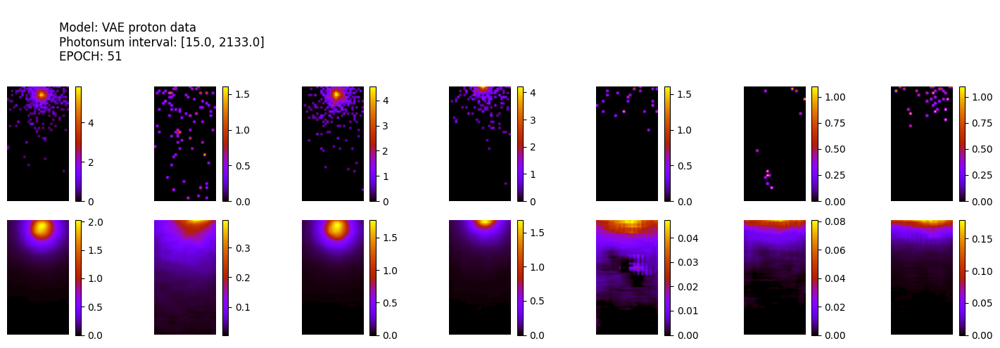

305/305 [==============================] - 1s 4ms/step
ws mean 28.48 ch1 65.50 ch2 5.37 ch3 0.26 ch4 0.01 ch5 71.28 Time for epoch 52 is 27.610836029052734 sec
15900 [Total loss: 96.29] [Recon_loss: 96.27] [KL loss: 0.04]
16000 [Total loss: 92.68] [Recon_loss: 92.63] [KL loss: 0.08]
16100 [Total loss: 92.04] [Recon_loss: 92.02] [KL loss: 0.04]


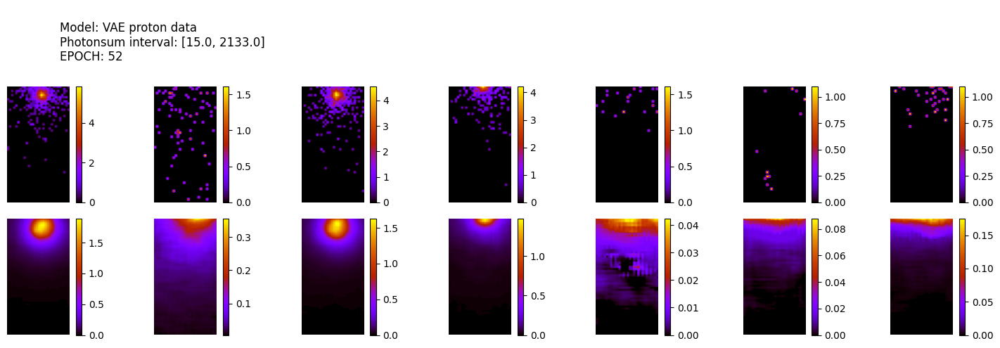

305/305 [==============================] - 1s 4ms/step
ws mean 30.24 ch1 69.72 ch2 5.55 ch3 0.28 ch4 0.01 ch5 75.66 Time for epoch 53 is 27.611683130264282 sec
16200 [Total loss: 75.34] [Recon_loss: 75.34] [KL loss: 0.01]
16300 [Total loss: 109.10] [Recon_loss: 108.85] [KL loss: 0.36]
16400 [Total loss: 101.97] [Recon_loss: 101.90] [KL loss: 0.11]


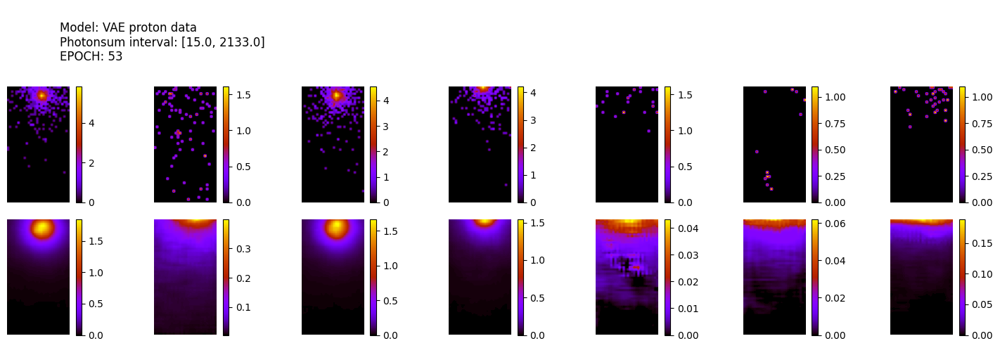

305/305 [==============================] - 1s 4ms/step
ws mean 29.67 ch1 68.44 ch2 5.42 ch3 0.28 ch4 0.01 ch5 74.19 Time for epoch 54 is 27.50294804573059 sec
16500 [Total loss: 79.34] [Recon_loss: 79.31] [KL loss: 0.05]
16600 [Total loss: 97.12] [Recon_loss: 97.01] [KL loss: 0.15]
16700 [Total loss: 99.54] [Recon_loss: 99.46] [KL loss: 0.12]


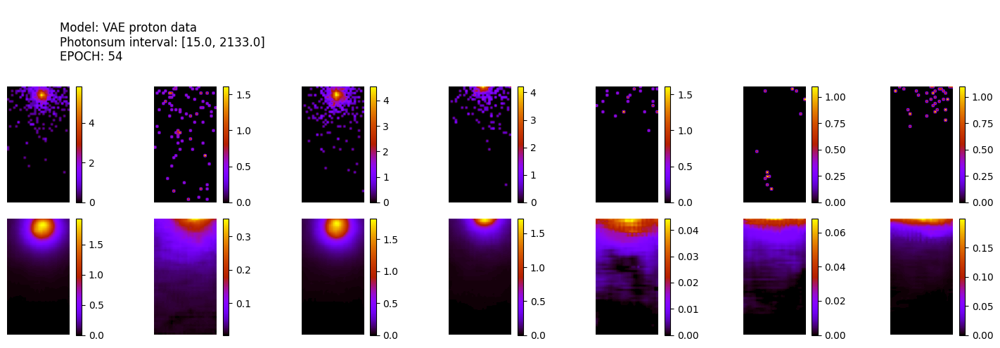

305/305 [==============================] - 1s 4ms/step
ws mean 29.07 ch1 66.98 ch2 5.39 ch3 0.27 ch4 0.01 ch5 72.70 Time for epoch 55 is 27.50840663909912 sec
16800 [Total loss: 86.25] [Recon_loss: 86.24] [KL loss: 0.02]
16900 [Total loss: 96.90] [Recon_loss: 96.82] [KL loss: 0.10]
17000 [Total loss: 100.21] [Recon_loss: 100.20] [KL loss: 0.02]


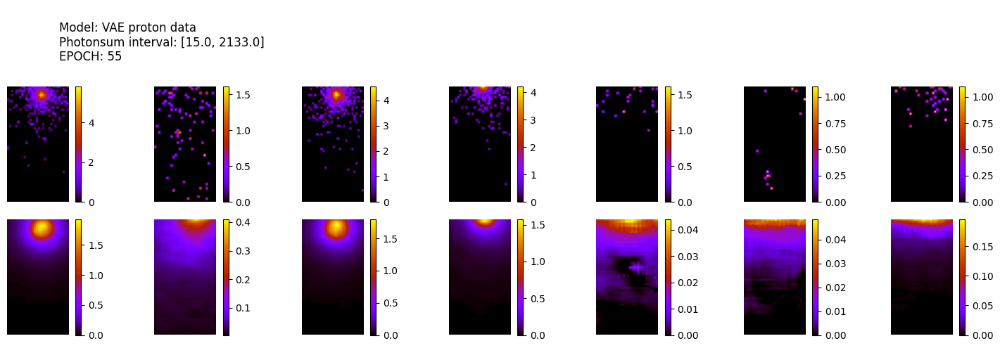

305/305 [==============================] - 1s 4ms/step
ws mean 29.55 ch1 68.18 ch2 5.36 ch3 0.28 ch4 0.01 ch5 73.95 Time for epoch 56 is 27.26500129699707 sec
17100 [Total loss: 87.21] [Recon_loss: 87.19] [KL loss: 0.03]
17200 [Total loss: 92.89] [Recon_loss: 92.75] [KL loss: 0.20]
17300 [Total loss: 79.36] [Recon_loss: 79.33] [KL loss: 0.03]


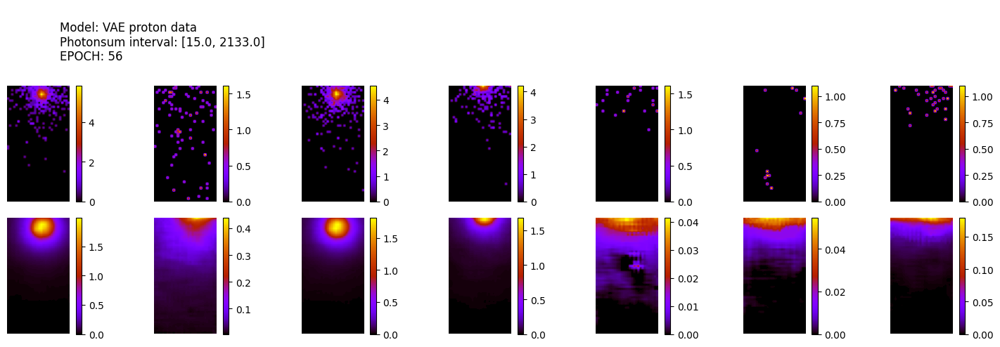

305/305 [==============================] - 1s 4ms/step
ws mean 27.31 ch1 62.72 ch2 5.19 ch3 0.26 ch4 0.01 ch5 68.39 Time for epoch 57 is 27.820221185684204 sec
17400 [Total loss: 96.79] [Recon_loss: 96.76] [KL loss: 0.05]
17500 [Total loss: 108.63] [Recon_loss: 108.54] [KL loss: 0.13]
17600 [Total loss: 96.91] [Recon_loss: 96.89] [KL loss: 0.03]


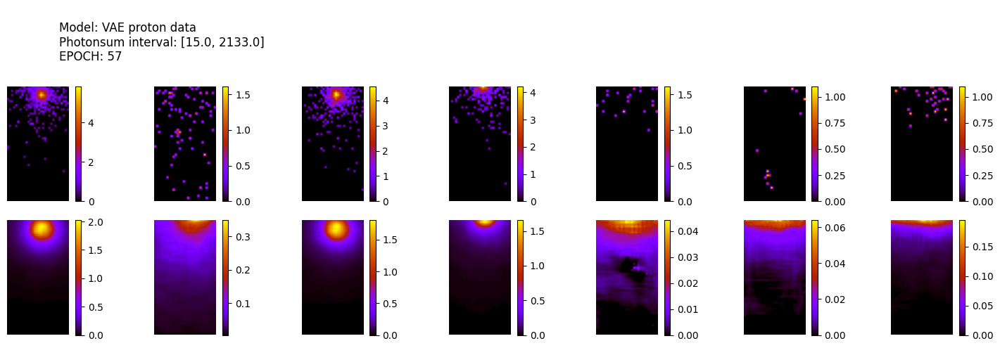

305/305 [==============================] - 1s 4ms/step
ws mean 28.98 ch1 67.02 ch2 5.14 ch3 0.26 ch4 0.01 ch5 72.47 Time for epoch 58 is 27.31215476989746 sec
17700 [Total loss: 81.78] [Recon_loss: 81.76] [KL loss: 0.02]
17800 [Total loss: 93.53] [Recon_loss: 93.46] [KL loss: 0.10]
17900 [Total loss: 84.37] [Recon_loss: 84.34] [KL loss: 0.05]


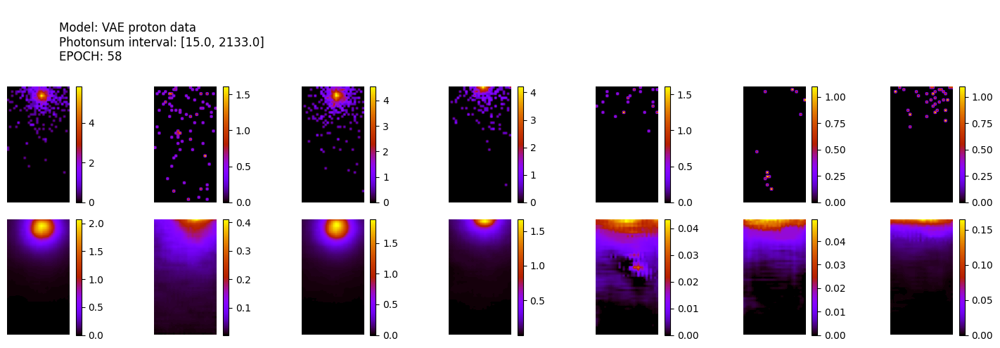

305/305 [==============================] - 1s 4ms/step
ws mean 28.51 ch1 65.55 ch2 5.39 ch3 0.26 ch4 0.01 ch5 71.34 Time for epoch 59 is 27.869139909744263 sec
18000 [Total loss: 89.42] [Recon_loss: 89.32] [KL loss: 0.14]
18100 [Total loss: 94.94] [Recon_loss: 94.77] [KL loss: 0.25]
18200 [Total loss: 81.64] [Recon_loss: 81.62] [KL loss: 0.02]
18300 [Total loss: 99.71] [Recon_loss: 99.65] [KL loss: 0.09]


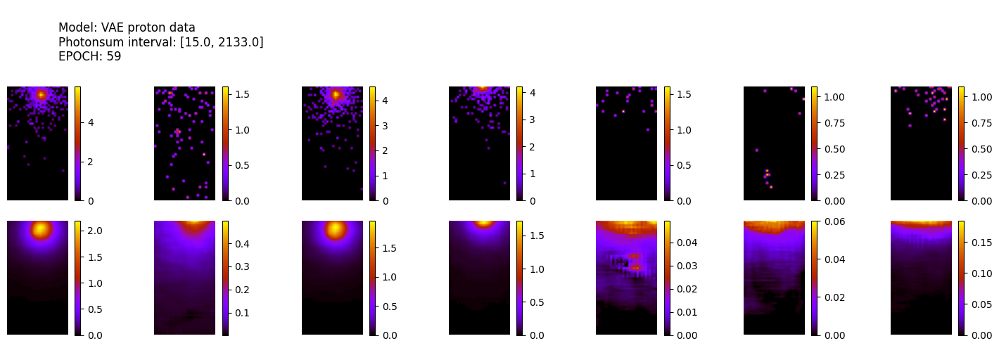

305/305 [==============================] - 1s 4ms/step
ws mean 27.11 ch1 62.43 ch2 5.07 ch3 0.24 ch4 0.01 ch5 67.81 Time for epoch 60 is 27.262878894805908 sec
18400 [Total loss: 81.18] [Recon_loss: 81.08] [KL loss: 0.14]
18500 [Total loss: 103.21] [Recon_loss: 102.98] [KL loss: 0.34]
18600 [Total loss: 102.82] [Recon_loss: 102.79] [KL loss: 0.05]


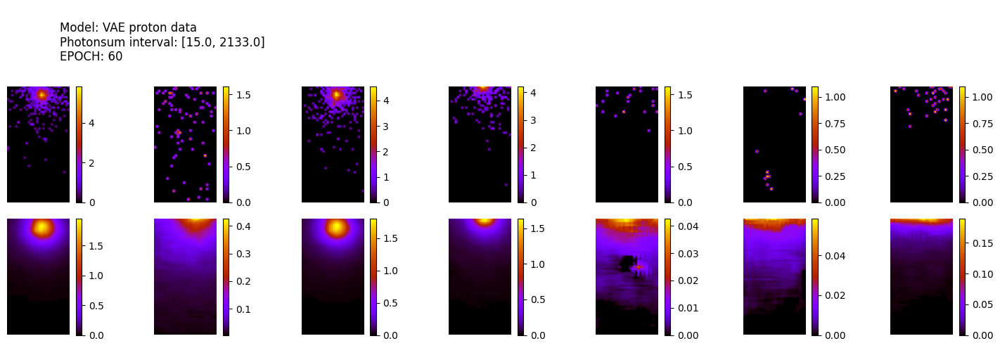

305/305 [==============================] - 1s 4ms/step
ws mean 30.16 ch1 69.51 ch2 5.57 ch3 0.27 ch4 0.01 ch5 75.42 Time for epoch 61 is 27.837044715881348 sec
18700 [Total loss: 90.85] [Recon_loss: 90.78] [KL loss: 0.10]
18800 [Total loss: 75.81] [Recon_loss: 75.80] [KL loss: 0.01]
18900 [Total loss: 84.32] [Recon_loss: 84.28] [KL loss: 0.06]


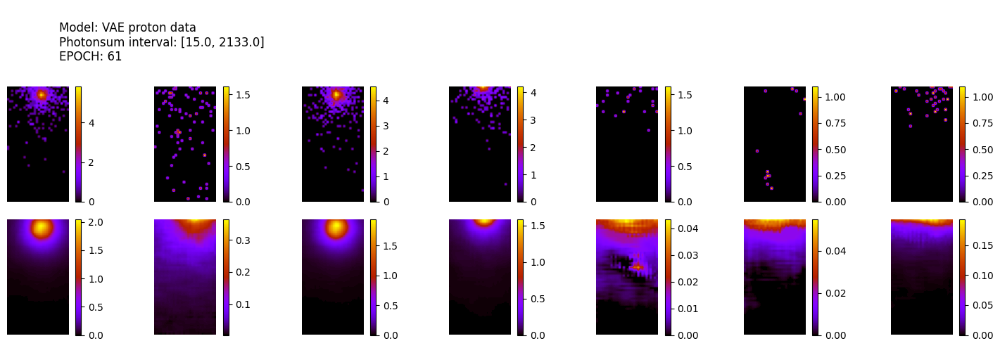

305/305 [==============================] - 1s 4ms/step
ws mean 28.44 ch1 65.38 ch2 5.36 ch3 0.26 ch4 0.01 ch5 71.17 Time for epoch 62 is 27.657369375228882 sec
19000 [Total loss: 80.08] [Recon_loss: 79.99] [KL loss: 0.12]
19100 [Total loss: 91.05] [Recon_loss: 91.02] [KL loss: 0.04]
19200 [Total loss: 88.31] [Recon_loss: 88.28] [KL loss: 0.05]


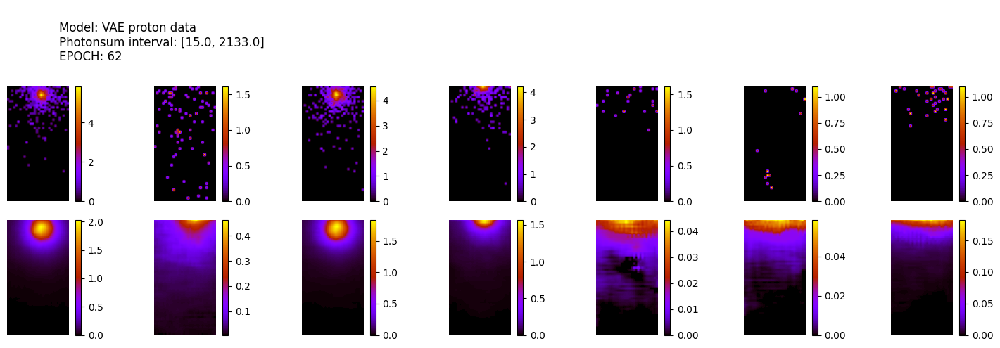

305/305 [==============================] - 1s 4ms/step
ws mean 29.57 ch1 68.53 ch2 5.08 ch3 0.28 ch4 0.01 ch5 73.95 Time for epoch 63 is 27.55126404762268 sec
19300 [Total loss: 79.35] [Recon_loss: 79.32] [KL loss: 0.05]
19400 [Total loss: 81.02] [Recon_loss: 80.92] [KL loss: 0.15]
19500 [Total loss: 74.14] [Recon_loss: 74.13] [KL loss: 0.01]


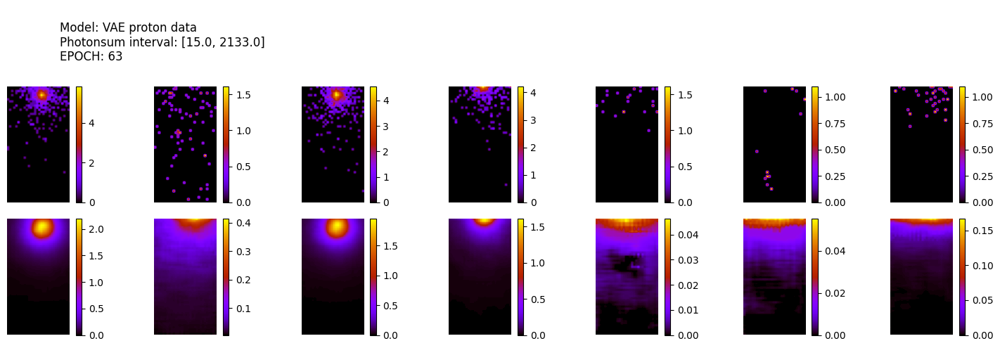

305/305 [==============================] - 1s 4ms/step
ws mean 27.73 ch1 63.79 ch2 5.23 ch3 0.26 ch4 0.01 ch5 69.36 Time for epoch 64 is 28.768885612487793 sec
19600 [Total loss: 93.63] [Recon_loss: 93.48] [KL loss: 0.22]
19700 [Total loss: 86.21] [Recon_loss: 86.15] [KL loss: 0.09]
19800 [Total loss: 87.00] [Recon_loss: 86.96] [KL loss: 0.05]


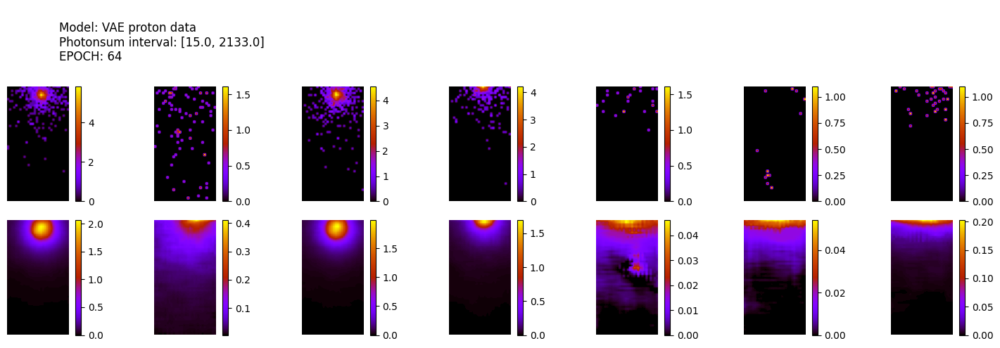

305/305 [==============================] - 1s 4ms/step
ws mean 28.99 ch1 66.92 ch2 5.21 ch3 0.26 ch4 0.01 ch5 72.53 Time for epoch 65 is 27.53497815132141 sec
19900 [Total loss: 108.91] [Recon_loss: 108.78] [KL loss: 0.20]
20000 [Total loss: 91.81] [Recon_loss: 91.70] [KL loss: 0.16]
20100 [Total loss: 92.42] [Recon_loss: 92.28] [KL loss: 0.20]


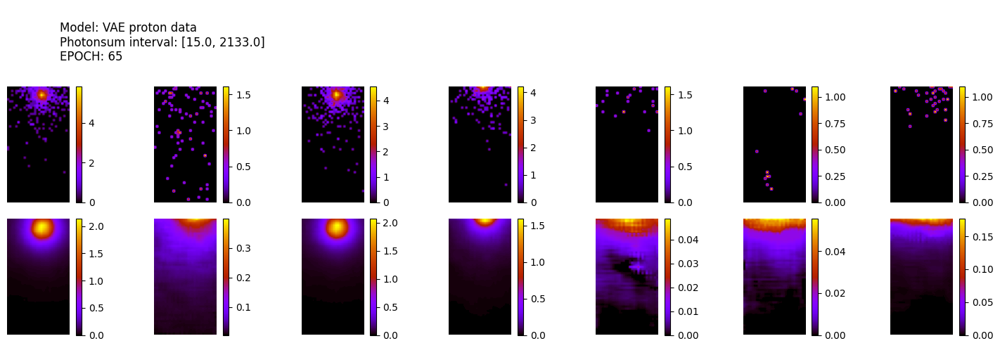

305/305 [==============================] - 1s 4ms/step
ws mean 27.65 ch1 63.97 ch2 4.90 ch3 0.25 ch4 0.01 ch5 69.12 Time for epoch 66 is 27.598131895065308 sec
20200 [Total loss: 103.62] [Recon_loss: 103.56] [KL loss: 0.09]
20300 [Total loss: 78.04] [Recon_loss: 78.02] [KL loss: 0.02]
20400 [Total loss: 99.22] [Recon_loss: 99.15] [KL loss: 0.10]


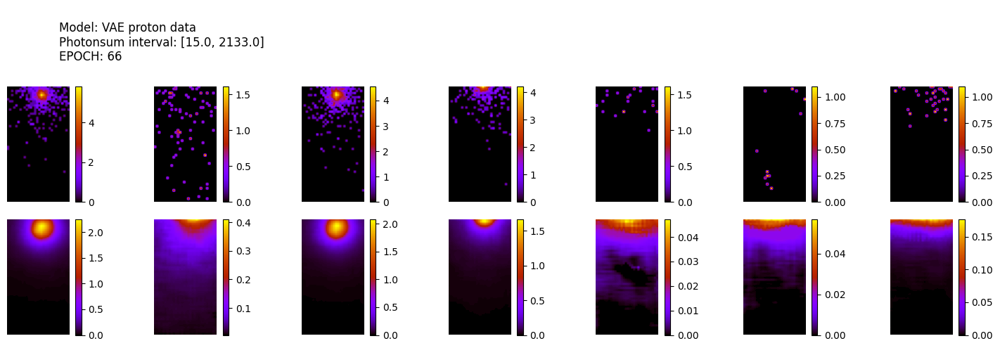

305/305 [==============================] - 1s 4ms/step
ws mean 26.77 ch1 61.36 ch2 5.22 ch3 0.25 ch4 0.01 ch5 67.01 Time for epoch 67 is 27.640626192092896 sec
20500 [Total loss: 86.36] [Recon_loss: 86.34] [KL loss: 0.03]
20600 [Total loss: 100.22] [Recon_loss: 100.11] [KL loss: 0.16]
20700 [Total loss: 89.70] [Recon_loss: 89.59] [KL loss: 0.16]


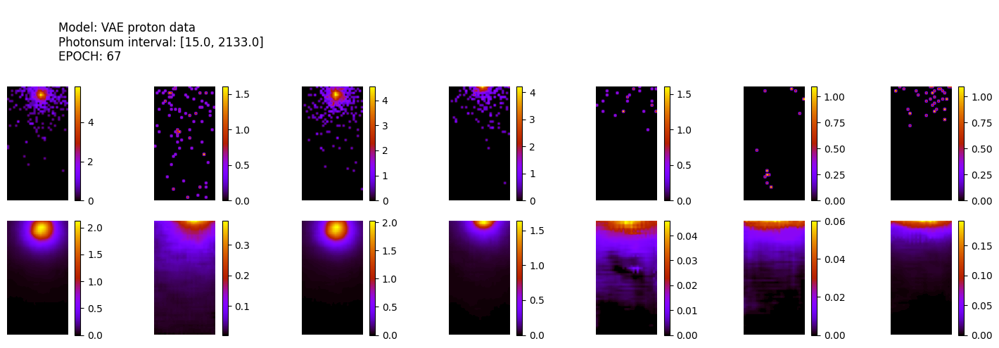

305/305 [==============================] - 1s 4ms/step
ws mean 28.75 ch1 66.22 ch2 5.34 ch3 0.26 ch4 0.01 ch5 71.91 Time for epoch 68 is 27.542383432388306 sec
20800 [Total loss: 94.32] [Recon_loss: 94.29] [KL loss: 0.04]
20900 [Total loss: 89.24] [Recon_loss: 89.12] [KL loss: 0.17]
21000 [Total loss: 89.21] [Recon_loss: 89.19] [KL loss: 0.03]


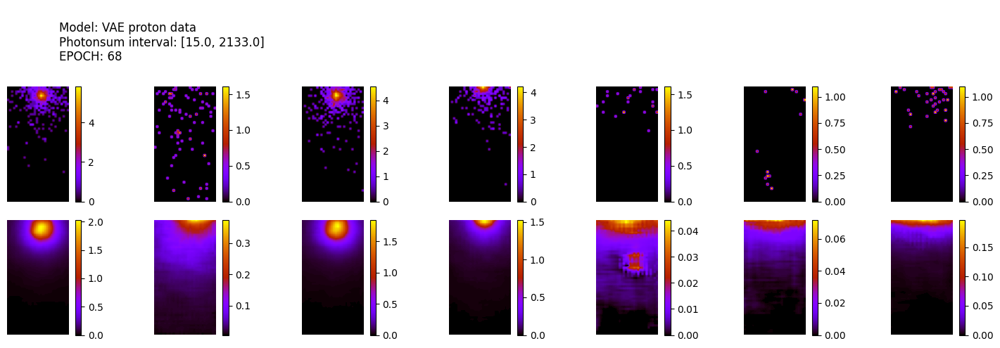

305/305 [==============================] - 1s 4ms/step
ws mean 27.56 ch1 64.02 ch2 4.60 ch3 0.25 ch4 0.01 ch5 68.95 Time for epoch 69 is 27.514636278152466 sec
21100 [Total loss: 98.75] [Recon_loss: 98.71] [KL loss: 0.06]
21200 [Total loss: 76.29] [Recon_loss: 76.27] [KL loss: 0.03]
21300 [Total loss: 84.64] [Recon_loss: 84.54] [KL loss: 0.15]


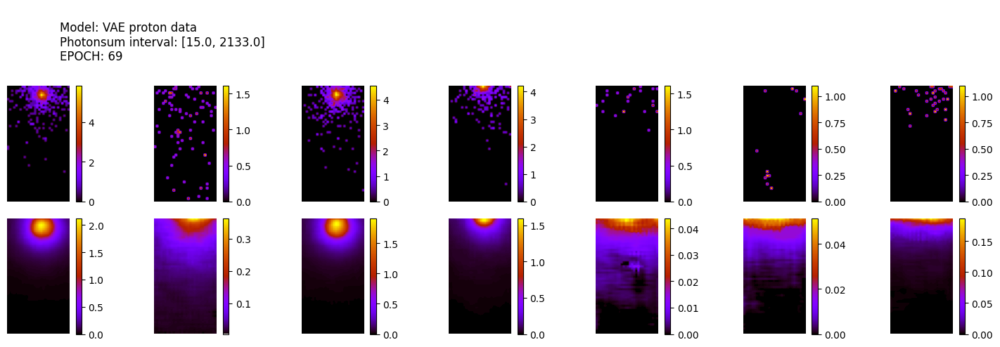

305/305 [==============================] - 1s 4ms/step
ws mean 27.86 ch1 64.14 ch2 5.19 ch3 0.25 ch4 0.01 ch5 69.70 Time for epoch 70 is 27.563151836395264 sec
21400 [Total loss: 82.41] [Recon_loss: 82.38] [KL loss: 0.04]
21500 [Total loss: 84.37] [Recon_loss: 84.35] [KL loss: 0.03]
21600 [Total loss: 87.01] [Recon_loss: 86.92] [KL loss: 0.13]


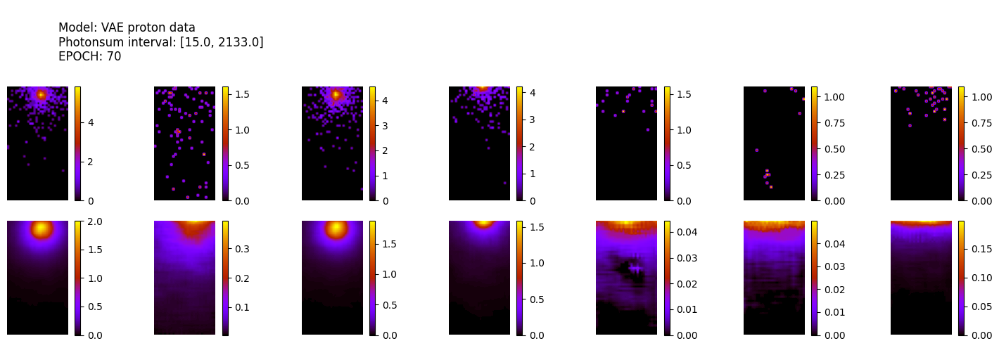

305/305 [==============================] - 1s 4ms/step
ws mean 29.69 ch1 68.94 ch2 4.94 ch3 0.27 ch4 0.01 ch5 74.31 Time for epoch 71 is 27.569885969161987 sec
21700 [Total loss: 92.07] [Recon_loss: 92.01] [KL loss: 0.09]
21800 [Total loss: 90.95] [Recon_loss: 90.78] [KL loss: 0.24]
21900 [Total loss: 93.86] [Recon_loss: 93.78] [KL loss: 0.10]


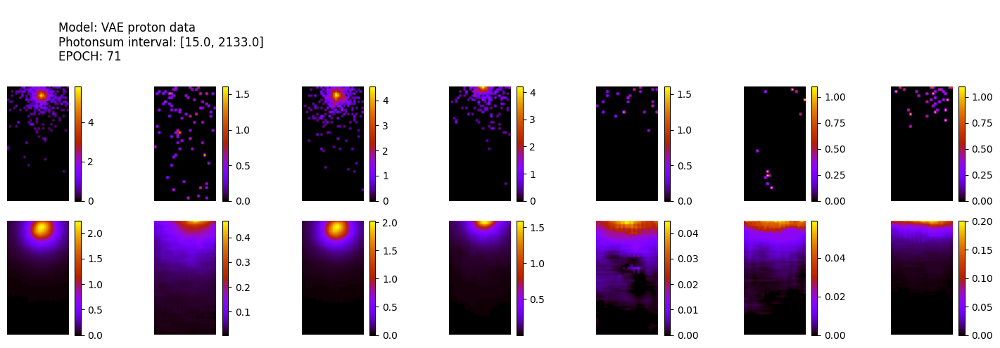

305/305 [==============================] - 1s 4ms/step
ws mean 27.08 ch1 62.05 ch2 5.34 ch3 0.24 ch4 0.01 ch5 67.77 Time for epoch 72 is 27.517215967178345 sec
22000 [Total loss: 86.26] [Recon_loss: 86.20] [KL loss: 0.09]
22100 [Total loss: 103.00] [Recon_loss: 102.97] [KL loss: 0.05]
22200 [Total loss: 96.91] [Recon_loss: 96.73] [KL loss: 0.25]


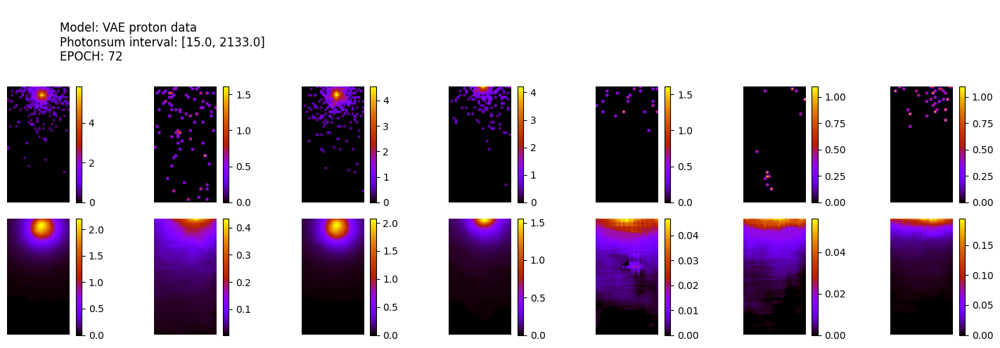

305/305 [==============================] - 1s 4ms/step
ws mean 27.31 ch1 62.90 ch2 5.13 ch3 0.24 ch4 0.01 ch5 68.29 Time for epoch 73 is 27.511391162872314 sec
22300 [Total loss: 105.71] [Recon_loss: 105.57] [KL loss: 0.20]
22400 [Total loss: 83.06] [Recon_loss: 83.02] [KL loss: 0.06]
22500 [Total loss: 99.23] [Recon_loss: 99.17] [KL loss: 0.09]


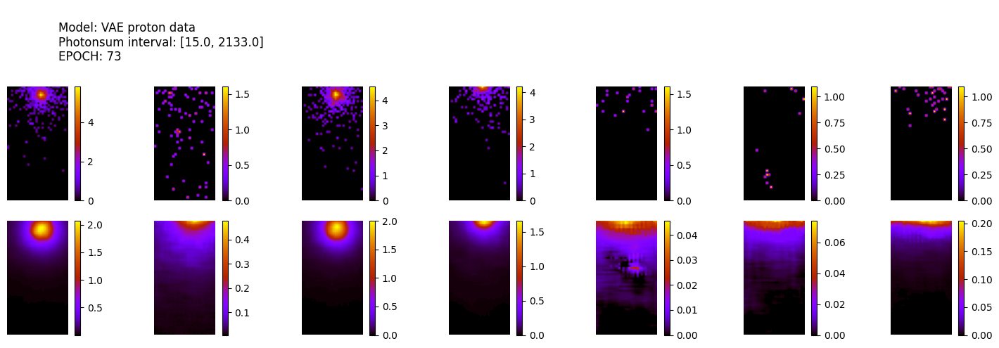

305/305 [==============================] - 1s 4ms/step
ws mean 27.37 ch1 62.89 ch2 5.20 ch3 0.26 ch4 0.01 ch5 68.49 Time for epoch 74 is 27.504754543304443 sec
22600 [Total loss: 98.24] [Recon_loss: 98.09] [KL loss: 0.21]
22700 [Total loss: 93.29] [Recon_loss: 93.27] [KL loss: 0.03]
22800 [Total loss: 84.49] [Recon_loss: 84.44] [KL loss: 0.06]


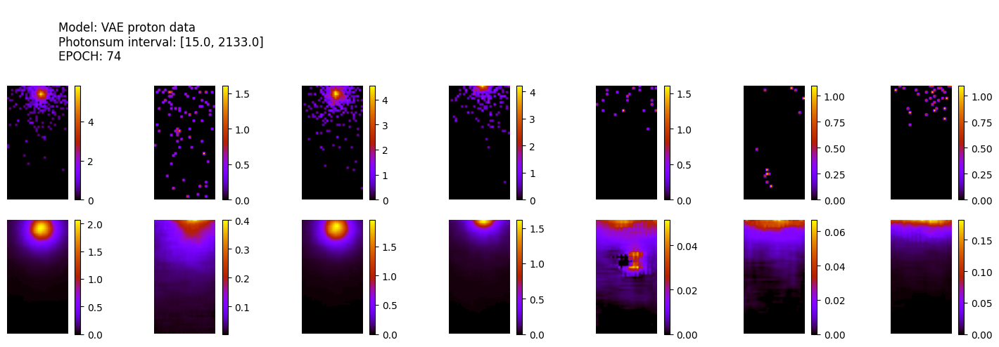

305/305 [==============================] - 1s 4ms/step
ws mean 27.95 ch1 64.20 ch2 5.35 ch3 0.27 ch4 0.01 ch5 69.93 Time for epoch 75 is 27.82035517692566 sec
22900 [Total loss: 94.37] [Recon_loss: 94.33] [KL loss: 0.05]
23000 [Total loss: 100.28] [Recon_loss: 100.16] [KL loss: 0.17]
23100 [Total loss: 75.12] [Recon_loss: 75.11] [KL loss: 0.02]


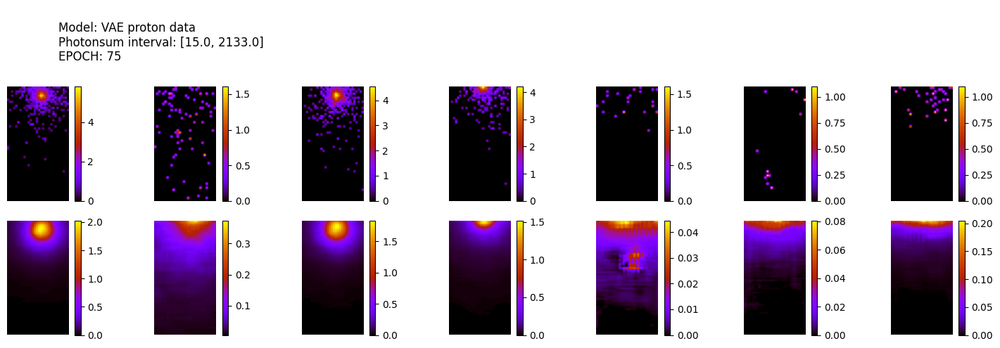

305/305 [==============================] - 1s 4ms/step
ws mean 27.57 ch1 63.35 ch2 5.25 ch3 0.24 ch4 0.01 ch5 69.03 Time for epoch 76 is 27.634020566940308 sec
23200 [Total loss: 104.59] [Recon_loss: 104.50] [KL loss: 0.13]
23300 [Total loss: 94.47] [Recon_loss: 94.45] [KL loss: 0.03]
23400 [Total loss: 99.27] [Recon_loss: 99.17] [KL loss: 0.14]


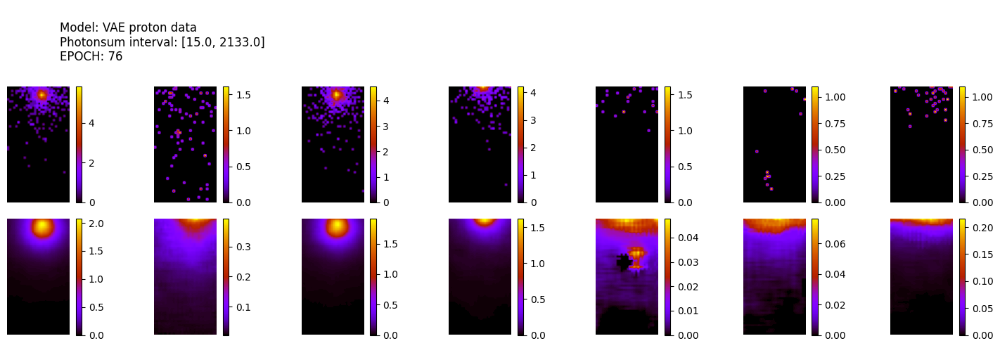

305/305 [==============================] - 1s 4ms/step
ws mean 28.18 ch1 64.91 ch2 5.29 ch3 0.24 ch4 0.01 ch5 70.44 Time for epoch 77 is 27.581226110458374 sec
23500 [Total loss: 96.15] [Recon_loss: 96.12] [KL loss: 0.04]
23600 [Total loss: 89.87] [Recon_loss: 89.87] [KL loss: 0.01]
23700 [Total loss: 81.80] [Recon_loss: 81.68] [KL loss: 0.16]


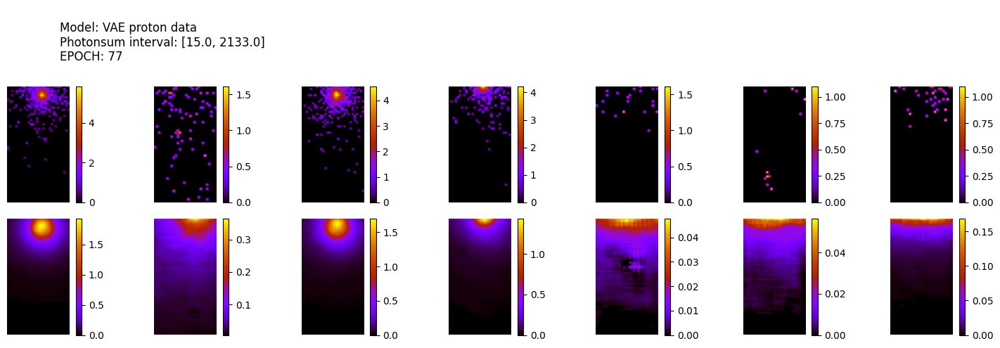

305/305 [==============================] - 1s 4ms/step
ws mean 29.21 ch1 67.32 ch2 5.39 ch3 0.28 ch4 0.01 ch5 73.08 Time for epoch 78 is 27.547481060028076 sec
23800 [Total loss: 86.41] [Recon_loss: 86.34] [KL loss: 0.09]
23900 [Total loss: 75.42] [Recon_loss: 75.40] [KL loss: 0.02]
24000 [Total loss: 98.30] [Recon_loss: 98.25] [KL loss: 0.07]


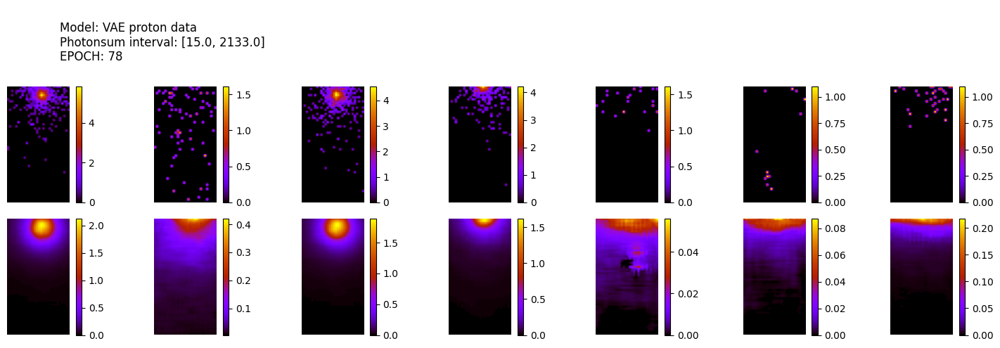

305/305 [==============================] - 1s 4ms/step
ws mean 26.23 ch1 60.42 ch2 4.86 ch3 0.25 ch4 0.01 ch5 65.60 Time for epoch 79 is 27.596757411956787 sec
24100 [Total loss: 90.17] [Recon_loss: 90.11] [KL loss: 0.08]
24200 [Total loss: 92.15] [Recon_loss: 92.12] [KL loss: 0.05]
24300 [Total loss: 83.14] [Recon_loss: 83.11] [KL loss: 0.03]
24400 [Total loss: 83.83] [Recon_loss: 83.80] [KL loss: 0.05]


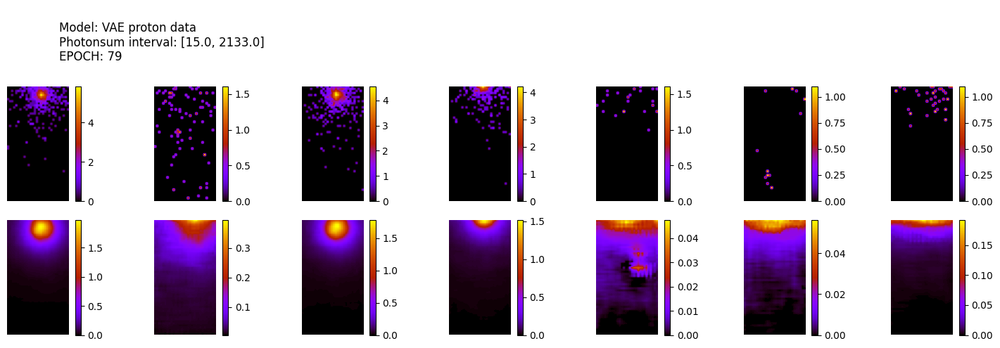

305/305 [==============================] - 1s 4ms/step
ws mean 28.49 ch1 65.72 ch2 5.25 ch3 0.26 ch4 0.01 ch5 71.23 Time for epoch 80 is 27.564733505249023 sec
24500 [Total loss: 98.78] [Recon_loss: 98.57] [KL loss: 0.31]
24600 [Total loss: 94.29] [Recon_loss: 94.22] [KL loss: 0.10]
24700 [Total loss: 87.11] [Recon_loss: 86.91] [KL loss: 0.29]


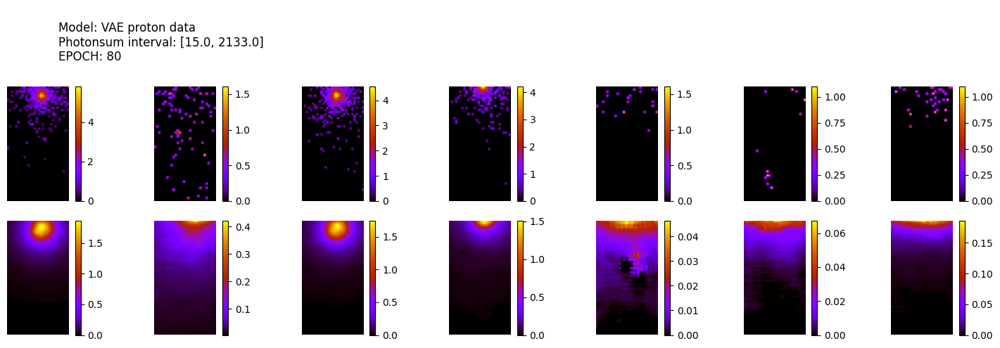

305/305 [==============================] - 1s 4ms/step
ws mean 30.23 ch1 69.59 ch2 5.65 ch3 0.27 ch4 0.01 ch5 75.66 Time for epoch 81 is 27.622025728225708 sec
24800 [Total loss: 96.98] [Recon_loss: 96.93] [KL loss: 0.07]
24900 [Total loss: 84.23] [Recon_loss: 84.16] [KL loss: 0.11]
25000 [Total loss: 99.94] [Recon_loss: 99.80] [KL loss: 0.19]


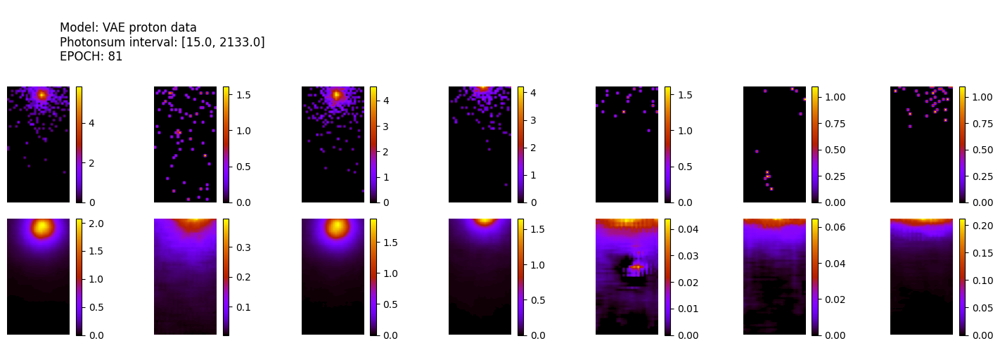

305/305 [==============================] - 1s 4ms/step
ws mean 25.93 ch1 59.76 ch2 4.73 ch3 0.26 ch4 0.01 ch5 64.90 Time for epoch 82 is 27.807560682296753 sec
25100 [Total loss: 99.00] [Recon_loss: 98.89] [KL loss: 0.16]
25200 [Total loss: 94.03] [Recon_loss: 94.01] [KL loss: 0.03]
25300 [Total loss: 93.17] [Recon_loss: 93.03] [KL loss: 0.20]


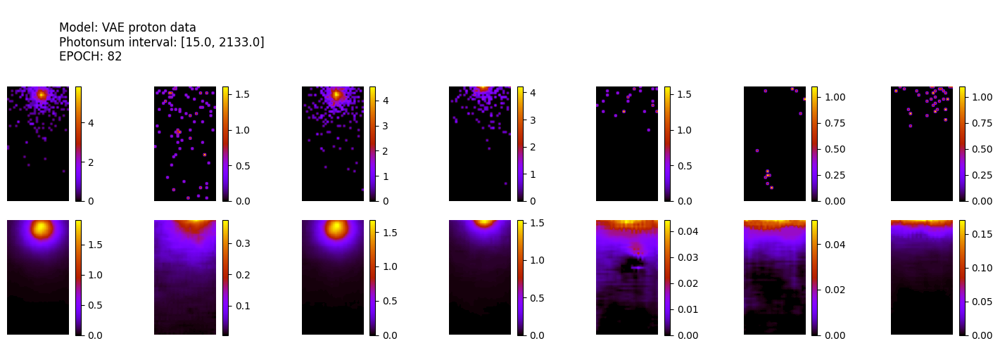

305/305 [==============================] - 1s 4ms/step
ws mean 29.94 ch1 68.83 ch2 5.66 ch3 0.26 ch4 0.01 ch5 74.94 Time for epoch 83 is 27.556389570236206 sec
25400 [Total loss: 104.13] [Recon_loss: 103.75] [KL loss: 0.55]
25500 [Total loss: 100.98] [Recon_loss: 100.92] [KL loss: 0.08]
25600 [Total loss: 101.84] [Recon_loss: 101.80] [KL loss: 0.06]


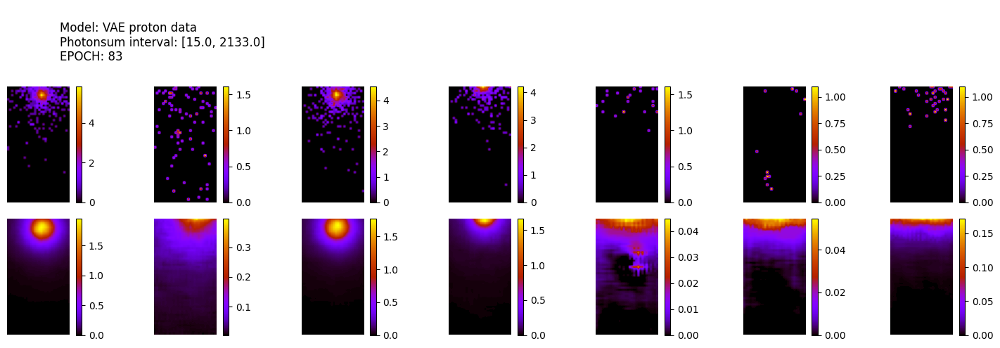

305/305 [==============================] - 1s 4ms/step
ws mean 28.49 ch1 65.44 ch2 5.41 ch3 0.27 ch4 0.01 ch5 71.34 Time for epoch 84 is 27.569967031478882 sec
25700 [Total loss: 95.91] [Recon_loss: 95.87] [KL loss: 0.06]
25800 [Total loss: 100.46] [Recon_loss: 100.39] [KL loss: 0.10]
25900 [Total loss: 100.85] [Recon_loss: 100.82] [KL loss: 0.05]


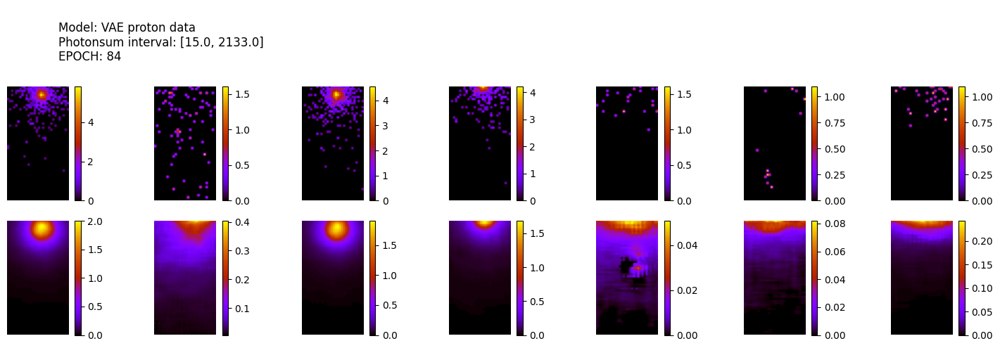

305/305 [==============================] - 1s 4ms/step
ws mean 27.38 ch1 63.18 ch2 4.96 ch3 0.26 ch4 0.01 ch5 68.46 Time for epoch 85 is 27.55898880958557 sec
26000 [Total loss: 100.33] [Recon_loss: 100.28] [KL loss: 0.07]
26100 [Total loss: 100.18] [Recon_loss: 100.12] [KL loss: 0.08]
26200 [Total loss: 98.90] [Recon_loss: 98.86] [KL loss: 0.06]


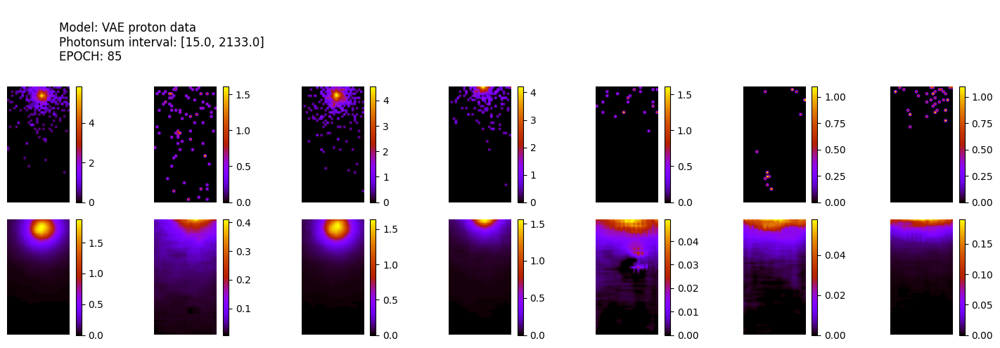

305/305 [==============================] - 1s 4ms/step
ws mean 28.21 ch1 64.75 ch2 5.44 ch3 0.26 ch4 0.01 ch5 70.58 Time for epoch 86 is 27.55366563796997 sec
26300 [Total loss: 107.05] [Recon_loss: 106.86] [KL loss: 0.27]
26400 [Total loss: 98.23] [Recon_loss: 98.01] [KL loss: 0.32]
26500 [Total loss: 85.68] [Recon_loss: 85.64] [KL loss: 0.06]


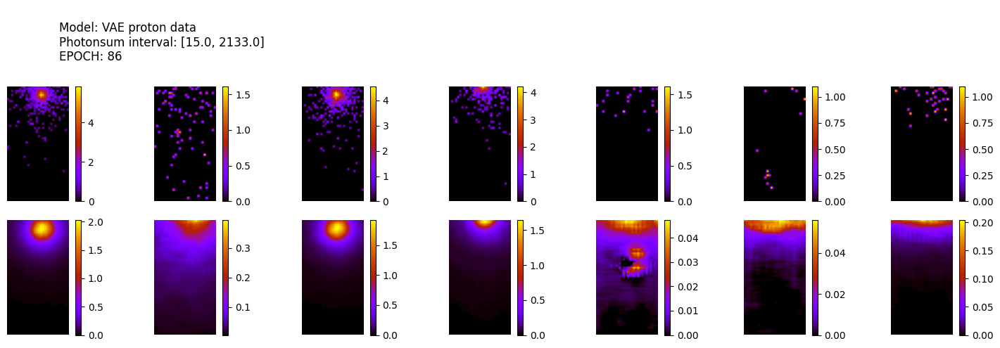

305/305 [==============================] - 1s 4ms/step
ws mean 28.22 ch1 65.35 ch2 4.87 ch3 0.26 ch4 0.01 ch5 70.63 Time for epoch 87 is 27.55588960647583 sec
26600 [Total loss: 73.68] [Recon_loss: 73.67] [KL loss: 0.02]
26700 [Total loss: 94.90] [Recon_loss: 94.84] [KL loss: 0.07]
26800 [Total loss: 75.98] [Recon_loss: 75.95] [KL loss: 0.04]


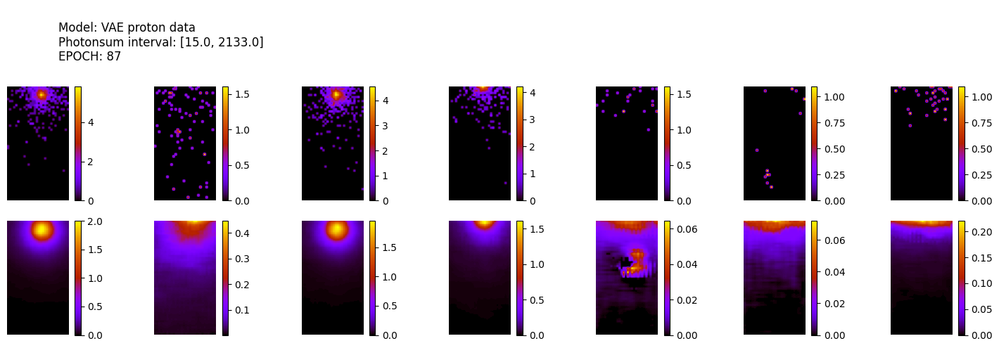

305/305 [==============================] - 1s 4ms/step
ws mean 26.94 ch1 62.50 ch2 4.56 ch3 0.24 ch4 0.01 ch5 67.41 Time for epoch 88 is 27.60575580596924 sec
26900 [Total loss: 99.44] [Recon_loss: 99.15] [KL loss: 0.41]
27000 [Total loss: 96.49] [Recon_loss: 96.41] [KL loss: 0.12]
27100 [Total loss: 92.11] [Recon_loss: 92.00] [KL loss: 0.17]


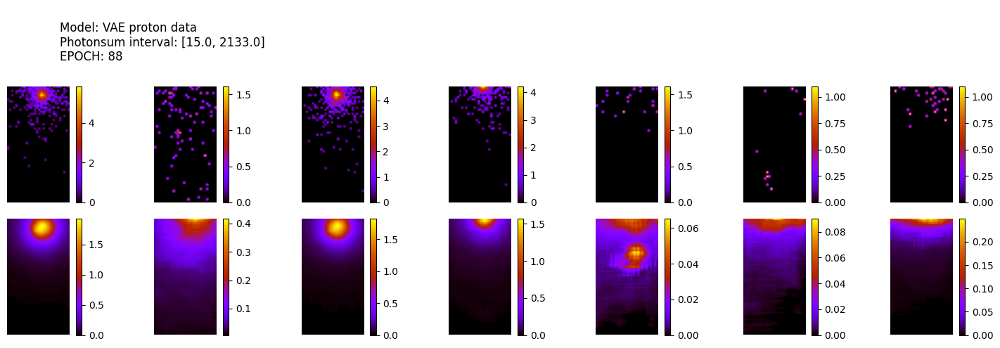

305/305 [==============================] - 1s 4ms/step
ws mean 27.77 ch1 64.71 ch2 4.52 ch3 0.25 ch4 0.01 ch5 69.36 Time for epoch 89 is 27.879006147384644 sec
27200 [Total loss: 66.45] [Recon_loss: 66.42] [KL loss: 0.04]
27300 [Total loss: 95.04] [Recon_loss: 94.92] [KL loss: 0.18]
27400 [Total loss: 91.54] [Recon_loss: 91.37] [KL loss: 0.25]


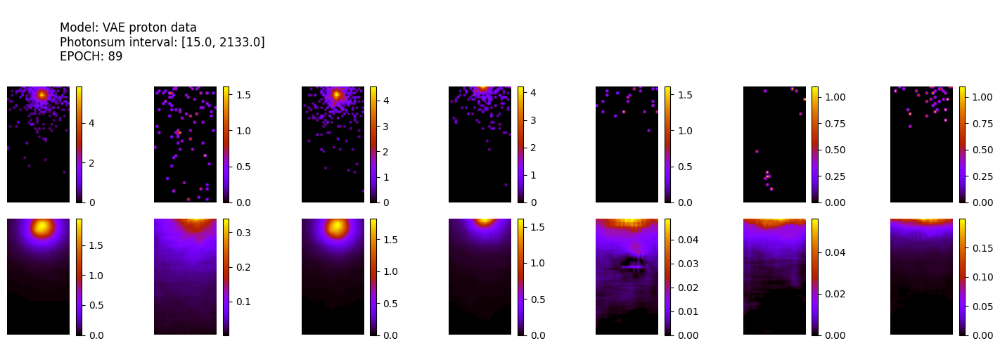

305/305 [==============================] - 1s 4ms/step
ws mean 29.71 ch1 68.27 ch2 5.67 ch3 0.27 ch4 0.01 ch5 74.34 Time for epoch 90 is 27.60224151611328 sec
27500 [Total loss: 76.77] [Recon_loss: 76.76] [KL loss: 0.01]
27600 [Total loss: 76.52] [Recon_loss: 76.50] [KL loss: 0.03]
27700 [Total loss: 102.29] [Recon_loss: 102.23] [KL loss: 0.08]


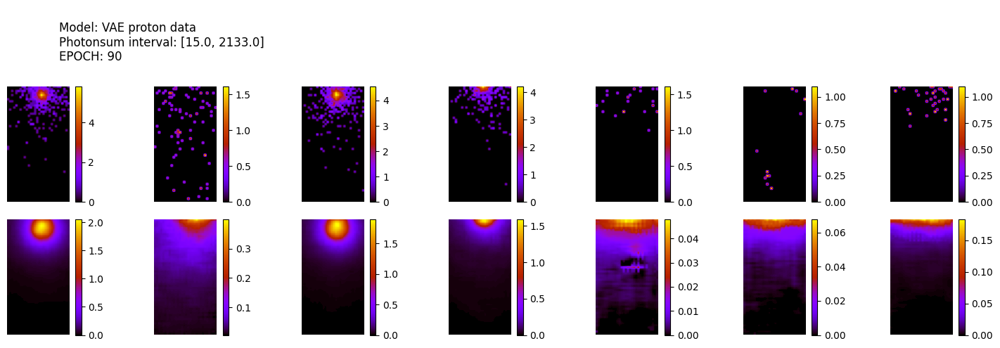

305/305 [==============================] - 1s 4ms/step
ws mean 27.40 ch1 63.24 ch2 4.96 ch3 0.24 ch4 0.01 ch5 68.54 Time for epoch 91 is 27.59933876991272 sec
27800 [Total loss: 105.14] [Recon_loss: 105.00] [KL loss: 0.19]
27900 [Total loss: 94.07] [Recon_loss: 94.03] [KL loss: 0.06]
28000 [Total loss: 101.95] [Recon_loss: 101.91] [KL loss: 0.07]


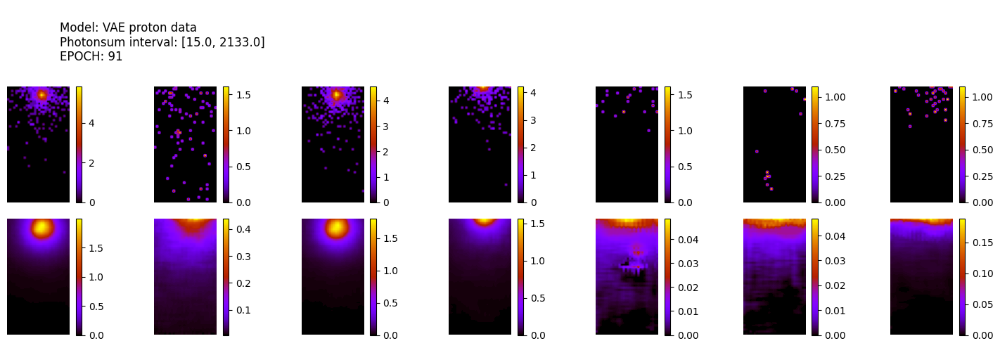

305/305 [==============================] - 1s 4ms/step
ws mean 27.10 ch1 62.88 ch2 4.56 ch3 0.26 ch4 0.01 ch5 67.78 Time for epoch 92 is 27.57761287689209 sec
28100 [Total loss: 108.75] [Recon_loss: 108.60] [KL loss: 0.22]
28200 [Total loss: 78.17] [Recon_loss: 78.15] [KL loss: 0.02]
28300 [Total loss: 83.00] [Recon_loss: 82.91] [KL loss: 0.14]


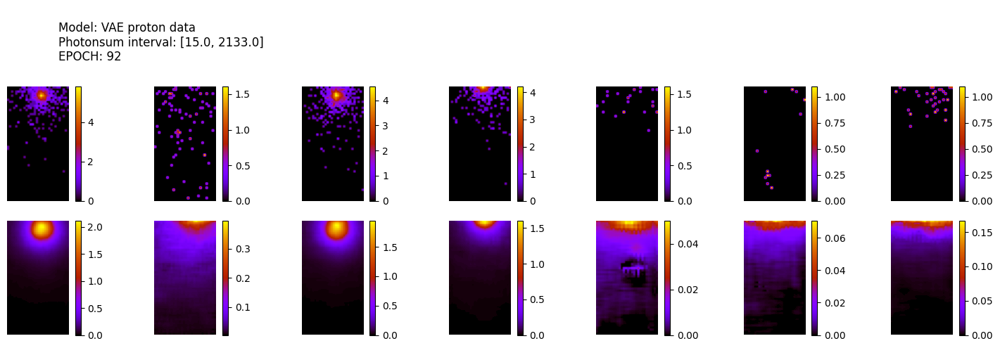

305/305 [==============================] - 1s 4ms/step
ws mean 27.88 ch1 64.04 ch2 5.40 ch3 0.25 ch4 0.01 ch5 69.70 Time for epoch 93 is 27.547306060791016 sec
28400 [Total loss: 75.14] [Recon_loss: 75.14] [KL loss: 0.01]
28500 [Total loss: 99.06] [Recon_loss: 99.04] [KL loss: 0.04]
28600 [Total loss: 97.66] [Recon_loss: 97.61] [KL loss: 0.08]


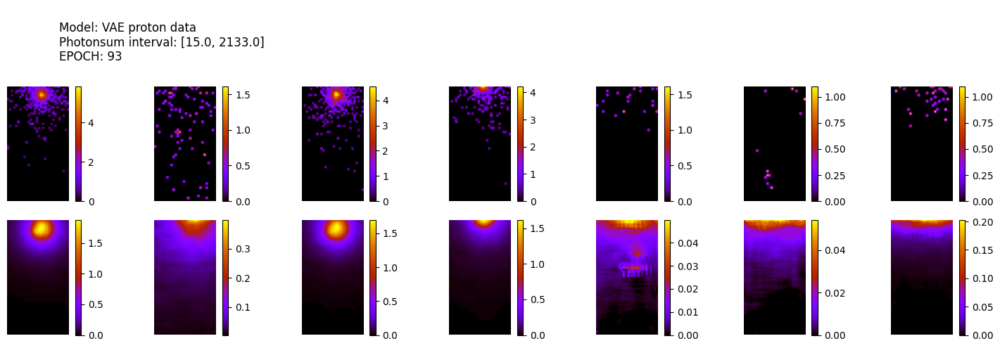

305/305 [==============================] - 1s 4ms/step
ws mean 29.21 ch1 67.30 ch2 5.39 ch3 0.26 ch4 0.01 ch5 73.07 Time for epoch 94 is 27.84706735610962 sec
28700 [Total loss: 95.38] [Recon_loss: 95.19] [KL loss: 0.27]
28800 [Total loss: 87.39] [Recon_loss: 87.35] [KL loss: 0.05]
28900 [Total loss: 102.88] [Recon_loss: 102.70] [KL loss: 0.26]


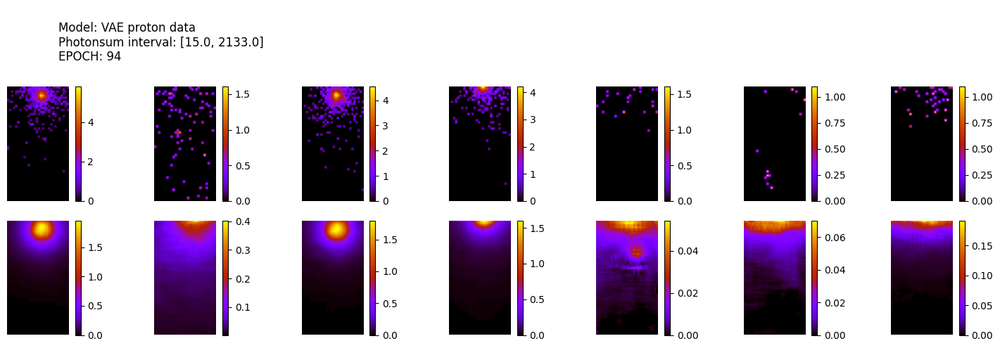

305/305 [==============================] - 1s 4ms/step
ws mean 28.47 ch1 65.71 ch2 5.17 ch3 0.25 ch4 0.01 ch5 71.23 Time for epoch 95 is 27.60025143623352 sec
29000 [Total loss: 93.72] [Recon_loss: 93.65] [KL loss: 0.11]
29100 [Total loss: 97.25] [Recon_loss: 97.18] [KL loss: 0.10]
29200 [Total loss: 93.01] [Recon_loss: 92.96] [KL loss: 0.08]


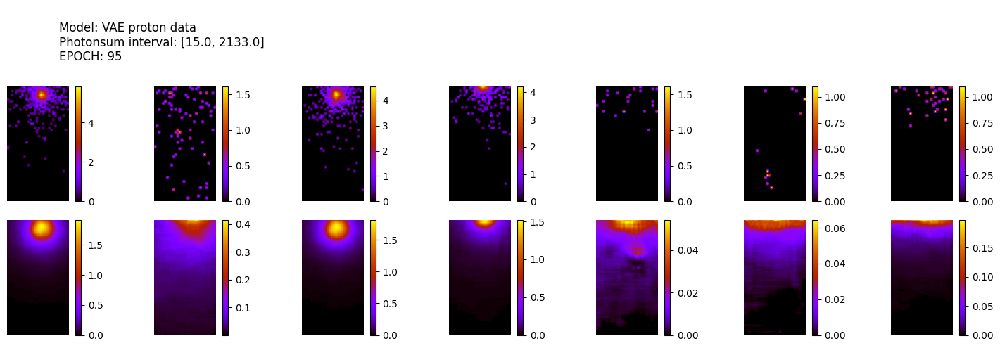

305/305 [==============================] - 1s 4ms/step
ws mean 28.59 ch1 66.01 ch2 5.17 ch3 0.27 ch4 0.01 ch5 71.51 Time for epoch 96 is 27.499624252319336 sec
29300 [Total loss: 94.39] [Recon_loss: 94.29] [KL loss: 0.14]
29400 [Total loss: 92.37] [Recon_loss: 92.31] [KL loss: 0.10]
29500 [Total loss: 105.14] [Recon_loss: 104.98] [KL loss: 0.23]


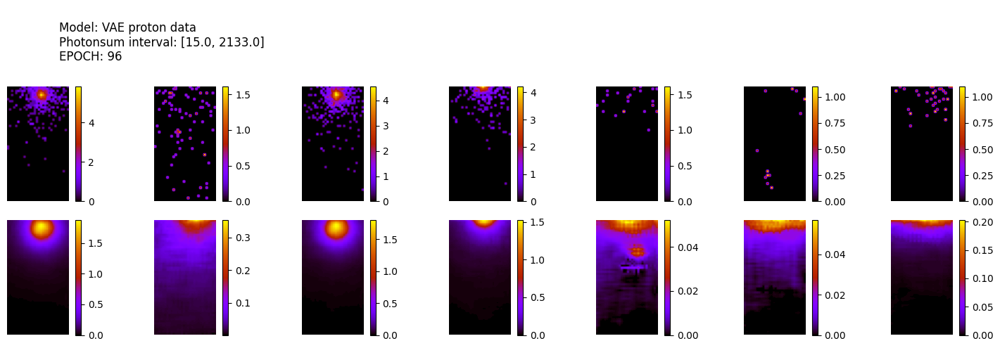

305/305 [==============================] - 1s 4ms/step
ws mean 30.04 ch1 69.01 ch2 5.76 ch3 0.26 ch4 0.01 ch5 75.16 Time for epoch 97 is 27.549583435058594 sec
29600 [Total loss: 98.43] [Recon_loss: 98.41] [KL loss: 0.03]
29700 [Total loss: 82.25] [Recon_loss: 82.19] [KL loss: 0.08]
29800 [Total loss: 92.99] [Recon_loss: 92.93] [KL loss: 0.09]


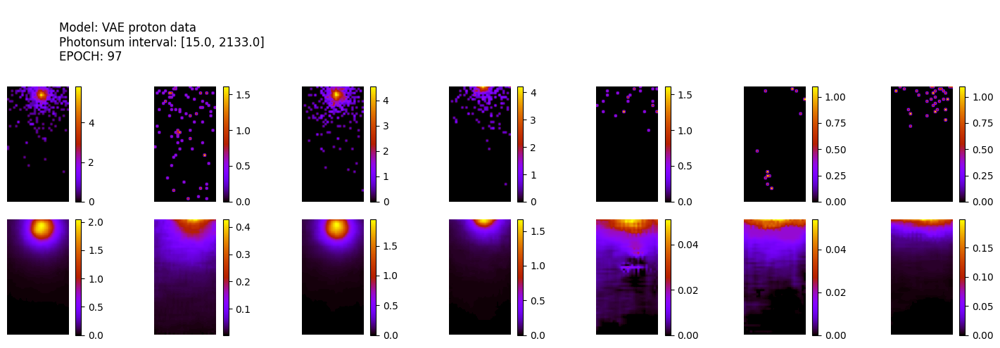

305/305 [==============================] - 1s 4ms/step
ws mean 27.34 ch1 63.09 ch2 5.01 ch3 0.24 ch4 0.01 ch5 68.37 Time for epoch 98 is 27.849010944366455 sec
29900 [Total loss: 88.94] [Recon_loss: 88.92] [KL loss: 0.02]
30000 [Total loss: 75.00] [Recon_loss: 74.98] [KL loss: 0.02]
30100 [Total loss: 93.14] [Recon_loss: 93.12] [KL loss: 0.03]


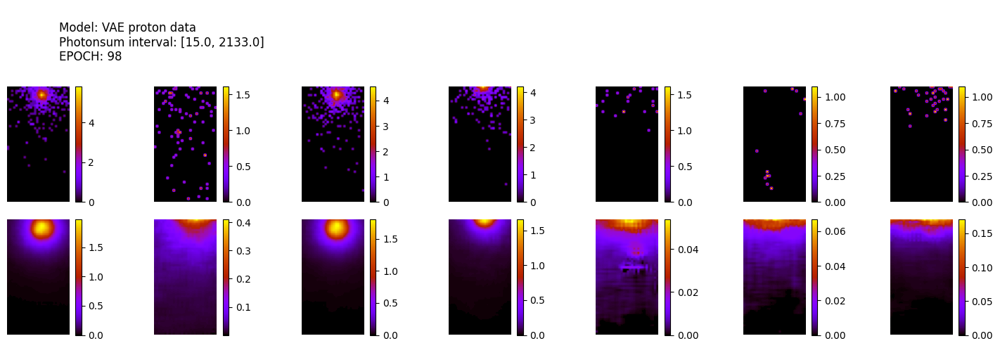

305/305 [==============================] - 1s 4ms/step
ws mean 28.70 ch1 66.06 ch2 5.41 ch3 0.26 ch4 0.01 ch5 71.74 Time for epoch 99 is 27.525795459747314 sec
30200 [Total loss: 87.88] [Recon_loss: 87.78] [KL loss: 0.14]
30300 [Total loss: 91.71] [Recon_loss: 91.66] [KL loss: 0.07]
30400 [Total loss: 105.85] [Recon_loss: 105.82] [KL loss: 0.04]
30500 [Total loss: 74.14] [Recon_loss: 74.14] [KL loss: 0.01]


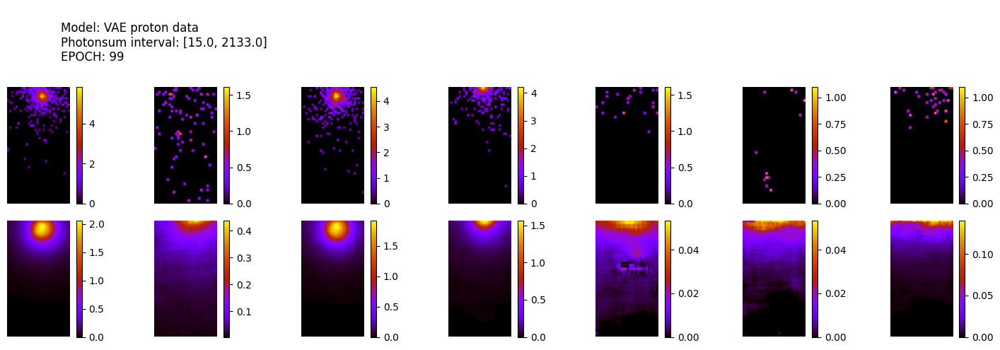

305/305 [==============================] - 1s 4ms/step
ws mean 26.58 ch1 61.03 ch2 5.10 ch3 0.25 ch4 0.01 ch5 66.51 Time for epoch 100 is 27.572198390960693 sec
30600 [Total loss: 89.55] [Recon_loss: 89.45] [KL loss: 0.14]
30700 [Total loss: 90.81] [Recon_loss: 90.72] [KL loss: 0.12]
30800 [Total loss: 94.55] [Recon_loss: 94.51] [KL loss: 0.07]


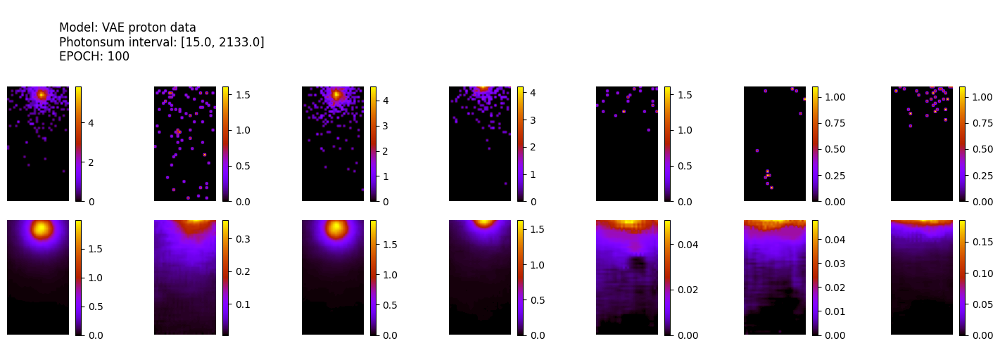

305/305 [==============================] - 1s 4ms/step
ws mean 28.79 ch1 66.42 ch2 5.30 ch3 0.27 ch4 0.01 ch5 71.96 Time for epoch 101 is 27.497671365737915 sec
30900 [Total loss: 104.10] [Recon_loss: 103.67] [KL loss: 0.62]
31000 [Total loss: 93.04] [Recon_loss: 92.99] [KL loss: 0.08]
31100 [Total loss: 94.20] [Recon_loss: 94.14] [KL loss: 0.10]


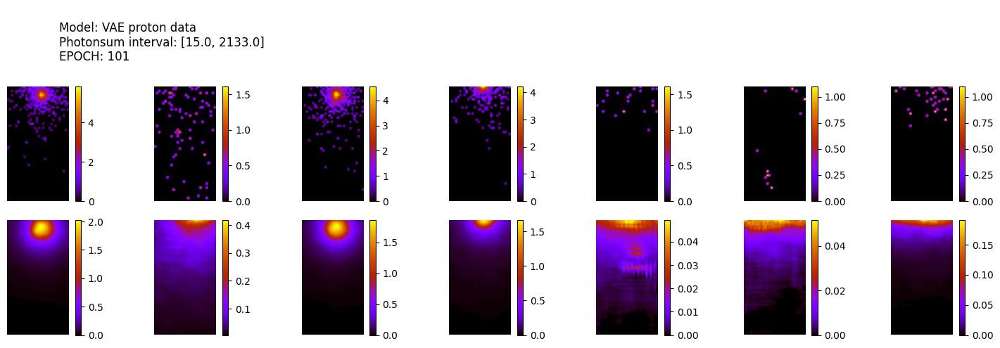

305/305 [==============================] - 1s 4ms/step
ws mean 27.93 ch1 64.34 ch2 5.15 ch3 0.26 ch4 0.01 ch5 69.88 Time for epoch 102 is 27.79131007194519 sec
31200 [Total loss: 93.21] [Recon_loss: 93.18] [KL loss: 0.04]
31300 [Total loss: 65.01] [Recon_loss: 65.01] [KL loss: 0.01]
31400 [Total loss: 80.88] [Recon_loss: 80.85] [KL loss: 0.04]


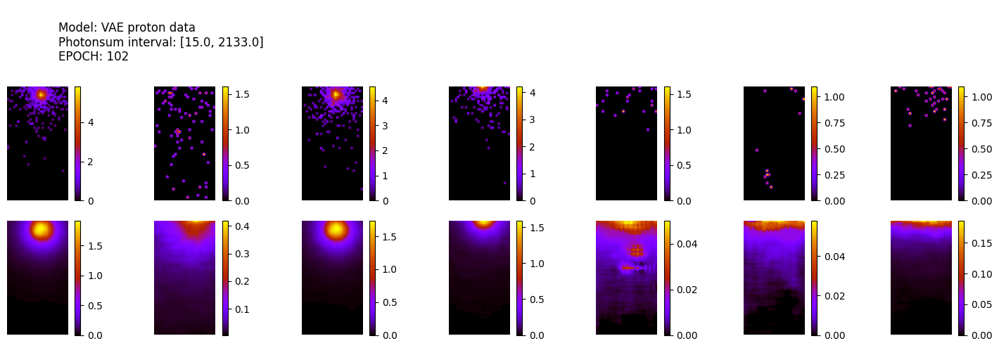

305/305 [==============================] - 1s 4ms/step
ws mean 29.45 ch1 68.02 ch2 5.33 ch3 0.27 ch4 0.01 ch5 73.63 Time for epoch 103 is 27.46564292907715 sec
31500 [Total loss: 95.99] [Recon_loss: 95.72] [KL loss: 0.37]
31600 [Total loss: 109.63] [Recon_loss: 109.60] [KL loss: 0.04]
31700 [Total loss: 96.04] [Recon_loss: 96.01] [KL loss: 0.04]


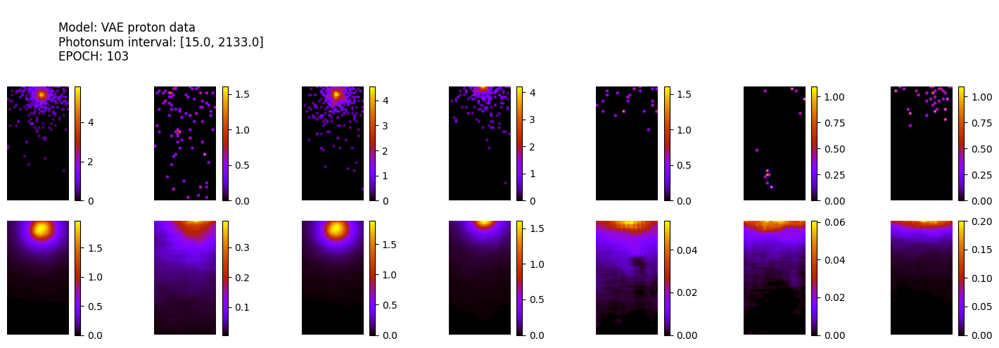

305/305 [==============================] - 1s 4ms/step
ws mean 28.41 ch1 65.47 ch2 5.22 ch3 0.26 ch4 0.01 ch5 71.11 Time for epoch 104 is 27.475492477416992 sec
31800 [Total loss: 90.78] [Recon_loss: 90.77] [KL loss: 0.02]
31900 [Total loss: 110.52] [Recon_loss: 110.49] [KL loss: 0.05]
32000 [Total loss: 98.25] [Recon_loss: 98.15] [KL loss: 0.14]


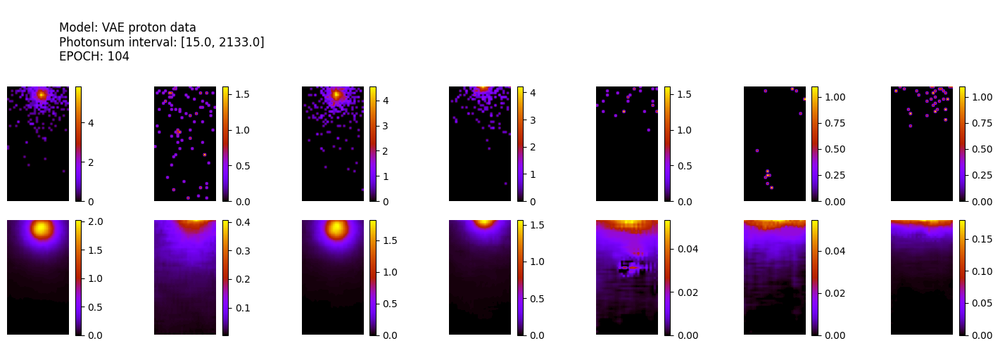

305/305 [==============================] - 1s 4ms/step
ws mean 27.89 ch1 63.89 ch2 5.49 ch3 0.25 ch4 0.01 ch5 69.82 Time for epoch 105 is 27.86156964302063 sec
32100 [Total loss: 101.62] [Recon_loss: 101.58] [KL loss: 0.05]
32200 [Total loss: 91.78] [Recon_loss: 91.76] [KL loss: 0.02]
32300 [Total loss: 91.02] [Recon_loss: 90.98] [KL loss: 0.06]


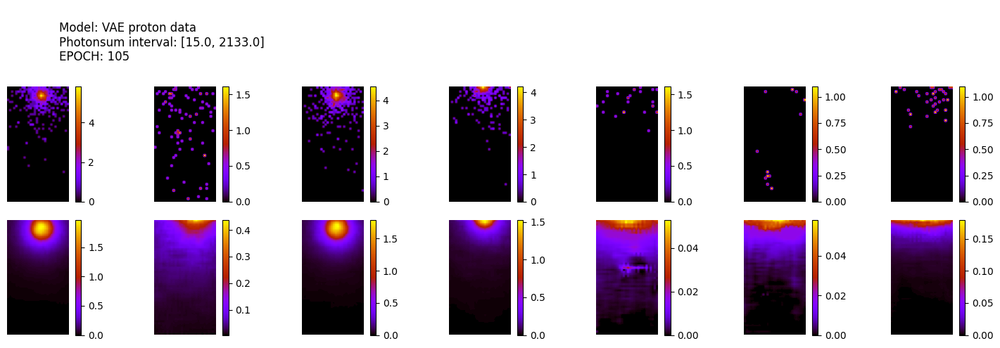

305/305 [==============================] - 1s 4ms/step
ws mean 28.52 ch1 65.82 ch2 5.17 ch3 0.25 ch4 0.01 ch5 71.37 Time for epoch 106 is 27.573110342025757 sec
32400 [Total loss: 97.92] [Recon_loss: 97.66] [KL loss: 0.36]
32500 [Total loss: 82.36] [Recon_loss: 82.19] [KL loss: 0.25]
32600 [Total loss: 98.34] [Recon_loss: 98.24] [KL loss: 0.14]


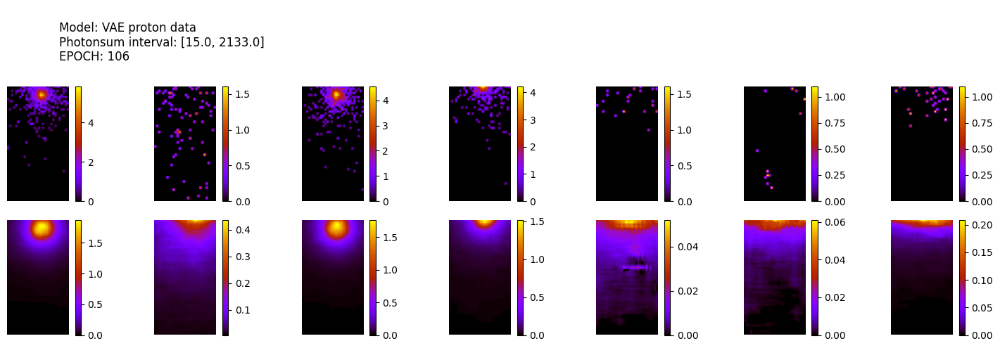

305/305 [==============================] - 1s 4ms/step
ws mean 29.36 ch1 67.84 ch2 5.25 ch3 0.27 ch4 0.01 ch5 73.44 Time for epoch 107 is 27.50611448287964 sec
32700 [Total loss: 106.98] [Recon_loss: 106.89] [KL loss: 0.14]
32800 [Total loss: 97.77] [Recon_loss: 97.64] [KL loss: 0.18]
32900 [Total loss: 99.17] [Recon_loss: 99.05] [KL loss: 0.17]


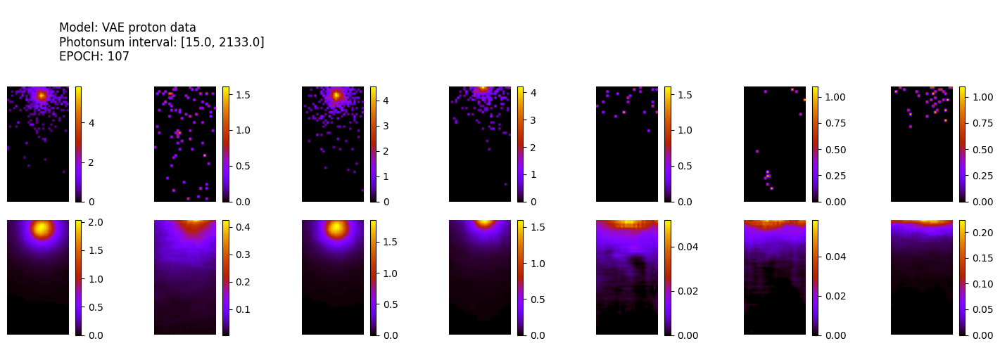

305/305 [==============================] - 1s 4ms/step
ws mean 28.48 ch1 65.44 ch2 5.38 ch3 0.25 ch4 0.01 ch5 71.32 Time for epoch 108 is 27.58950710296631 sec
33000 [Total loss: 93.73] [Recon_loss: 93.66] [KL loss: 0.10]
33100 [Total loss: 102.17] [Recon_loss: 102.15] [KL loss: 0.04]
33200 [Total loss: 89.59] [Recon_loss: 89.56] [KL loss: 0.04]


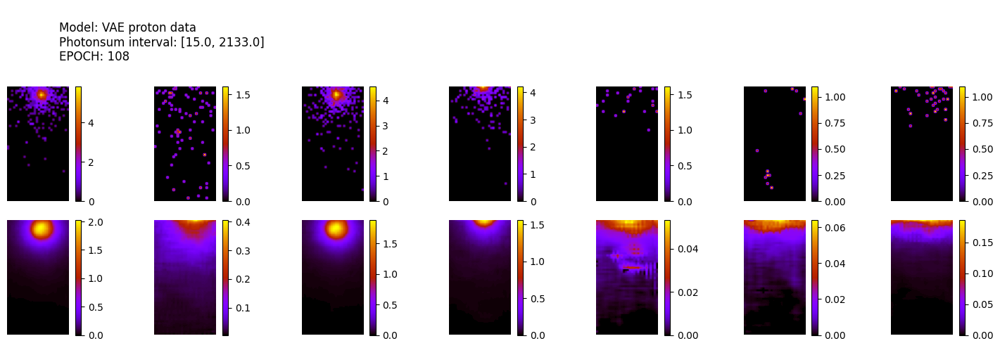

305/305 [==============================] - 1s 4ms/step
ws mean 27.74 ch1 63.78 ch2 5.27 ch3 0.26 ch4 0.01 ch5 69.40 Time for epoch 109 is 27.833386659622192 sec
33300 [Total loss: 94.01] [Recon_loss: 93.89] [KL loss: 0.17]
33400 [Total loss: 91.27] [Recon_loss: 91.23] [KL loss: 0.05]
33500 [Total loss: 106.57] [Recon_loss: 106.49] [KL loss: 0.11]


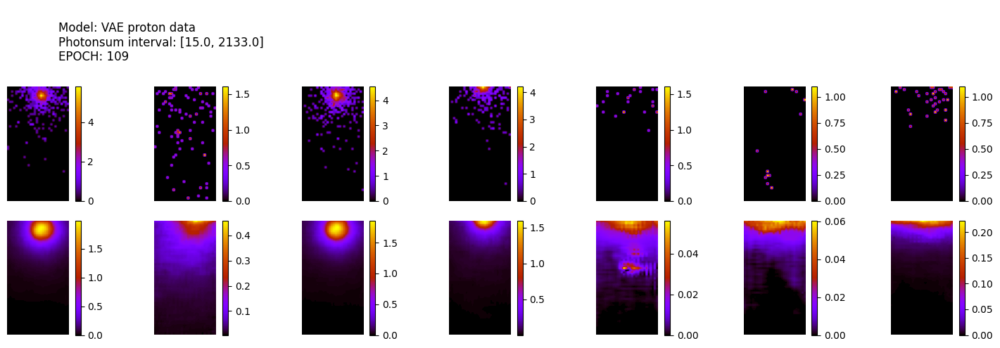

305/305 [==============================] - 1s 4ms/step
ws mean 27.78 ch1 64.17 ch2 4.94 ch3 0.25 ch4 0.01 ch5 69.55 Time for epoch 110 is 27.67517852783203 sec
33600 [Total loss: 81.99] [Recon_loss: 81.92] [KL loss: 0.10]
33700 [Total loss: 78.56] [Recon_loss: 78.55] [KL loss: 0.03]
33800 [Total loss: 91.72] [Recon_loss: 91.71] [KL loss: 0.02]


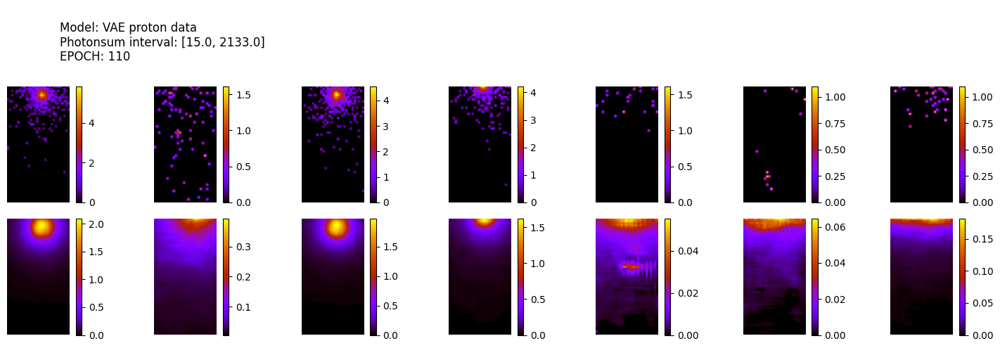

305/305 [==============================] - 1s 4ms/step
ws mean 26.32 ch1 60.77 ch2 4.80 ch3 0.24 ch4 0.01 ch5 65.79 Time for epoch 111 is 27.552677631378174 sec
33900 [Total loss: 96.87] [Recon_loss: 96.77] [KL loss: 0.14]
34000 [Total loss: 86.26] [Recon_loss: 86.22] [KL loss: 0.05]
34100 [Total loss: 89.72] [Recon_loss: 89.64] [KL loss: 0.11]


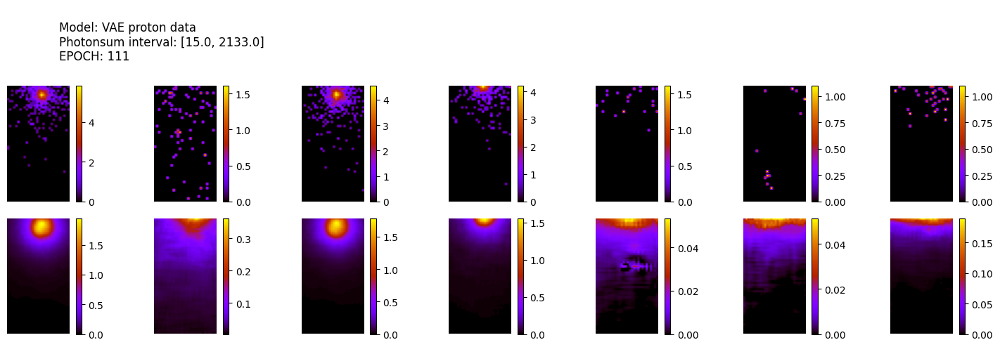

305/305 [==============================] - 1s 4ms/step
ws mean 29.36 ch1 67.26 ch2 5.76 ch3 0.26 ch4 0.01 ch5 73.49 Time for epoch 112 is 27.8343608379364 sec
34200 [Total loss: 94.77] [Recon_loss: 94.70] [KL loss: 0.09]
34300 [Total loss: 104.12] [Recon_loss: 104.04] [KL loss: 0.11]
34400 [Total loss: 101.28] [Recon_loss: 101.10] [KL loss: 0.25]


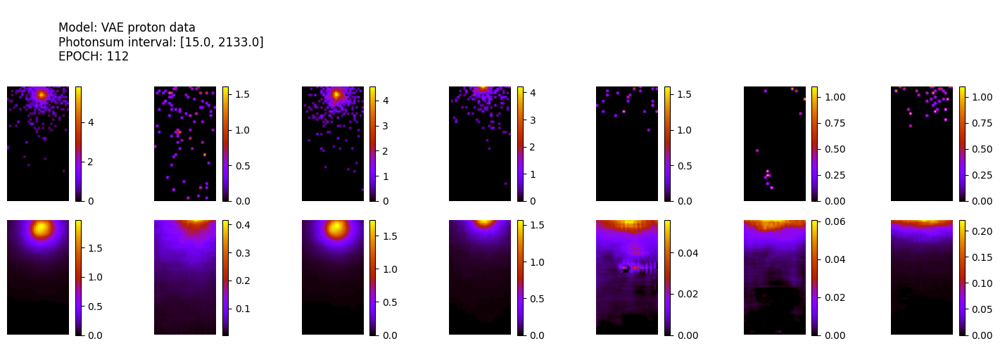

305/305 [==============================] - 1s 4ms/step
ws mean 28.62 ch1 66.01 ch2 5.26 ch3 0.25 ch4 0.01 ch5 71.57 Time for epoch 113 is 27.6073100566864 sec
34500 [Total loss: 85.58] [Recon_loss: 85.51] [KL loss: 0.11]
34600 [Total loss: 93.13] [Recon_loss: 93.10] [KL loss: 0.04]
34700 [Total loss: 86.84] [Recon_loss: 86.71] [KL loss: 0.18]


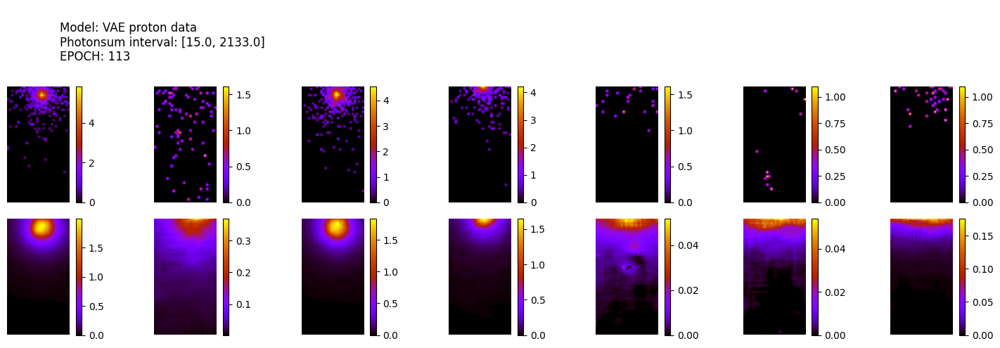

305/305 [==============================] - 1s 4ms/step
ws mean 28.67 ch1 65.95 ch2 5.33 ch3 0.26 ch4 0.01 ch5 71.78 Time for epoch 114 is 27.58086109161377 sec
34800 [Total loss: 91.71] [Recon_loss: 91.67] [KL loss: 0.06]
34900 [Total loss: 100.96] [Recon_loss: 100.90] [KL loss: 0.09]
35000 [Total loss: 100.14] [Recon_loss: 99.95] [KL loss: 0.28]


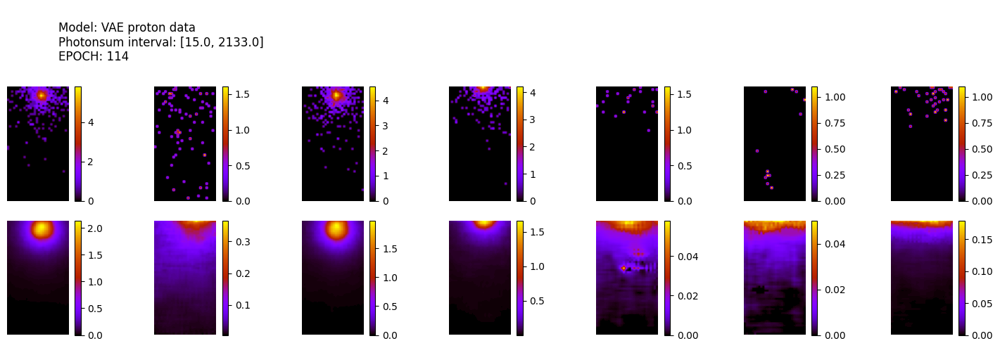

305/305 [==============================] - 1s 4ms/step
ws mean 27.00 ch1 62.21 ch2 5.04 ch3 0.25 ch4 0.01 ch5 67.48 Time for epoch 115 is 27.85567545890808 sec
35100 [Total loss: 101.74] [Recon_loss: 101.57] [KL loss: 0.25]
35200 [Total loss: 83.86] [Recon_loss: 83.74] [KL loss: 0.17]
35300 [Total loss: 65.95] [Recon_loss: 65.92] [KL loss: 0.04]


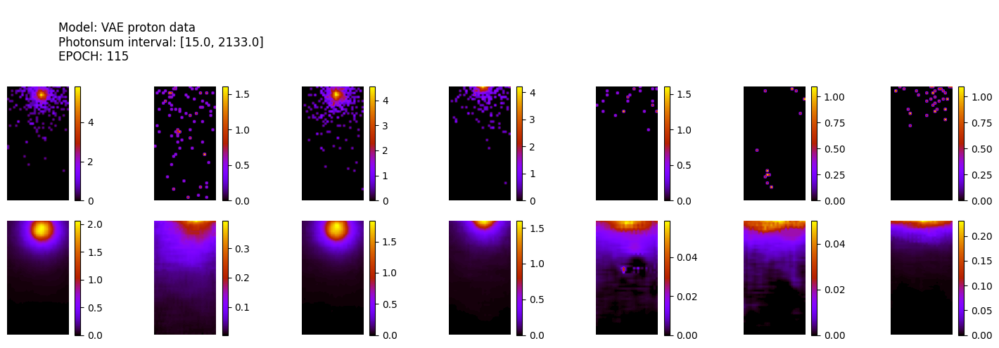

305/305 [==============================] - 1s 4ms/step
ws mean 27.20 ch1 62.88 ch2 4.78 ch3 0.25 ch4 0.01 ch5 68.09 Time for epoch 116 is 27.666141271591187 sec
35400 [Total loss: 84.45] [Recon_loss: 84.28] [KL loss: 0.25]
35500 [Total loss: 97.58] [Recon_loss: 97.50] [KL loss: 0.11]
35600 [Total loss: 84.84] [Recon_loss: 84.83] [KL loss: 0.01]


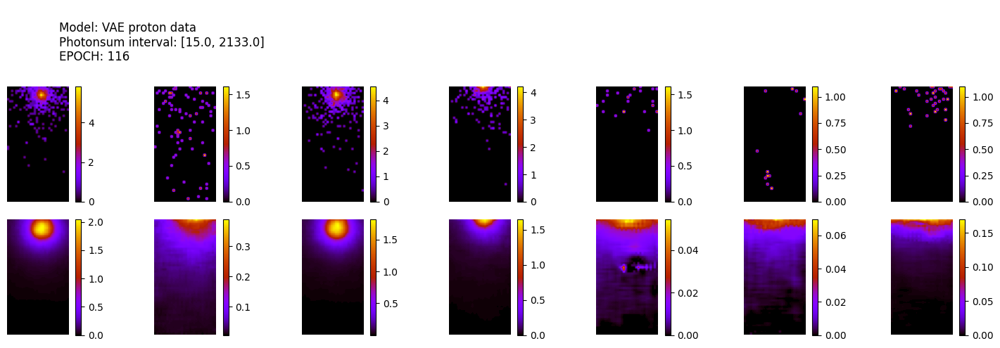

305/305 [==============================] - 1s 4ms/step
ws mean 27.88 ch1 64.10 ch2 5.33 ch3 0.24 ch4 0.01 ch5 69.69 Time for epoch 117 is 27.57567811012268 sec
35700 [Total loss: 97.60] [Recon_loss: 97.55] [KL loss: 0.06]
35800 [Total loss: 94.16] [Recon_loss: 94.10] [KL loss: 0.09]
35900 [Total loss: 75.56] [Recon_loss: 75.52] [KL loss: 0.05]


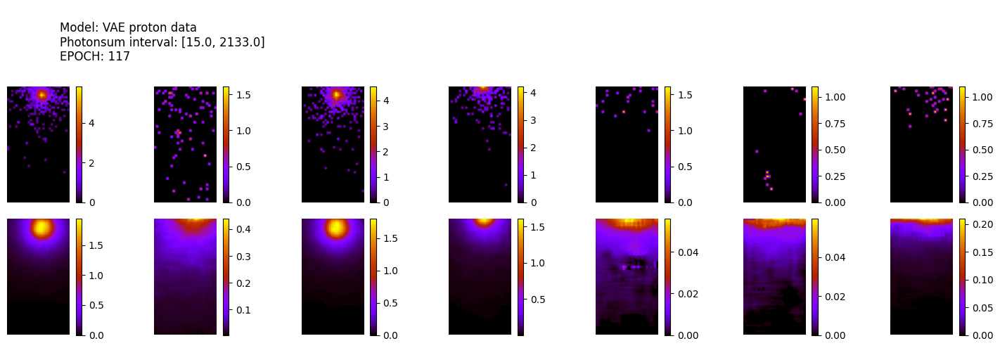

305/305 [==============================] - 1s 4ms/step
ws mean 27.78 ch1 64.61 ch2 4.58 ch3 0.27 ch4 0.01 ch5 69.44 Time for epoch 118 is 27.90433621406555 sec
36000 [Total loss: 85.21] [Recon_loss: 85.19] [KL loss: 0.04]
36100 [Total loss: 90.35] [Recon_loss: 90.34] [KL loss: 0.02]
36200 [Total loss: 105.33] [Recon_loss: 105.22] [KL loss: 0.16]


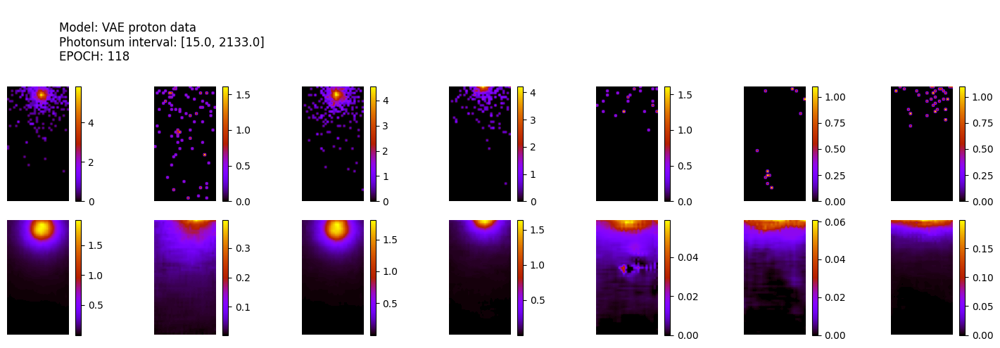

305/305 [==============================] - 1s 4ms/step
ws mean 28.19 ch1 64.81 ch2 5.34 ch3 0.26 ch4 0.01 ch5 70.53 Time for epoch 119 is 27.585081100463867 sec
36300 [Total loss: 109.44] [Recon_loss: 109.39] [KL loss: 0.07]
36400 [Total loss: 90.05] [Recon_loss: 90.03] [KL loss: 0.03]
36500 [Total loss: 90.20] [Recon_loss: 90.06] [KL loss: 0.20]
36600 [Total loss: 96.82] [Recon_loss: 96.74] [KL loss: 0.11]


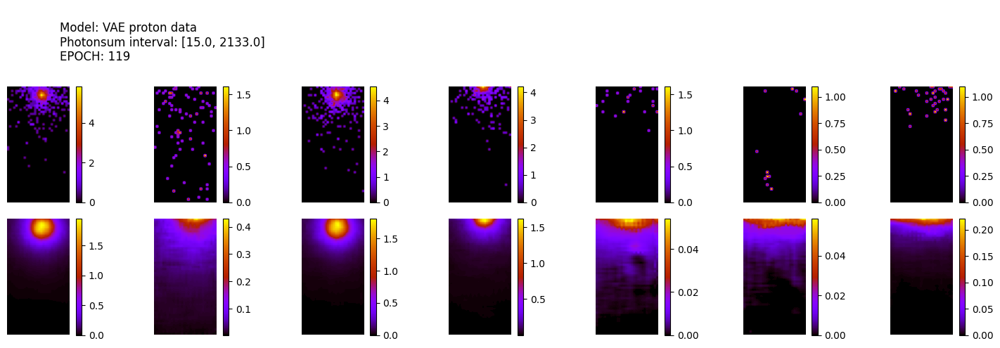

305/305 [==============================] - 1s 4ms/step
ws mean 28.88 ch1 66.26 ch2 5.57 ch3 0.26 ch4 0.01 ch5 72.28 Time for epoch 120 is 27.65684700012207 sec
36700 [Total loss: 96.89] [Recon_loss: 96.82] [KL loss: 0.10]
36800 [Total loss: 67.53] [Recon_loss: 67.35] [KL loss: 0.26]
36900 [Total loss: 97.44] [Recon_loss: 97.41] [KL loss: 0.05]


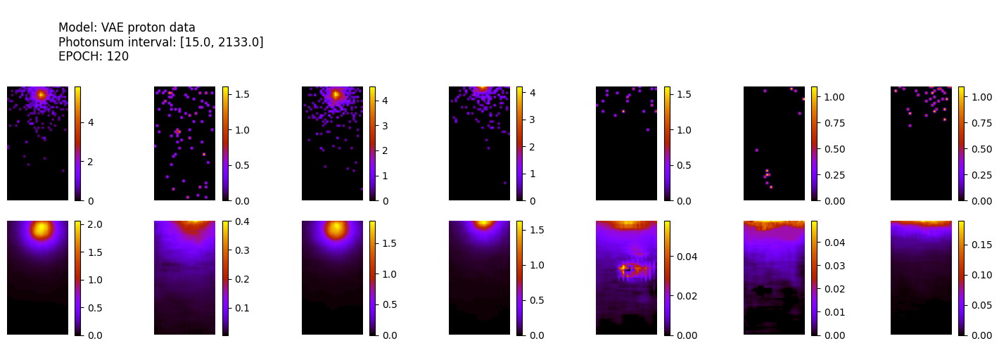

305/305 [==============================] - 1s 4ms/step
ws mean 27.96 ch1 64.65 ch2 5.02 ch3 0.25 ch4 0.01 ch5 69.89 Time for epoch 121 is 27.939959287643433 sec
37000 [Total loss: 95.29] [Recon_loss: 95.23] [KL loss: 0.09]
37100 [Total loss: 96.59] [Recon_loss: 96.51] [KL loss: 0.11]
37200 [Total loss: 84.38] [Recon_loss: 84.28] [KL loss: 0.14]


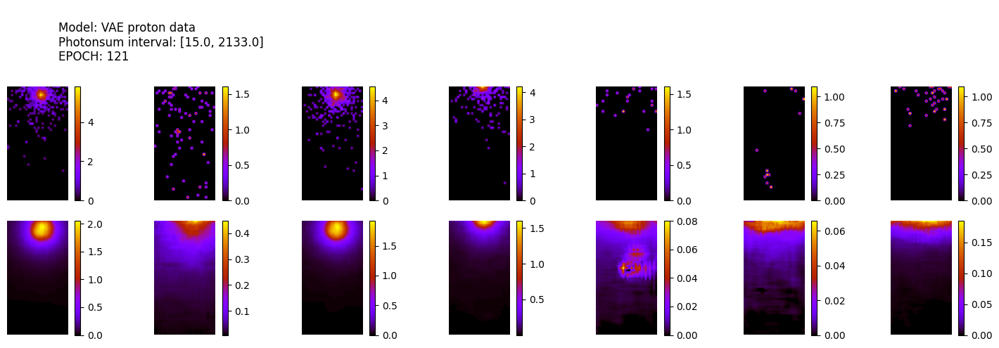

305/305 [==============================] - 1s 4ms/step
ws mean 28.33 ch1 65.58 ch2 4.99 ch3 0.25 ch4 0.01 ch5 70.82 Time for epoch 122 is 27.693331003189087 sec
37300 [Total loss: 97.47] [Recon_loss: 97.37] [KL loss: 0.15]
37400 [Total loss: 85.33] [Recon_loss: 85.19] [KL loss: 0.20]
37500 [Total loss: 83.79] [Recon_loss: 83.72] [KL loss: 0.10]


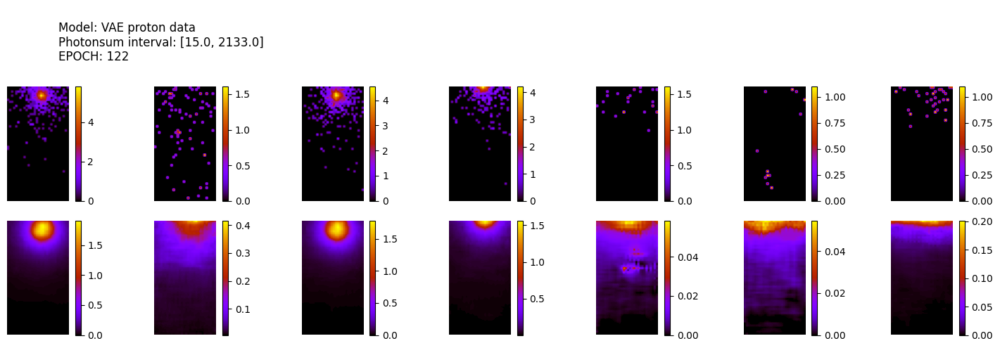

305/305 [==============================] - 1s 4ms/step
ws mean 27.76 ch1 64.52 ch2 4.68 ch3 0.24 ch4 0.01 ch5 69.35 Time for epoch 123 is 27.577687978744507 sec
37600 [Total loss: 80.98] [Recon_loss: 80.95] [KL loss: 0.04]
37700 [Total loss: 83.79] [Recon_loss: 83.71] [KL loss: 0.11]
37800 [Total loss: 100.90] [Recon_loss: 100.77] [KL loss: 0.19]


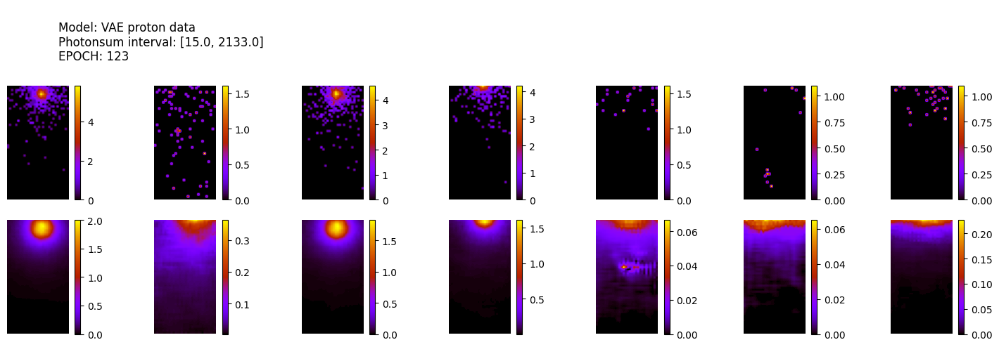

305/305 [==============================] - 1s 4ms/step
ws mean 28.67 ch1 65.96 ch2 5.38 ch3 0.26 ch4 0.01 ch5 71.72 Time for epoch 124 is 27.591110467910767 sec
37900 [Total loss: 99.34] [Recon_loss: 99.31] [KL loss: 0.04]
38000 [Total loss: 104.23] [Recon_loss: 103.94] [KL loss: 0.42]
38100 [Total loss: 96.41] [Recon_loss: 96.37] [KL loss: 0.06]


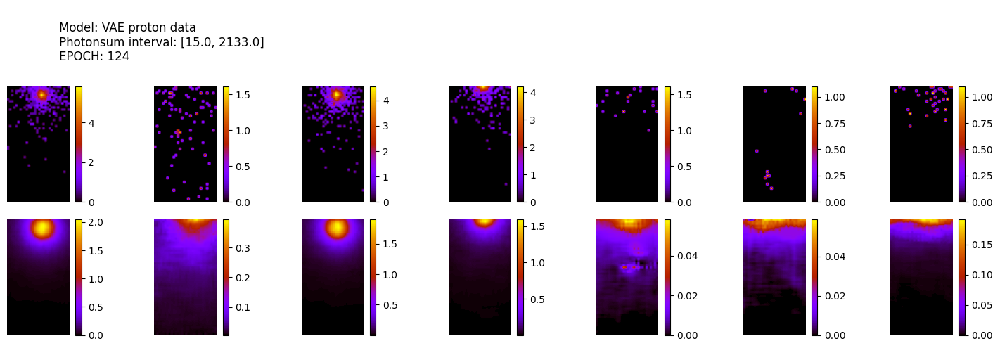

305/305 [==============================] - 1s 4ms/step
ws mean 27.74 ch1 64.02 ch2 5.01 ch3 0.25 ch4 0.01 ch5 69.41 Time for epoch 125 is 27.965104341506958 sec
38200 [Total loss: 85.90] [Recon_loss: 85.75] [KL loss: 0.22]
38300 [Total loss: 83.03] [Recon_loss: 82.97] [KL loss: 0.08]
38400 [Total loss: 89.92] [Recon_loss: 89.90] [KL loss: 0.04]


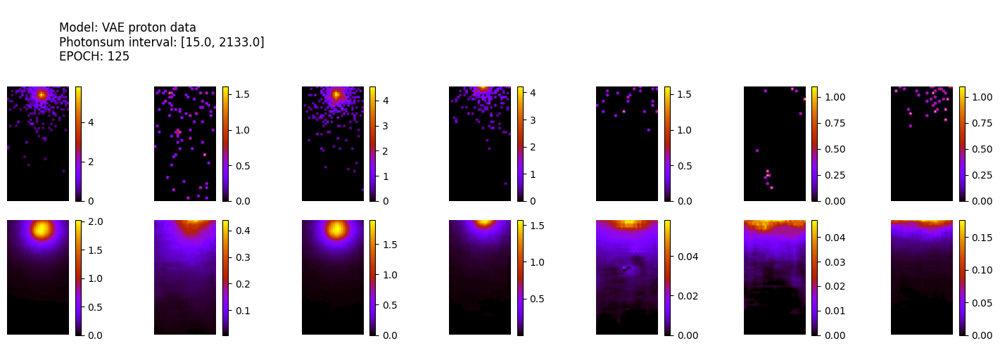

305/305 [==============================] - 1s 4ms/step
ws mean 27.99 ch1 64.46 ch2 5.19 ch3 0.25 ch4 0.01 ch5 70.06 Time for epoch 126 is 27.583208560943604 sec
38500 [Total loss: 91.00] [Recon_loss: 90.96] [KL loss: 0.04]
38600 [Total loss: 89.51] [Recon_loss: 89.43] [KL loss: 0.11]
38700 [Total loss: 87.34] [Recon_loss: 87.29] [KL loss: 0.08]


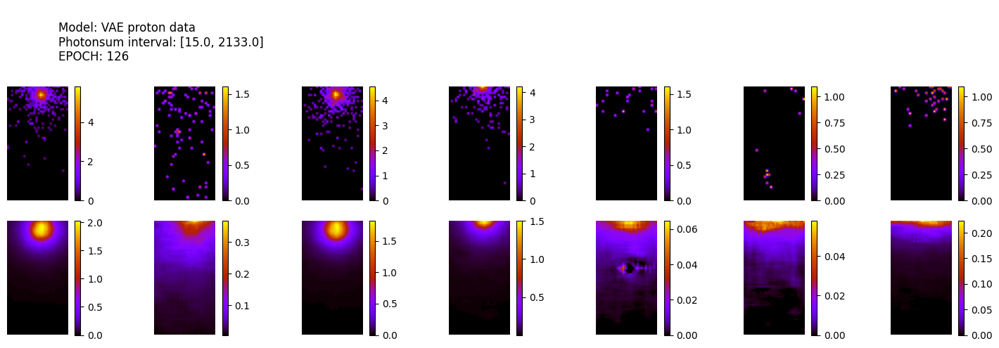

305/305 [==============================] - 1s 4ms/step
ws mean 28.67 ch1 66.10 ch2 5.28 ch3 0.25 ch4 0.01 ch5 71.71 Time for epoch 127 is 27.98195195198059 sec
38800 [Total loss: 98.13] [Recon_loss: 98.01] [KL loss: 0.17]
38900 [Total loss: 97.14] [Recon_loss: 97.10] [KL loss: 0.05]
39000 [Total loss: 93.16] [Recon_loss: 92.96] [KL loss: 0.30]


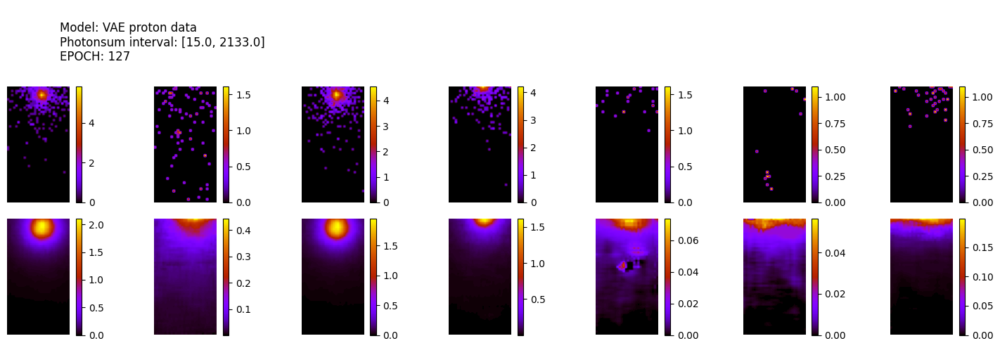

305/305 [==============================] - 1s 4ms/step
ws mean 26.86 ch1 61.87 ch2 4.98 ch3 0.24 ch4 0.01 ch5 67.21 Time for epoch 128 is 27.665034770965576 sec
39100 [Total loss: 99.62] [Recon_loss: 99.55] [KL loss: 0.09]
39200 [Total loss: 105.25] [Recon_loss: 104.93] [KL loss: 0.45]
39300 [Total loss: 90.88] [Recon_loss: 90.85] [KL loss: 0.04]


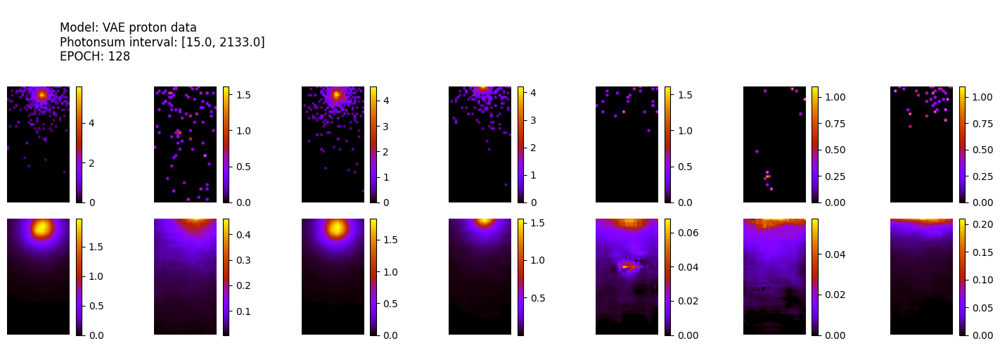

305/305 [==============================] - 1s 4ms/step
ws mean 28.52 ch1 65.82 ch2 5.26 ch3 0.25 ch4 0.01 ch5 71.24 Time for epoch 129 is 27.630579471588135 sec
39400 [Total loss: 101.85] [Recon_loss: 101.76] [KL loss: 0.12]
39500 [Total loss: 90.11] [Recon_loss: 90.10] [KL loss: 0.02]
39600 [Total loss: 97.76] [Recon_loss: 97.56] [KL loss: 0.28]


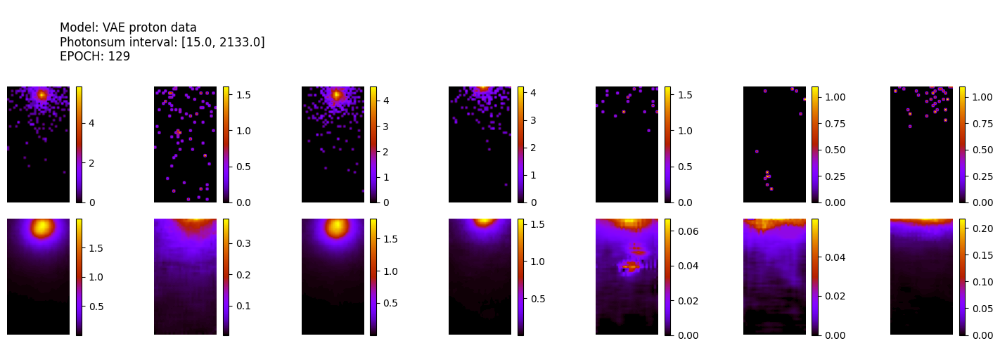

305/305 [==============================] - 1s 4ms/step
ws mean 28.23 ch1 65.27 ch2 5.04 ch3 0.26 ch4 0.01 ch5 70.58 Time for epoch 130 is 27.620300769805908 sec
39700 [Total loss: 96.47] [Recon_loss: 96.42] [KL loss: 0.07]
39800 [Total loss: 94.65] [Recon_loss: 94.62] [KL loss: 0.05]
39900 [Total loss: 102.20] [Recon_loss: 102.11] [KL loss: 0.14]


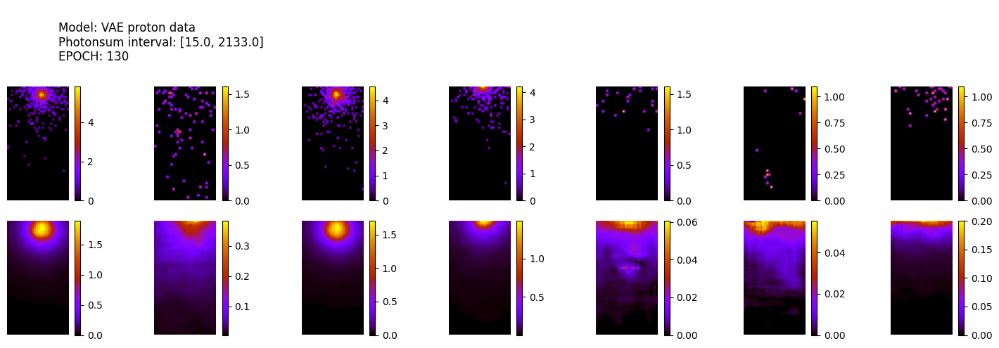

305/305 [==============================] - 1s 4ms/step
ws mean 29.04 ch1 67.00 ch2 5.33 ch3 0.25 ch4 0.01 ch5 72.63 Time for epoch 131 is 27.937236547470093 sec
40000 [Total loss: 99.37] [Recon_loss: 99.29] [KL loss: 0.12]
40100 [Total loss: 100.17] [Recon_loss: 100.07] [KL loss: 0.14]
40200 [Total loss: 97.00] [Recon_loss: 96.82] [KL loss: 0.26]


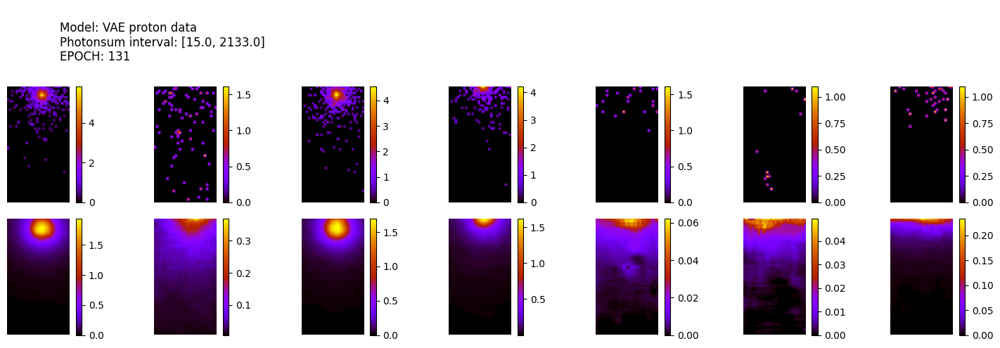

305/305 [==============================] - 1s 4ms/step
ws mean 29.29 ch1 67.64 ch2 5.27 ch3 0.27 ch4 0.01 ch5 73.26 Time for epoch 132 is 27.660744667053223 sec
40300 [Total loss: 85.54] [Recon_loss: 85.51] [KL loss: 0.05]
40400 [Total loss: 100.58] [Recon_loss: 100.55] [KL loss: 0.05]
40500 [Total loss: 67.31] [Recon_loss: 67.21] [KL loss: 0.14]


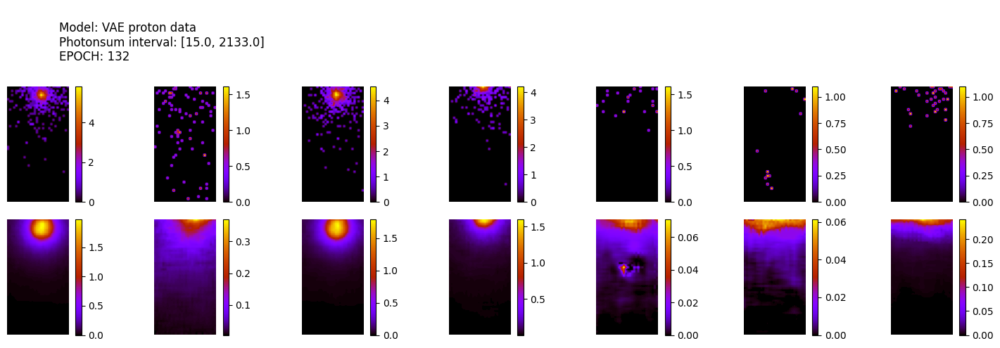

305/305 [==============================] - 1s 4ms/step
ws mean 29.08 ch1 66.88 ch2 5.52 ch3 0.25 ch4 0.01 ch5 72.75 Time for epoch 133 is 27.99405002593994 sec
40600 [Total loss: 100.23] [Recon_loss: 100.06] [KL loss: 0.24]
40700 [Total loss: 100.71] [Recon_loss: 100.66] [KL loss: 0.07]
40800 [Total loss: 98.45] [Recon_loss: 98.39] [KL loss: 0.09]


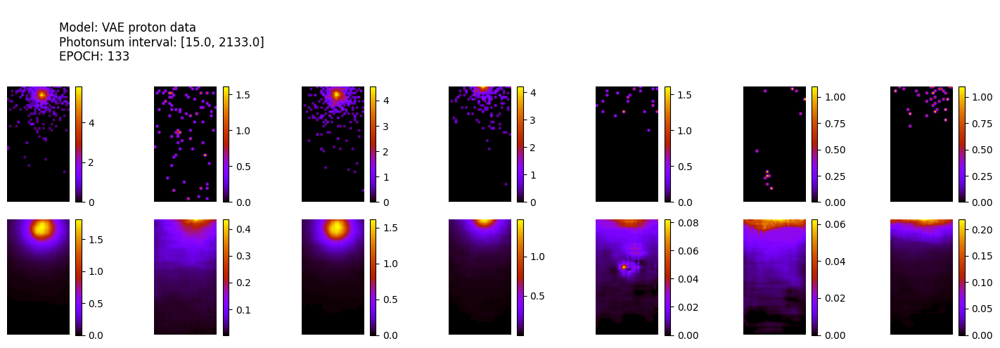

305/305 [==============================] - 1s 4ms/step
ws mean 29.23 ch1 67.83 ch2 5.09 ch3 0.27 ch4 0.01 ch5 72.97 Time for epoch 134 is 27.66521716117859 sec
40900 [Total loss: 92.55] [Recon_loss: 92.53] [KL loss: 0.03]
41000 [Total loss: 88.40] [Recon_loss: 88.27] [KL loss: 0.18]
41100 [Total loss: 87.42] [Recon_loss: 87.39] [KL loss: 0.04]


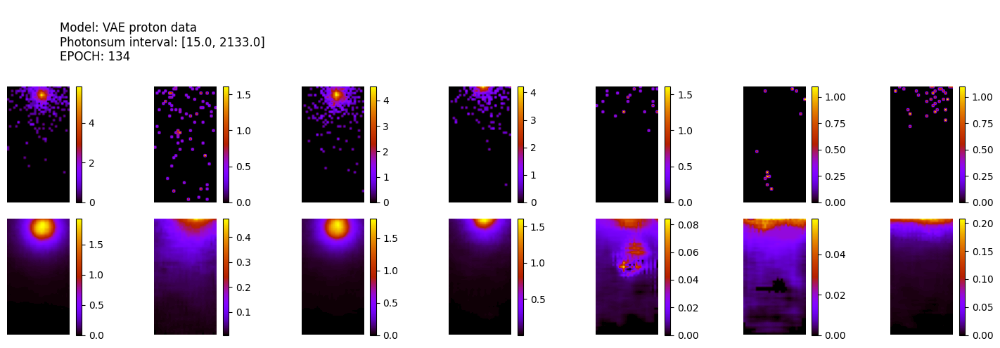

305/305 [==============================] - 1s 4ms/step
ws mean 26.55 ch1 61.78 ch2 4.57 ch3 0.24 ch4 0.01 ch5 66.14 Time for epoch 135 is 27.734262228012085 sec
41200 [Total loss: 85.47] [Recon_loss: 85.42] [KL loss: 0.08]
41300 [Total loss: 99.60] [Recon_loss: 99.48] [KL loss: 0.17]
41400 [Total loss: 98.35] [Recon_loss: 98.33] [KL loss: 0.02]


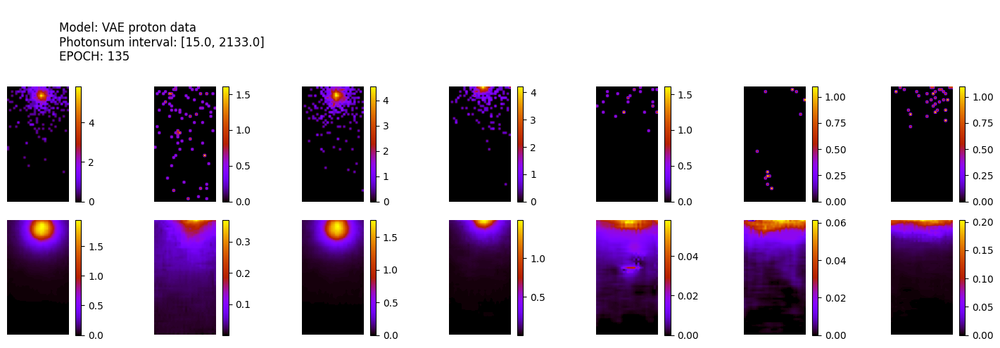

305/305 [==============================] - 1s 4ms/step
ws mean 28.64 ch1 65.90 ch2 5.43 ch3 0.26 ch4 0.01 ch5 71.63 Time for epoch 136 is 27.989283800125122 sec
41500 [Total loss: 98.67] [Recon_loss: 98.41] [KL loss: 0.37]
41600 [Total loss: 108.26] [Recon_loss: 108.12] [KL loss: 0.20]
41700 [Total loss: 80.72] [Recon_loss: 80.67] [KL loss: 0.08]


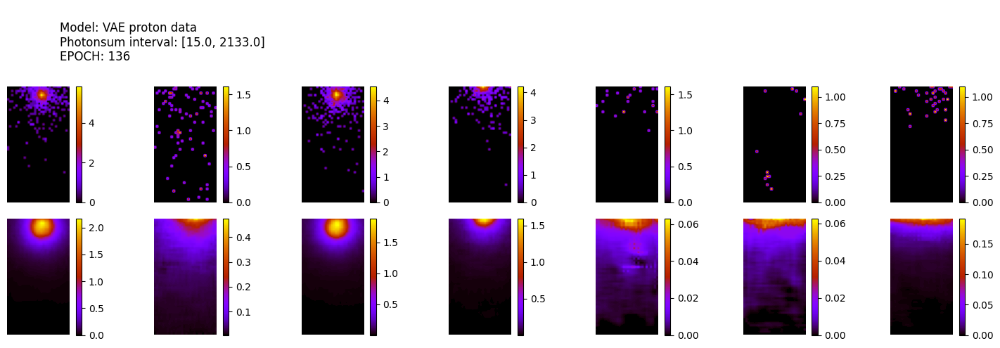

305/305 [==============================] - 1s 4ms/step
ws mean 25.96 ch1 59.64 ch2 5.07 ch3 0.22 ch4 0.01 ch5 64.87 Time for epoch 137 is 27.710273265838623 sec
41800 [Total loss: 103.08] [Recon_loss: 102.88] [KL loss: 0.29]
41900 [Total loss: 86.00] [Recon_loss: 85.93] [KL loss: 0.10]
42000 [Total loss: 94.09] [Recon_loss: 94.02] [KL loss: 0.10]


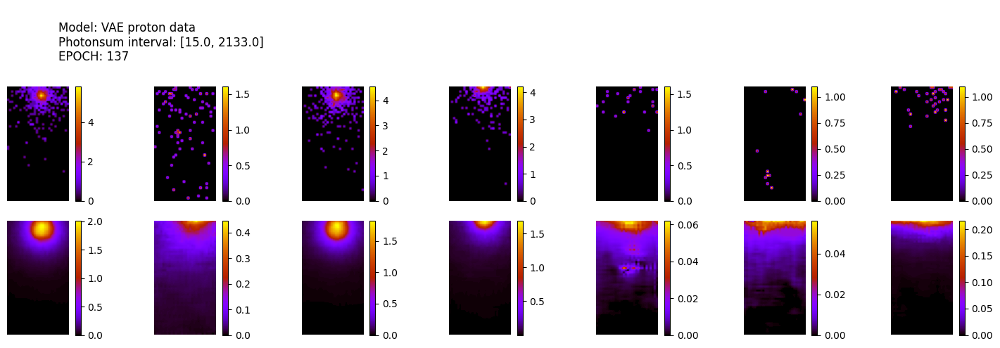

305/305 [==============================] - 1s 4ms/step
ws mean 28.38 ch1 65.26 ch2 5.38 ch3 0.26 ch4 0.01 ch5 71.00 Time for epoch 138 is 28.06802225112915 sec
42100 [Total loss: 96.38] [Recon_loss: 96.18] [KL loss: 0.29]
42200 [Total loss: 83.52] [Recon_loss: 83.51] [KL loss: 0.02]
42300 [Total loss: 75.42] [Recon_loss: 75.41] [KL loss: 0.01]


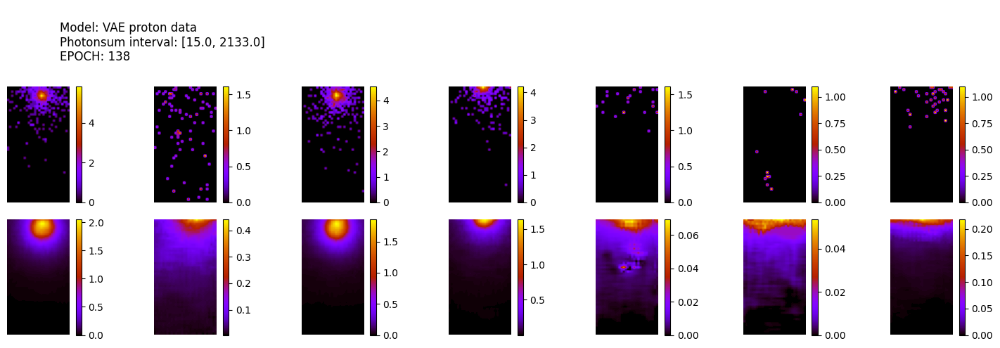

305/305 [==============================] - 1s 4ms/step
ws mean 27.57 ch1 64.08 ch2 4.61 ch3 0.25 ch4 0.01 ch5 68.91 Time for epoch 139 is 27.86614966392517 sec
42400 [Total loss: 107.88] [Recon_loss: 107.75] [KL loss: 0.18]
42500 [Total loss: 93.79] [Recon_loss: 93.77] [KL loss: 0.04]
42600 [Total loss: 100.60] [Recon_loss: 100.35] [KL loss: 0.36]
42700 [Total loss: 88.37] [Recon_loss: 88.35] [KL loss: 0.03]


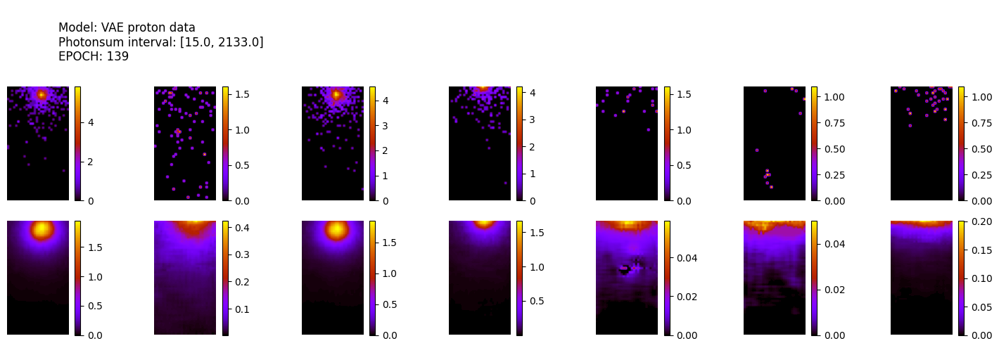

305/305 [==============================] - 1s 4ms/step
ws mean 27.62 ch1 63.71 ch2 5.00 ch3 0.25 ch4 0.01 ch5 69.14 Time for epoch 140 is 27.761385440826416 sec
42800 [Total loss: 83.87] [Recon_loss: 83.84] [KL loss: 0.05]
42900 [Total loss: 94.89] [Recon_loss: 94.80] [KL loss: 0.13]
43000 [Total loss: 98.05] [Recon_loss: 97.92] [KL loss: 0.18]


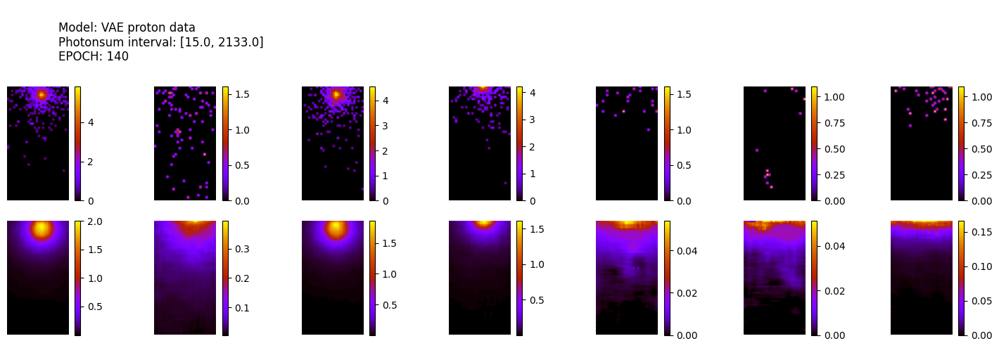

305/305 [==============================] - 1s 4ms/step
ws mean 28.55 ch1 65.53 ch2 5.51 ch3 0.26 ch4 0.01 ch5 71.47 Time for epoch 141 is 28.109517812728882 sec
43100 [Total loss: 83.16] [Recon_loss: 83.14] [KL loss: 0.03]
43200 [Total loss: 85.68] [Recon_loss: 85.62] [KL loss: 0.09]
43300 [Total loss: 109.83] [Recon_loss: 109.53] [KL loss: 0.43]


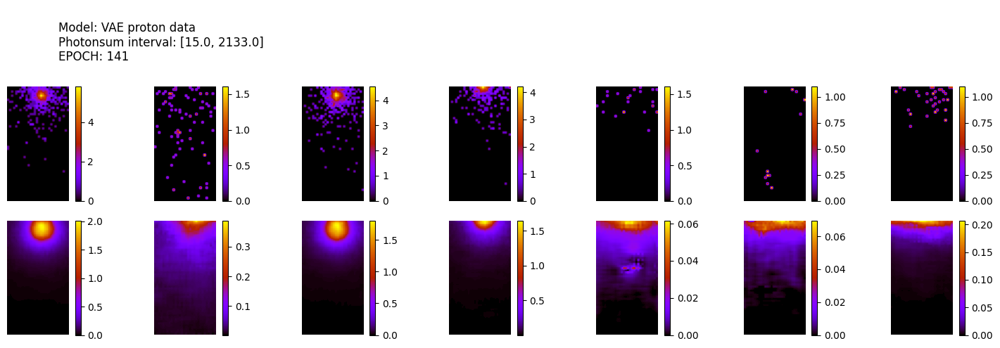

305/305 [==============================] - 1s 4ms/step
ws mean 27.48 ch1 63.09 ch2 5.29 ch3 0.24 ch4 0.01 ch5 68.75 Time for epoch 142 is 27.82027578353882 sec
43400 [Total loss: 90.12] [Recon_loss: 90.06] [KL loss: 0.10]
43500 [Total loss: 94.27] [Recon_loss: 94.22] [KL loss: 0.07]
43600 [Total loss: 108.69] [Recon_loss: 108.64] [KL loss: 0.07]


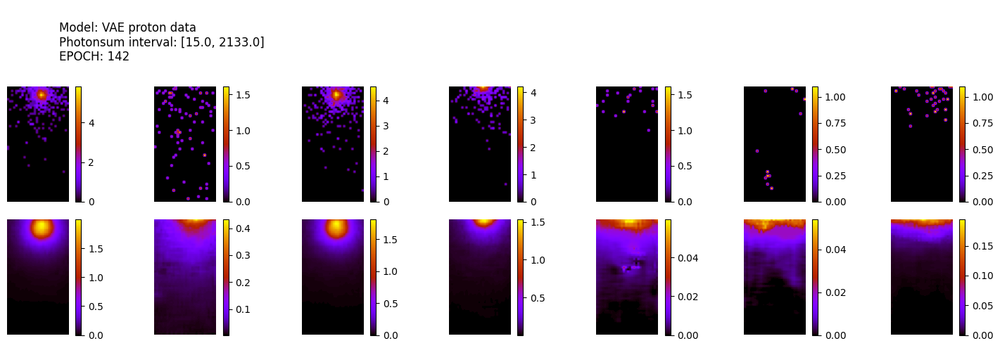

305/305 [==============================] - 1s 4ms/step
ws mean 28.34 ch1 65.54 ch2 4.99 ch3 0.25 ch4 0.01 ch5 70.90 Time for epoch 143 is 28.134140729904175 sec
43700 [Total loss: 109.35] [Recon_loss: 109.30] [KL loss: 0.07]
43800 [Total loss: 97.35] [Recon_loss: 97.34] [KL loss: 0.02]
43900 [Total loss: 82.40] [Recon_loss: 82.34] [KL loss: 0.09]


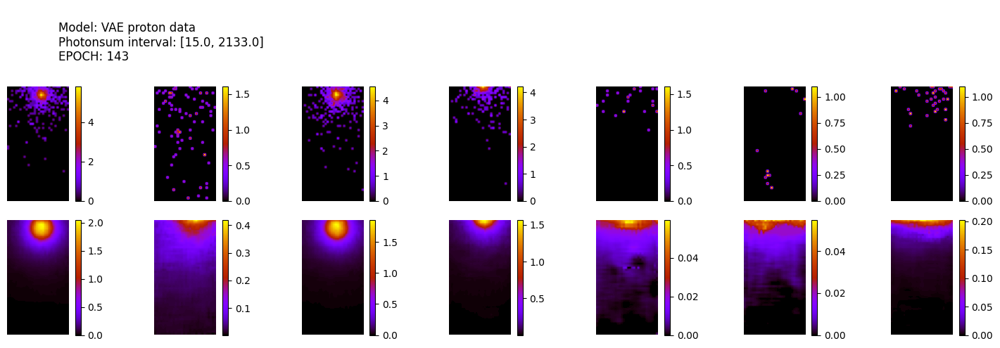

305/305 [==============================] - 1s 4ms/step
ws mean 27.19 ch1 62.74 ch2 4.98 ch3 0.23 ch4 0.01 ch5 67.98 Time for epoch 144 is 27.828673362731934 sec
44000 [Total loss: 81.51] [Recon_loss: 81.48] [KL loss: 0.05]
44100 [Total loss: 92.21] [Recon_loss: 92.19] [KL loss: 0.03]
44200 [Total loss: 98.55] [Recon_loss: 98.31] [KL loss: 0.33]


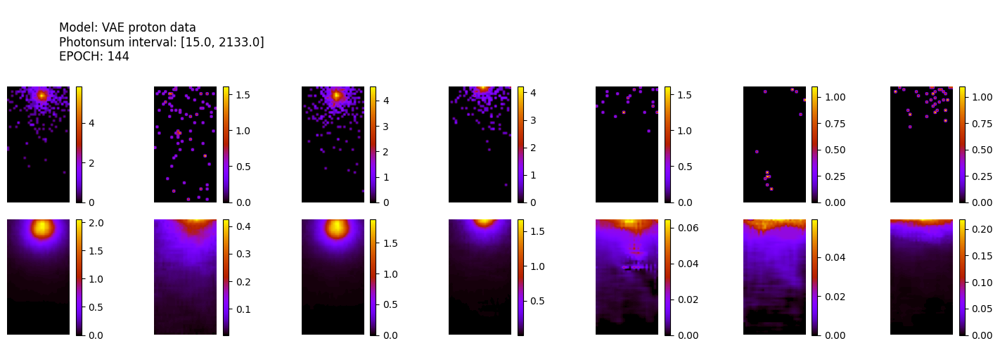

305/305 [==============================] - 1s 4ms/step
ws mean 26.72 ch1 61.97 ch2 4.65 ch3 0.23 ch4 0.01 ch5 66.75 Time for epoch 145 is 28.230968475341797 sec
44300 [Total loss: 94.25] [Recon_loss: 94.20] [KL loss: 0.07]
44400 [Total loss: 109.14] [Recon_loss: 109.07] [KL loss: 0.11]
44500 [Total loss: 98.76] [Recon_loss: 98.65] [KL loss: 0.17]


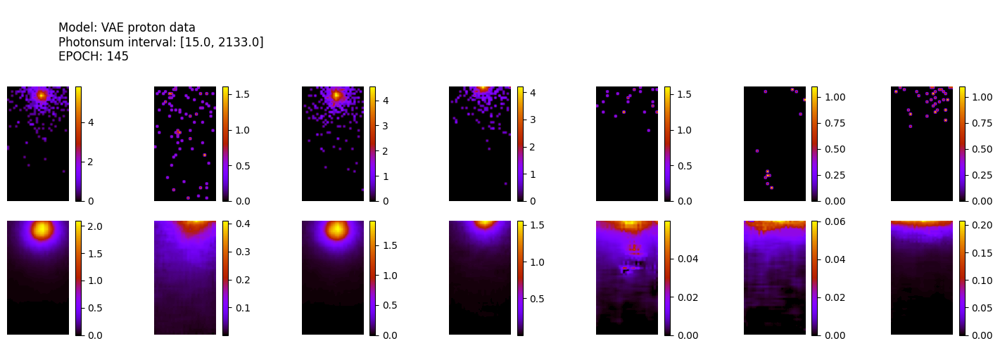

305/305 [==============================] - 1s 4ms/step
ws mean 28.67 ch1 66.06 ch2 5.30 ch3 0.25 ch4 0.01 ch5 71.75 Time for epoch 146 is 27.77534556388855 sec
44600 [Total loss: 99.07] [Recon_loss: 99.04] [KL loss: 0.04]
44700 [Total loss: 100.14] [Recon_loss: 99.96] [KL loss: 0.25]
44800 [Total loss: 96.79] [Recon_loss: 96.53] [KL loss: 0.37]


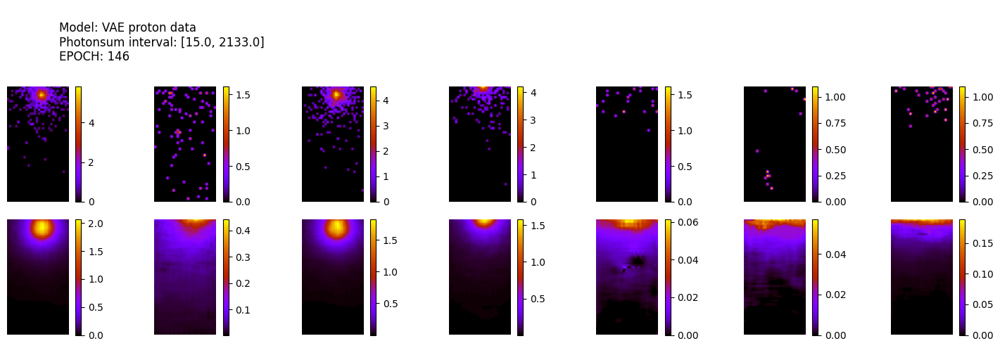

305/305 [==============================] - 1s 4ms/step
ws mean 28.26 ch1 65.20 ch2 5.13 ch3 0.25 ch4 0.01 ch5 70.69 Time for epoch 147 is 27.782593727111816 sec
44900 [Total loss: 93.54] [Recon_loss: 93.39] [KL loss: 0.22]
45000 [Total loss: 90.13] [Recon_loss: 90.12] [KL loss: 0.02]
45100 [Total loss: 83.54] [Recon_loss: 83.46] [KL loss: 0.11]


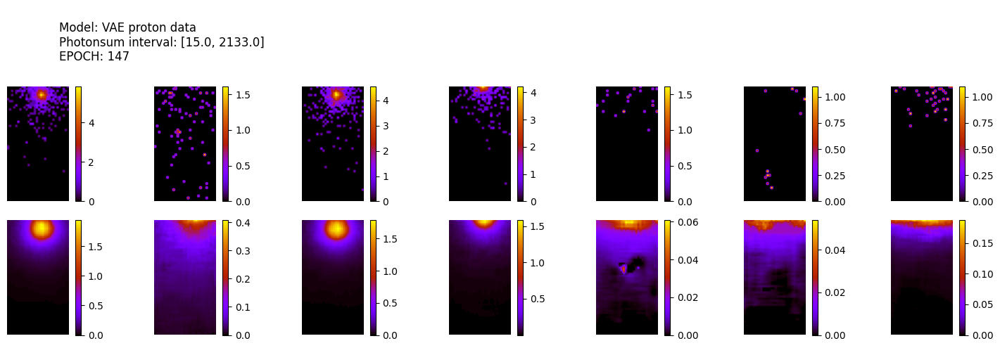

305/305 [==============================] - 1s 4ms/step
ws mean 28.67 ch1 65.96 ch2 5.41 ch3 0.27 ch4 0.01 ch5 71.70 Time for epoch 148 is 28.140368938446045 sec
45200 [Total loss: 84.74] [Recon_loss: 84.72] [KL loss: 0.03]
45300 [Total loss: 97.05] [Recon_loss: 96.99] [KL loss: 0.09]
45400 [Total loss: 78.89] [Recon_loss: 78.88] [KL loss: 0.02]


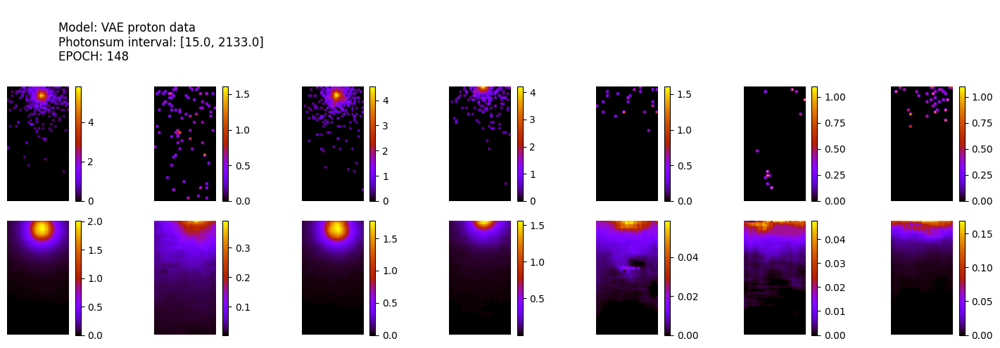

305/305 [==============================] - 1s 4ms/step
ws mean 29.55 ch1 67.73 ch2 5.79 ch3 0.27 ch4 0.01 ch5 73.98 Time for epoch 149 is 27.837027311325073 sec
45500 [Total loss: 76.84] [Recon_loss: 76.83] [KL loss: 0.02]
45600 [Total loss: 97.29] [Recon_loss: 97.24] [KL loss: 0.06]
45700 [Total loss: 111.50] [Recon_loss: 111.44] [KL loss: 0.09]


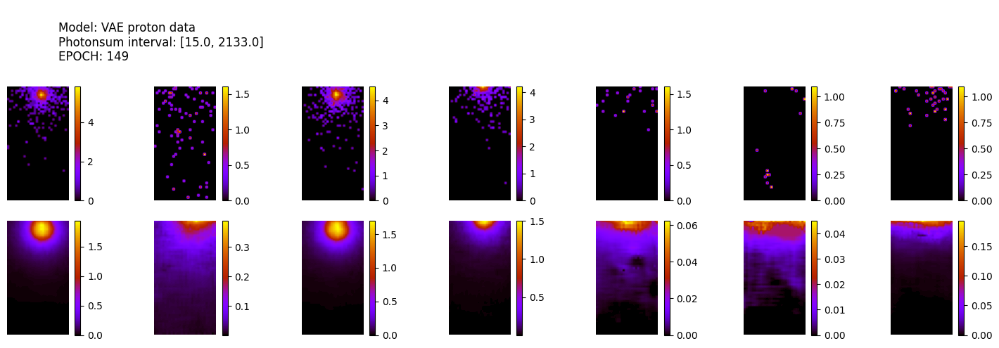

305/305 [==============================] - 1s 4ms/step
ws mean 29.12 ch1 67.04 ch2 5.44 ch3 0.26 ch4 0.01 ch5 72.87 Time for epoch 150 is 28.169248342514038 sec
45800 [Total loss: 85.00] [Recon_loss: 84.96] [KL loss: 0.05]
45900 [Total loss: 96.45] [Recon_loss: 96.39] [KL loss: 0.08]
46000 [Total loss: 89.51] [Recon_loss: 89.48] [KL loss: 0.04]


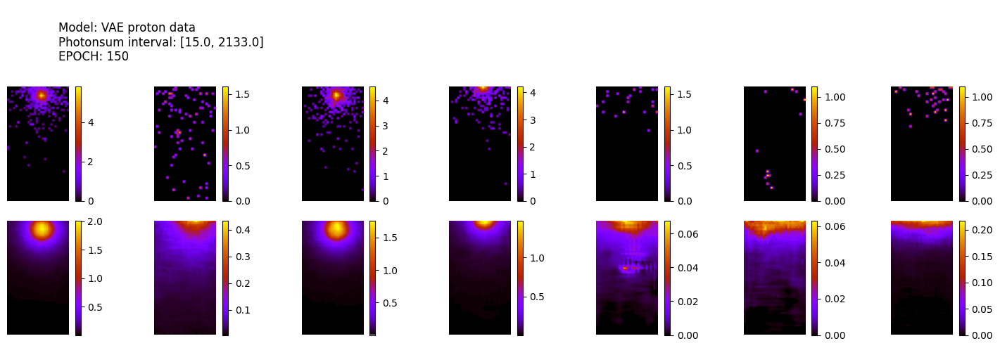

305/305 [==============================] - 1s 4ms/step
ws mean 28.44 ch1 65.75 ch2 5.09 ch3 0.25 ch4 0.01 ch5 71.13 Time for epoch 151 is 27.941842317581177 sec
46100 [Total loss: 85.57] [Recon_loss: 85.47] [KL loss: 0.14]
46200 [Total loss: 97.54] [Recon_loss: 97.46] [KL loss: 0.12]
46300 [Total loss: 103.24] [Recon_loss: 103.13] [KL loss: 0.15]


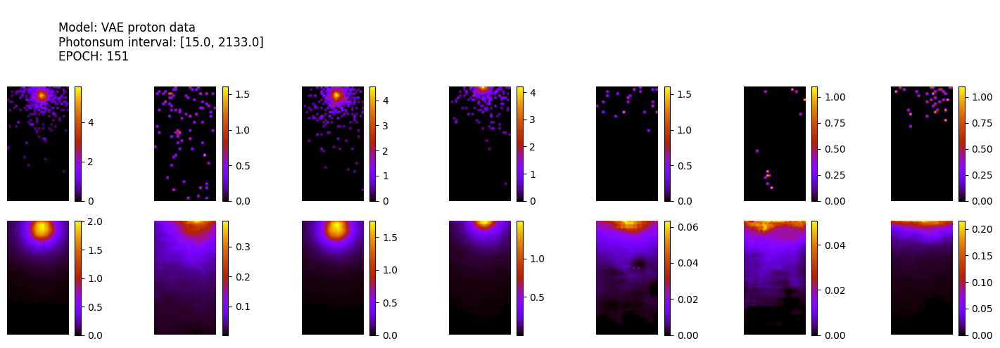

305/305 [==============================] - 1s 4ms/step
ws mean 27.98 ch1 64.92 ch2 4.81 ch3 0.25 ch4 0.01 ch5 69.90 Time for epoch 152 is 28.195698261260986 sec
46400 [Total loss: 91.19] [Recon_loss: 91.12] [KL loss: 0.10]
46500 [Total loss: 95.85] [Recon_loss: 95.76] [KL loss: 0.13]
46600 [Total loss: 101.09] [Recon_loss: 101.04] [KL loss: 0.07]


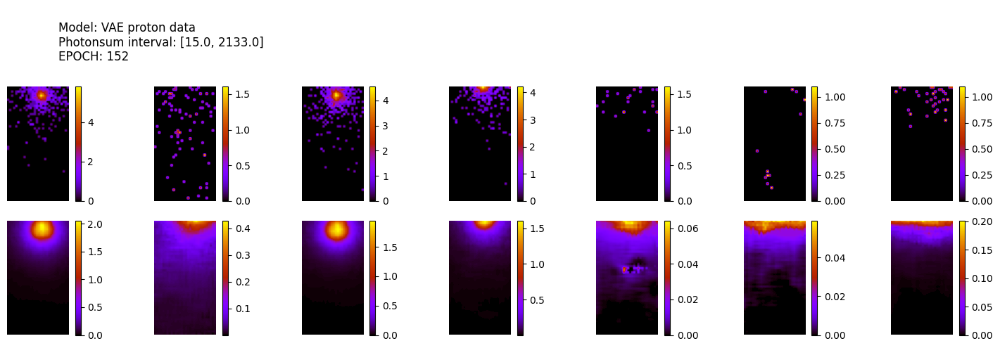

305/305 [==============================] - 1s 4ms/step
ws mean 27.27 ch1 62.54 ch2 5.32 ch3 0.23 ch4 0.01 ch5 68.26 Time for epoch 153 is 27.916141510009766 sec
46700 [Total loss: 102.34] [Recon_loss: 102.29] [KL loss: 0.07]
46800 [Total loss: 98.54] [Recon_loss: 98.38] [KL loss: 0.23]
46900 [Total loss: 99.74] [Recon_loss: 99.58] [KL loss: 0.22]


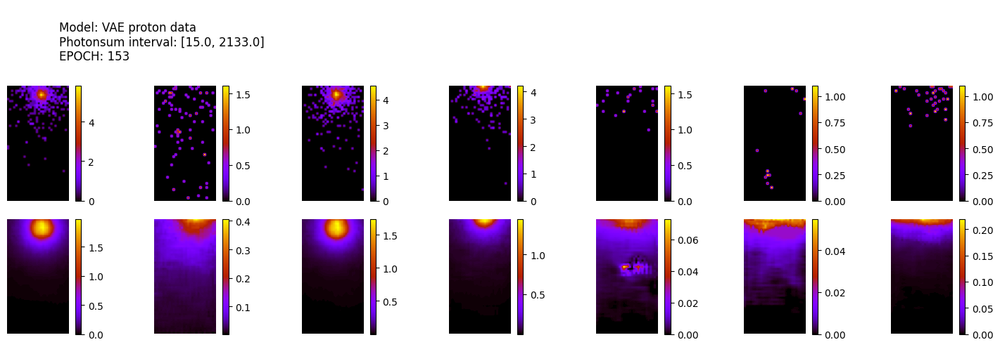

305/305 [==============================] - 1s 4ms/step
ws mean 28.13 ch1 65.12 ch2 4.95 ch3 0.25 ch4 0.01 ch5 70.34 Time for epoch 154 is 28.22849416732788 sec
47000 [Total loss: 84.54] [Recon_loss: 84.46] [KL loss: 0.11]
47100 [Total loss: 85.83] [Recon_loss: 85.66] [KL loss: 0.23]
47200 [Total loss: 86.18] [Recon_loss: 86.09] [KL loss: 0.12]


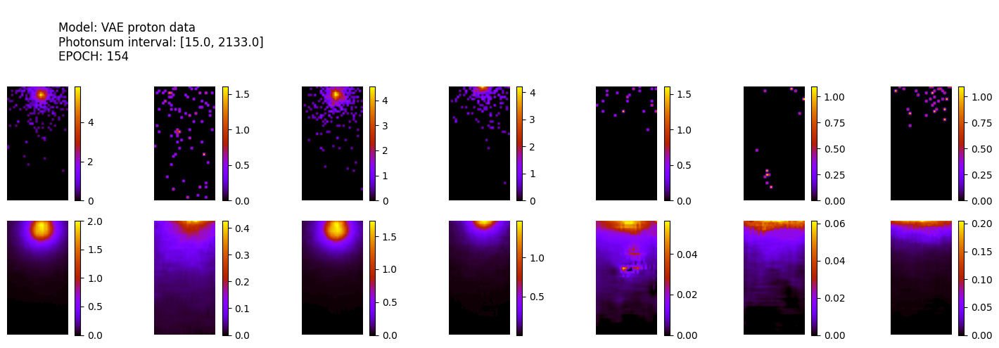

305/305 [==============================] - 1s 4ms/step
ws mean 27.50 ch1 63.88 ch2 4.66 ch3 0.24 ch4 0.01 ch5 68.69 Time for epoch 155 is 27.878043174743652 sec
47300 [Total loss: 96.64] [Recon_loss: 96.53] [KL loss: 0.16]
47400 [Total loss: 85.42] [Recon_loss: 85.37] [KL loss: 0.06]
47500 [Total loss: 104.90] [Recon_loss: 104.86] [KL loss: 0.05]


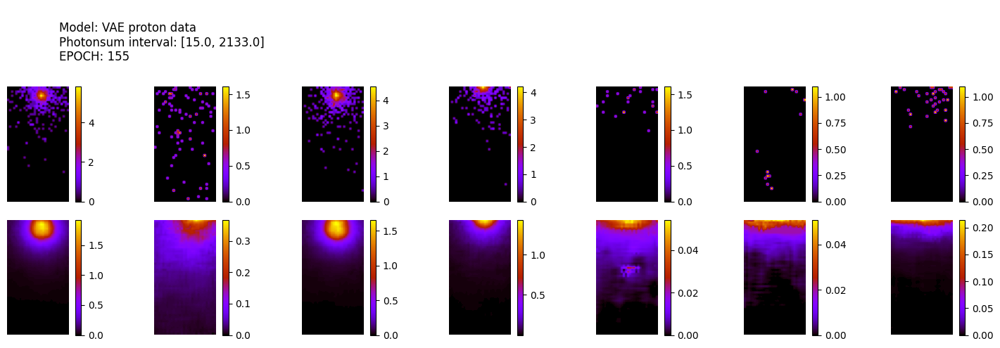

305/305 [==============================] - 1s 4ms/step
ws mean 29.60 ch1 68.02 ch2 5.57 ch3 0.26 ch4 0.01 ch5 74.11 Time for epoch 156 is 28.23868680000305 sec
47600 [Total loss: 102.81] [Recon_loss: 102.78] [KL loss: 0.04]
47700 [Total loss: 95.71] [Recon_loss: 95.59] [KL loss: 0.17]
47800 [Total loss: 94.22] [Recon_loss: 94.19] [KL loss: 0.05]


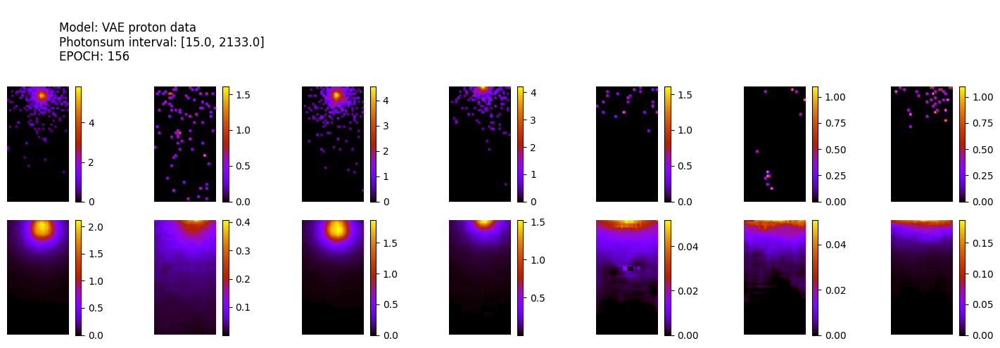

305/305 [==============================] - 1s 4ms/step
ws mean 26.78 ch1 61.62 ch2 5.01 ch3 0.23 ch4 0.01 ch5 67.02 Time for epoch 157 is 27.900694370269775 sec
47900 [Total loss: 79.10] [Recon_loss: 79.07] [KL loss: 0.04]
48000 [Total loss: 96.54] [Recon_loss: 96.50] [KL loss: 0.05]
48100 [Total loss: 87.29] [Recon_loss: 87.23] [KL loss: 0.08]


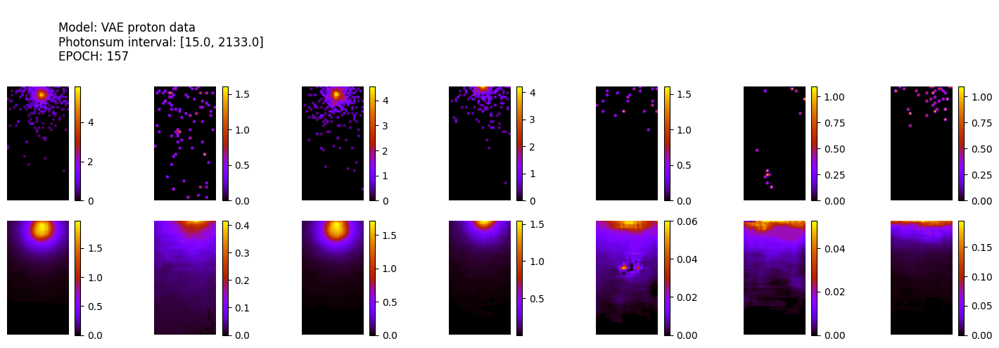

305/305 [==============================] - 1s 4ms/step
ws mean 28.49 ch1 65.79 ch2 5.15 ch3 0.25 ch4 0.01 ch5 71.25 Time for epoch 158 is 28.373520374298096 sec
48200 [Total loss: 79.26] [Recon_loss: 79.24] [KL loss: 0.03]
48300 [Total loss: 99.55] [Recon_loss: 99.48] [KL loss: 0.11]
48400 [Total loss: 83.70] [Recon_loss: 83.67] [KL loss: 0.04]


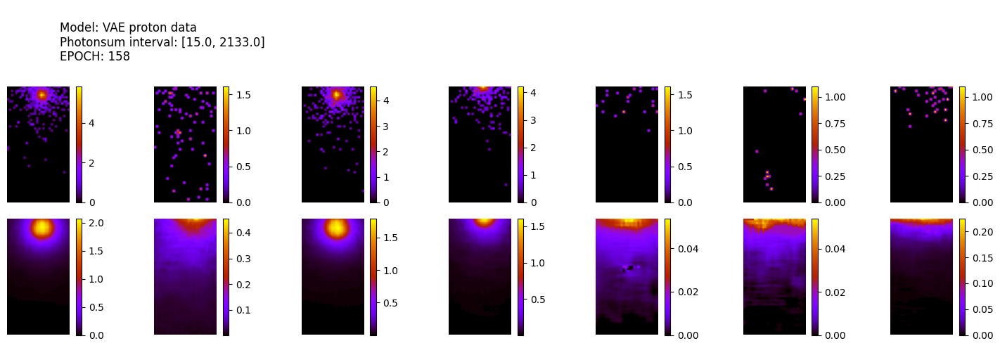

305/305 [==============================] - 1s 4ms/step
ws mean 27.17 ch1 62.88 ch2 4.77 ch3 0.24 ch4 0.01 ch5 67.94 Time for epoch 159 is 27.997973680496216 sec
48500 [Total loss: 77.58] [Recon_loss: 77.54] [KL loss: 0.06]
48600 [Total loss: 102.89] [Recon_loss: 102.80] [KL loss: 0.14]
48700 [Total loss: 92.51] [Recon_loss: 92.44] [KL loss: 0.11]
48800 [Total loss: 106.41] [Recon_loss: 106.33] [KL loss: 0.12]


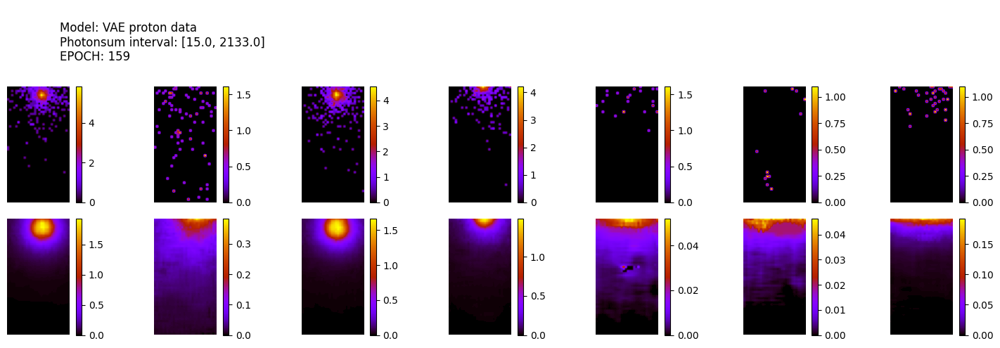

305/305 [==============================] - 1s 4ms/step
ws mean 27.86 ch1 64.24 ch2 5.11 ch3 0.23 ch4 0.01 ch5 69.71 Time for epoch 160 is 28.27766704559326 sec
48900 [Total loss: 73.02] [Recon_loss: 72.86] [KL loss: 0.23]
49000 [Total loss: 95.42] [Recon_loss: 95.23] [KL loss: 0.27]
49100 [Total loss: 64.27] [Recon_loss: 64.26] [KL loss: 0.01]


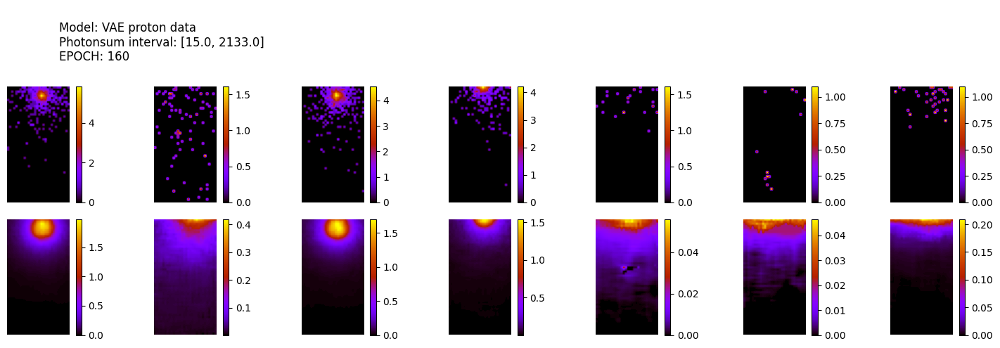

305/305 [==============================] - 1s 4ms/step
ws mean 29.32 ch1 67.31 ch2 5.62 ch3 0.26 ch4 0.01 ch5 73.39 Time for epoch 161 is 28.02873969078064 sec
49200 [Total loss: 90.74] [Recon_loss: 90.62] [KL loss: 0.16]
49300 [Total loss: 91.59] [Recon_loss: 91.50] [KL loss: 0.14]
49400 [Total loss: 97.88] [Recon_loss: 97.67] [KL loss: 0.30]


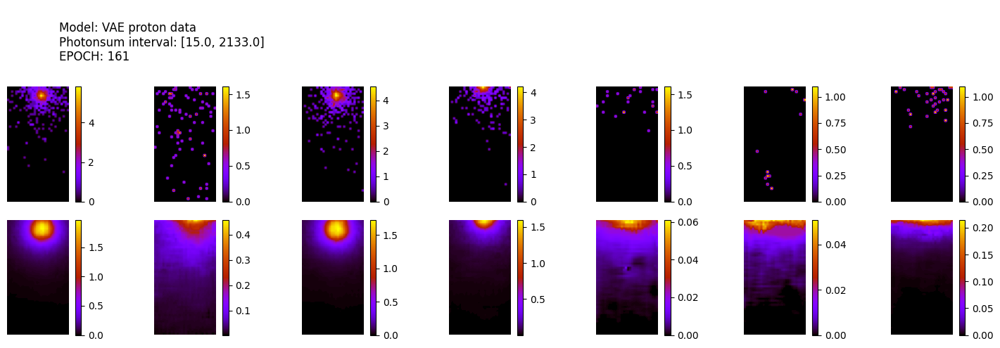

305/305 [==============================] - 1s 4ms/step
ws mean 27.25 ch1 63.06 ch2 4.77 ch3 0.24 ch4 0.01 ch5 68.18 Time for epoch 162 is 27.978782653808594 sec
49500 [Total loss: 99.46] [Recon_loss: 99.44] [KL loss: 0.03]
49600 [Total loss: 105.06] [Recon_loss: 104.96] [KL loss: 0.14]
49700 [Total loss: 98.64] [Recon_loss: 98.61] [KL loss: 0.05]


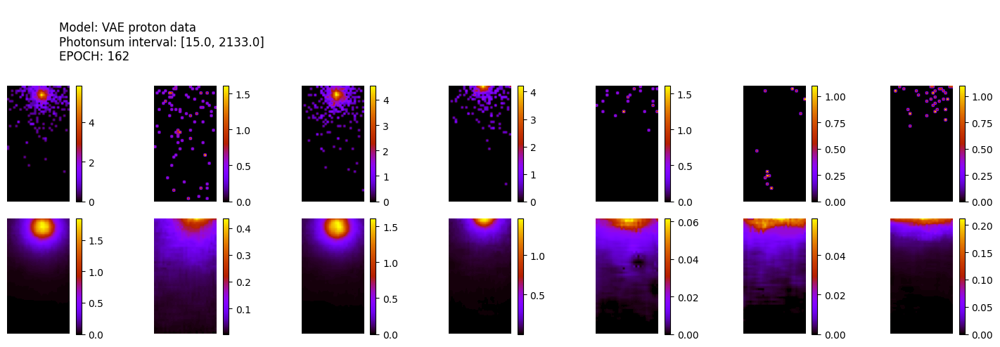

305/305 [==============================] - 1s 4ms/step
ws mean 29.32 ch1 67.82 ch2 5.21 ch3 0.26 ch4 0.01 ch5 73.31 Time for epoch 163 is 28.338603734970093 sec
49800 [Total loss: 100.15] [Recon_loss: 100.14] [KL loss: 0.02]
49900 [Total loss: 101.48] [Recon_loss: 101.40] [KL loss: 0.12]
50000 [Total loss: 83.94] [Recon_loss: 83.92] [KL loss: 0.03]


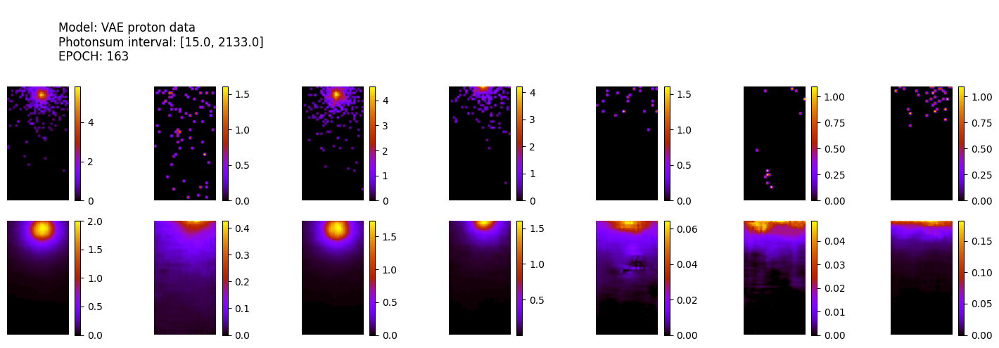

305/305 [==============================] - 1s 4ms/step
ws mean 28.90 ch1 66.35 ch2 5.52 ch3 0.25 ch4 0.01 ch5 72.35 Time for epoch 164 is 28.021660327911377 sec
50100 [Total loss: 100.15] [Recon_loss: 99.72] [KL loss: 0.62]
50200 [Total loss: 86.29] [Recon_loss: 86.21] [KL loss: 0.11]
50300 [Total loss: 95.23] [Recon_loss: 95.14] [KL loss: 0.13]


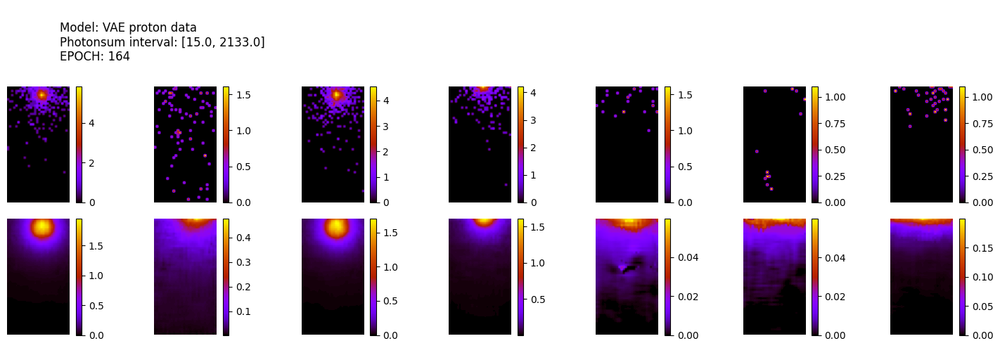

305/305 [==============================] - 1s 4ms/step
ws mean 27.54 ch1 63.36 ch2 5.17 ch3 0.25 ch4 0.01 ch5 68.92 Time for epoch 165 is 28.450173377990723 sec
50400 [Total loss: 96.22] [Recon_loss: 96.14] [KL loss: 0.11]
50500 [Total loss: 83.87] [Recon_loss: 83.86] [KL loss: 0.01]
50600 [Total loss: 96.29] [Recon_loss: 96.14] [KL loss: 0.21]


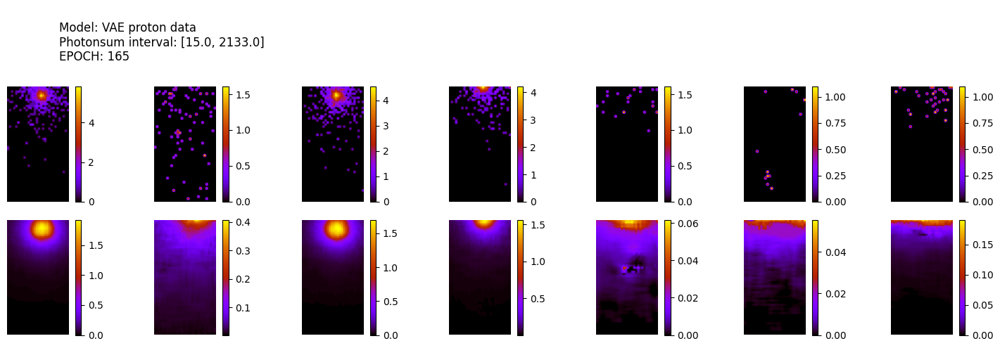

305/305 [==============================] - 1s 4ms/step
ws mean 29.88 ch1 68.74 ch2 5.63 ch3 0.27 ch4 0.01 ch5 74.76 Time for epoch 166 is 28.02016568183899 sec
50700 [Total loss: 101.35] [Recon_loss: 101.21] [KL loss: 0.20]
50800 [Total loss: 104.88] [Recon_loss: 104.69] [KL loss: 0.27]
50900 [Total loss: 88.31] [Recon_loss: 88.07] [KL loss: 0.34]


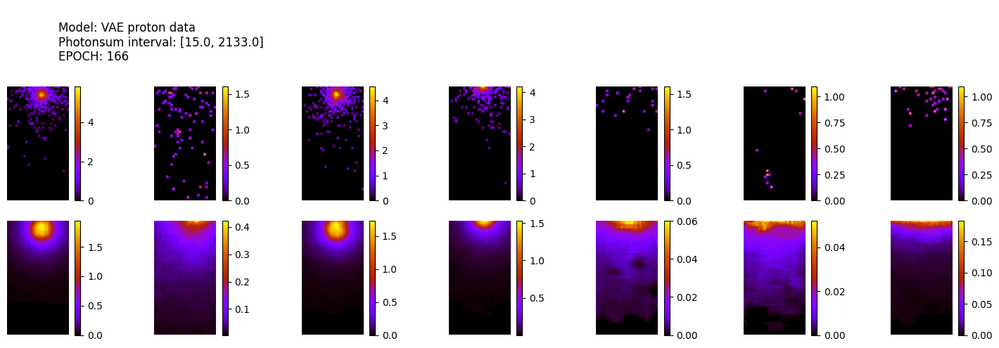

305/305 [==============================] - 1s 4ms/step
ws mean 28.89 ch1 67.06 ch2 4.98 ch3 0.26 ch4 0.01 ch5 72.15 Time for epoch 167 is 28.325324296951294 sec
51000 [Total loss: 99.17] [Recon_loss: 99.11] [KL loss: 0.08]
51100 [Total loss: 96.98] [Recon_loss: 96.90] [KL loss: 0.11]
51200 [Total loss: 107.60] [Recon_loss: 107.59] [KL loss: 0.02]


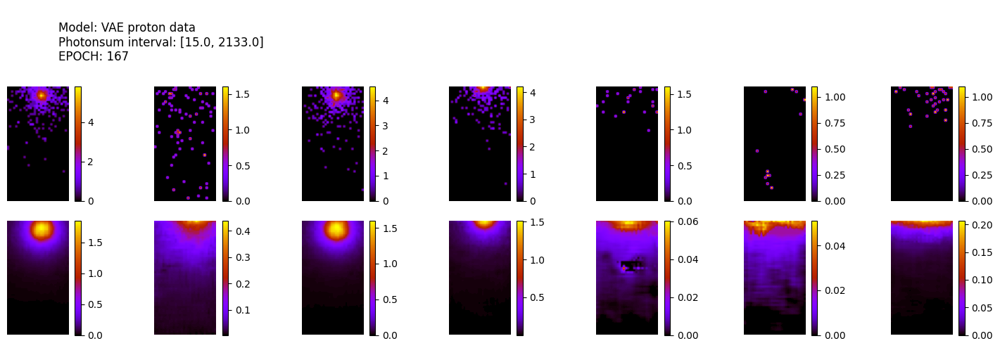

305/305 [==============================] - 1s 4ms/step
ws mean 29.88 ch1 69.10 ch2 5.34 ch3 0.27 ch4 0.01 ch5 74.69 Time for epoch 168 is 28.022494554519653 sec
51300 [Total loss: 112.16] [Recon_loss: 112.11] [KL loss: 0.07]
51400 [Total loss: 97.74] [Recon_loss: 97.67] [KL loss: 0.10]
51500 [Total loss: 96.14] [Recon_loss: 96.13] [KL loss: 0.02]


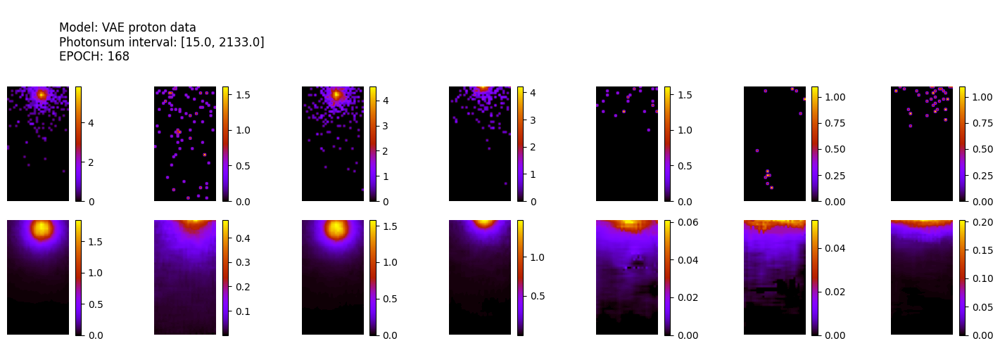

305/305 [==============================] - 1s 4ms/step
ws mean 29.78 ch1 68.65 ch2 5.46 ch3 0.27 ch4 0.01 ch5 74.49 Time for epoch 169 is 28.324474573135376 sec
51600 [Total loss: 89.65] [Recon_loss: 89.64] [KL loss: 0.01]
51700 [Total loss: 94.76] [Recon_loss: 94.66] [KL loss: 0.14]
51800 [Total loss: 96.82] [Recon_loss: 96.73] [KL loss: 0.12]


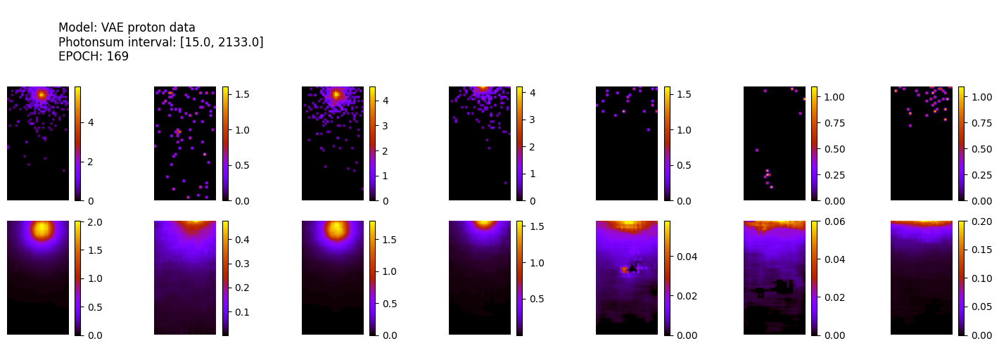

305/305 [==============================] - 1s 4ms/step
ws mean 27.36 ch1 63.71 ch2 4.52 ch3 0.24 ch4 0.01 ch5 68.34 Time for epoch 170 is 28.007571697235107 sec
51900 [Total loss: 99.93] [Recon_loss: 99.86] [KL loss: 0.09]
52000 [Total loss: 78.39] [Recon_loss: 78.35] [KL loss: 0.06]
52100 [Total loss: 91.87] [Recon_loss: 91.80] [KL loss: 0.11]


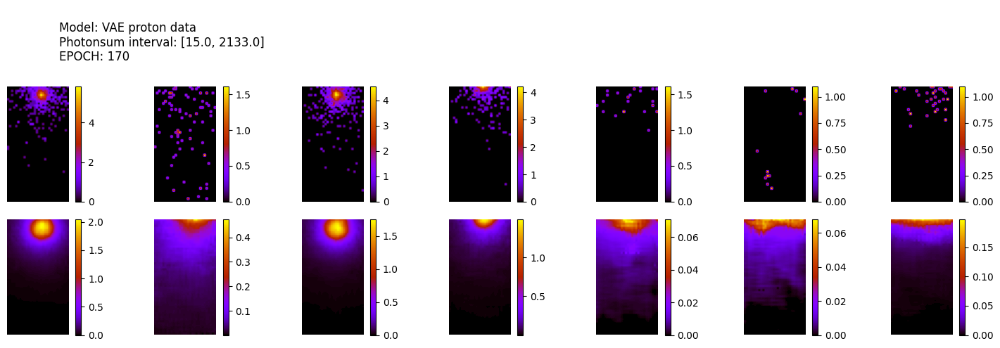

305/305 [==============================] - 1s 4ms/step
ws mean 26.73 ch1 61.95 ch2 4.66 ch3 0.23 ch4 0.01 ch5 66.79 Time for epoch 171 is 28.367905139923096 sec
52200 [Total loss: 95.63] [Recon_loss: 95.57] [KL loss: 0.09]
52300 [Total loss: 77.92] [Recon_loss: 77.90] [KL loss: 0.04]
52400 [Total loss: 96.93] [Recon_loss: 96.91] [KL loss: 0.03]


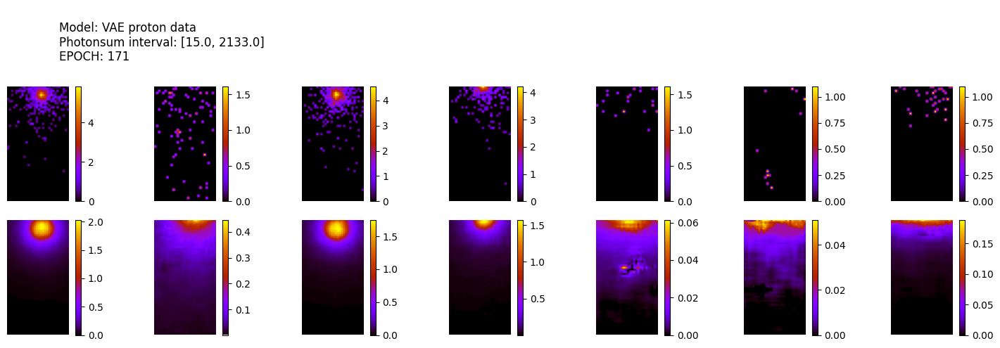

305/305 [==============================] - 1s 4ms/step
ws mean 28.86 ch1 66.33 ch2 5.51 ch3 0.25 ch4 0.01 ch5 72.20 Time for epoch 172 is 27.984264612197876 sec
52500 [Total loss: 98.07] [Recon_loss: 97.76] [KL loss: 0.44]
52600 [Total loss: 81.90] [Recon_loss: 81.87] [KL loss: 0.04]
52700 [Total loss: 98.85] [Recon_loss: 98.81] [KL loss: 0.06]


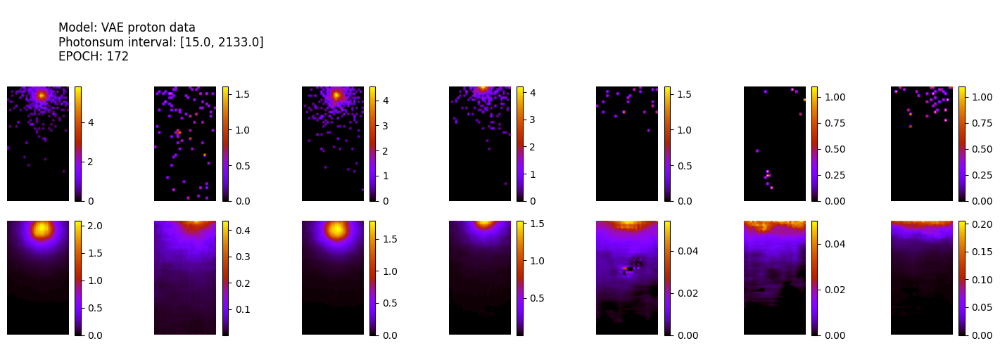

305/305 [==============================] - 1s 4ms/step
ws mean 27.58 ch1 63.29 ch2 5.35 ch3 0.24 ch4 0.01 ch5 69.00 Time for epoch 173 is 28.392701864242554 sec
52800 [Total loss: 99.34] [Recon_loss: 99.28] [KL loss: 0.09]
52900 [Total loss: 84.34] [Recon_loss: 84.32] [KL loss: 0.03]
53000 [Total loss: 99.34] [Recon_loss: 99.30] [KL loss: 0.07]


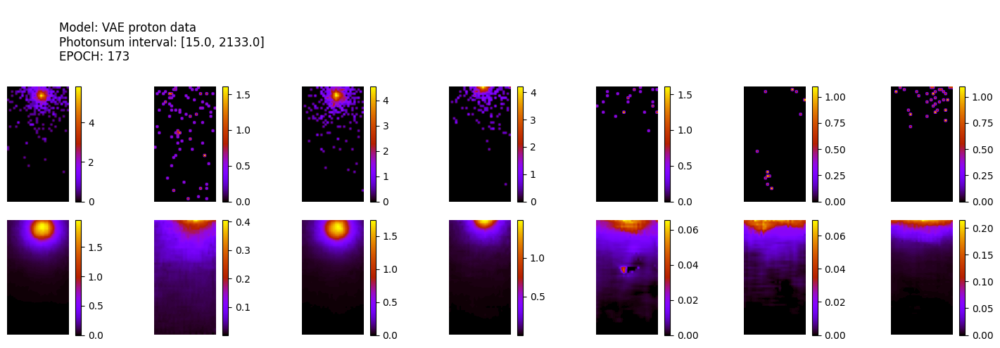

305/305 [==============================] - 1s 4ms/step
ws mean 28.51 ch1 65.75 ch2 5.22 ch3 0.26 ch4 0.01 ch5 71.31 Time for epoch 174 is 28.37152409553528 sec
53100 [Total loss: 98.83] [Recon_loss: 98.76] [KL loss: 0.10]
53200 [Total loss: 99.40] [Recon_loss: 99.33] [KL loss: 0.10]
53300 [Total loss: 79.90] [Recon_loss: 79.79] [KL loss: 0.16]


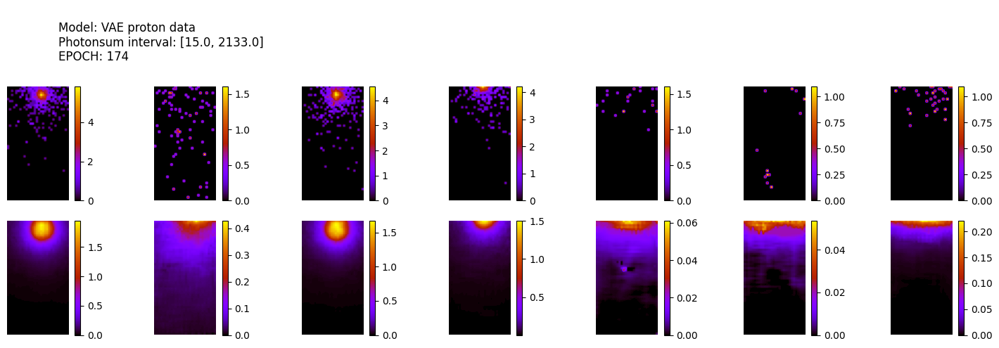

305/305 [==============================] - 1s 4ms/step
ws mean 28.11 ch1 64.96 ch2 4.97 ch3 0.24 ch4 0.01 ch5 70.38 Time for epoch 175 is 28.04976534843445 sec
53400 [Total loss: 105.77] [Recon_loss: 105.71] [KL loss: 0.08]
53500 [Total loss: 83.75] [Recon_loss: 83.60] [KL loss: 0.22]
53600 [Total loss: 95.92] [Recon_loss: 95.75] [KL loss: 0.25]


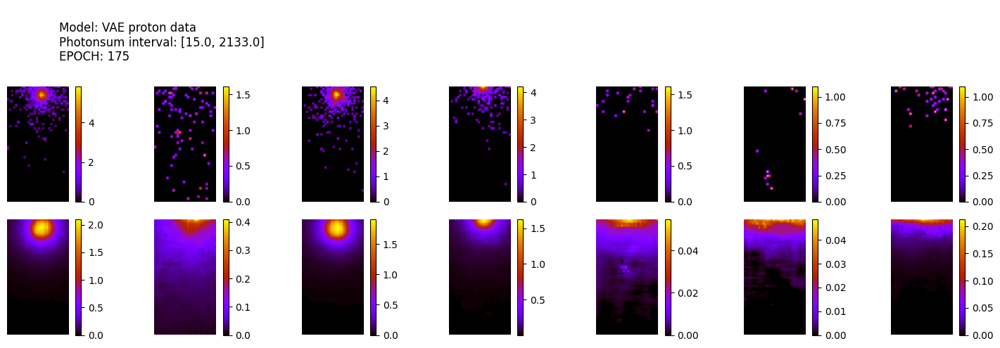

305/305 [==============================] - 1s 4ms/step
ws mean 27.40 ch1 63.07 ch2 5.07 ch3 0.25 ch4 0.01 ch5 68.60 Time for epoch 176 is 28.43513298034668 sec
53700 [Total loss: 103.06] [Recon_loss: 102.97] [KL loss: 0.13]
53800 [Total loss: 99.65] [Recon_loss: 99.57] [KL loss: 0.11]
53900 [Total loss: 107.53] [Recon_loss: 107.39] [KL loss: 0.20]


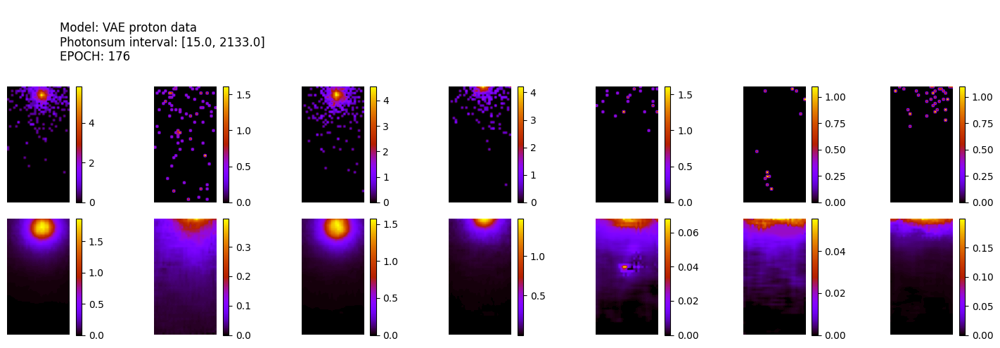

305/305 [==============================] - 1s 4ms/step
ws mean 29.73 ch1 68.59 ch2 5.45 ch3 0.26 ch4 0.01 ch5 74.34 Time for epoch 177 is 28.105071306228638 sec
54000 [Total loss: 76.48] [Recon_loss: 76.44] [KL loss: 0.04]
54100 [Total loss: 104.45] [Recon_loss: 104.31] [KL loss: 0.20]
54200 [Total loss: 90.99] [Recon_loss: 90.94] [KL loss: 0.08]


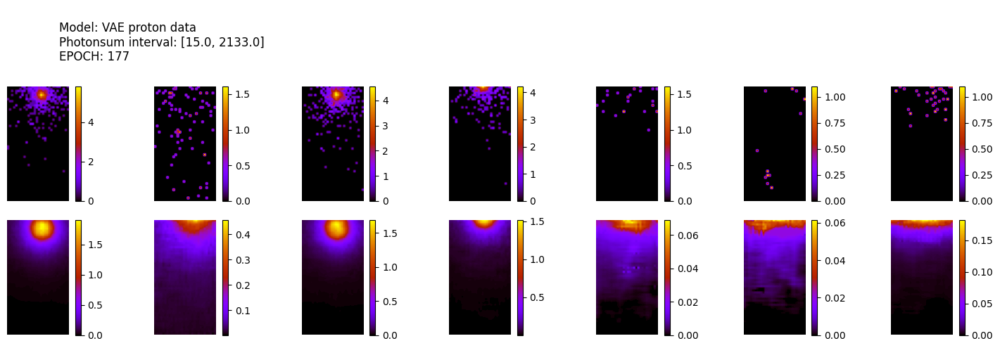

305/305 [==============================] - 1s 4ms/step
ws mean 28.20 ch1 64.84 ch2 5.40 ch3 0.25 ch4 0.01 ch5 70.49 Time for epoch 178 is 28.437834978103638 sec
54300 [Total loss: 88.85] [Recon_loss: 88.79] [KL loss: 0.10]
54400 [Total loss: 101.86] [Recon_loss: 101.75] [KL loss: 0.15]
54500 [Total loss: 84.40] [Recon_loss: 84.39] [KL loss: 0.02]


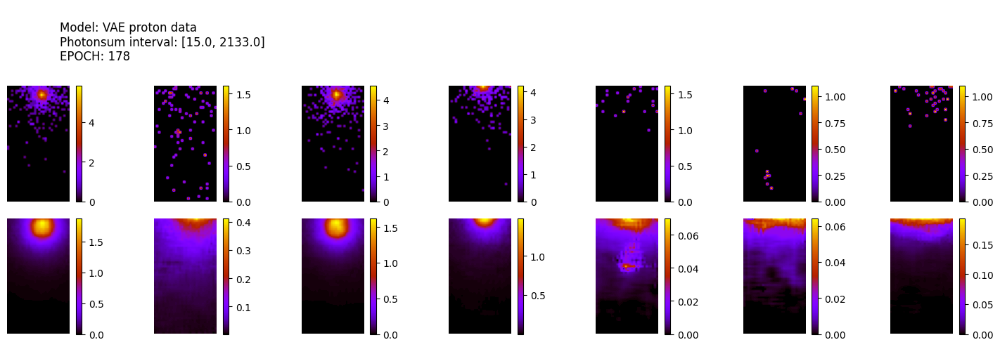

305/305 [==============================] - 1s 4ms/step
ws mean 29.20 ch1 67.35 ch2 5.35 ch3 0.25 ch4 0.01 ch5 73.03 Time for epoch 179 is 28.080036878585815 sec
54600 [Total loss: 101.27] [Recon_loss: 101.18] [KL loss: 0.13]
54700 [Total loss: 96.56] [Recon_loss: 96.53] [KL loss: 0.04]
54800 [Total loss: 88.11] [Recon_loss: 88.04] [KL loss: 0.10]
54900 [Total loss: 102.25] [Recon_loss: 102.04] [KL loss: 0.30]


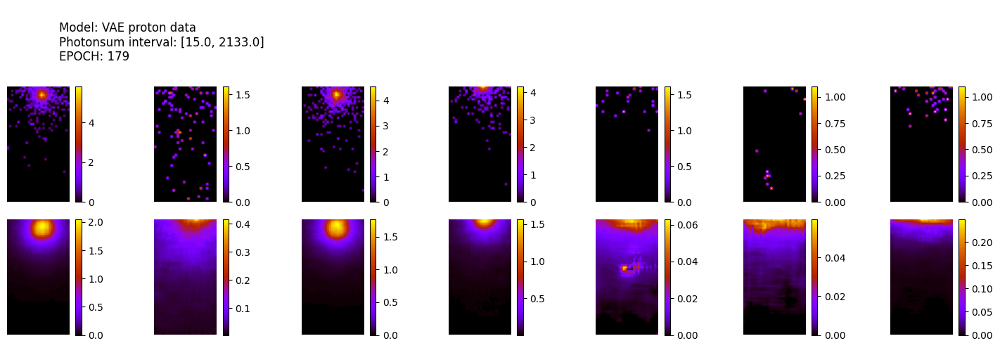

305/305 [==============================] - 1s 4ms/step
ws mean 26.72 ch1 61.93 ch2 4.68 ch3 0.23 ch4 0.01 ch5 66.78 Time for epoch 180 is 28.081483602523804 sec
55000 [Total loss: 84.04] [Recon_loss: 84.01] [KL loss: 0.03]
55100 [Total loss: 86.14] [Recon_loss: 86.05] [KL loss: 0.13]
55200 [Total loss: 87.07] [Recon_loss: 87.01] [KL loss: 0.08]


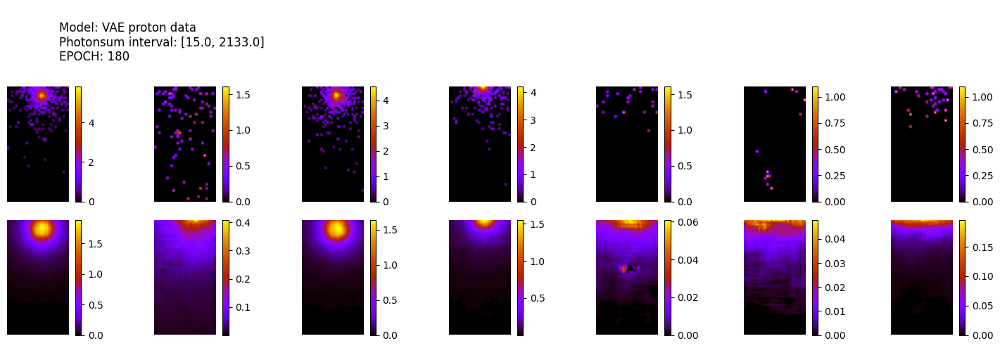

305/305 [==============================] - 1s 4ms/step
ws mean 28.84 ch1 66.71 ch2 5.09 ch3 0.25 ch4 0.01 ch5 72.14 Time for epoch 181 is 28.408313274383545 sec
55300 [Total loss: 92.08] [Recon_loss: 91.94] [KL loss: 0.19]
55400 [Total loss: 86.44] [Recon_loss: 86.37] [KL loss: 0.10]
55500 [Total loss: 103.57] [Recon_loss: 103.47] [KL loss: 0.14]


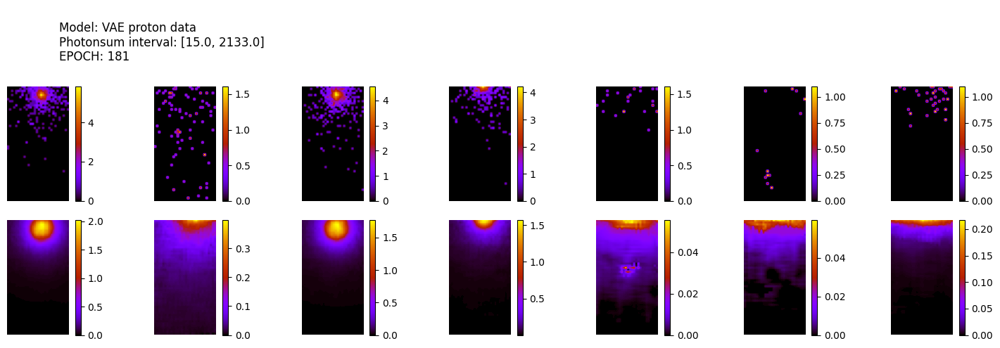

305/305 [==============================] - 1s 4ms/step
ws mean 28.27 ch1 65.00 ch2 5.36 ch3 0.25 ch4 0.01 ch5 70.73 Time for epoch 182 is 28.447507619857788 sec
55600 [Total loss: 84.95] [Recon_loss: 84.86] [KL loss: 0.13]
55700 [Total loss: 84.72] [Recon_loss: 84.56] [KL loss: 0.23]
55800 [Total loss: 96.74] [Recon_loss: 96.64] [KL loss: 0.15]


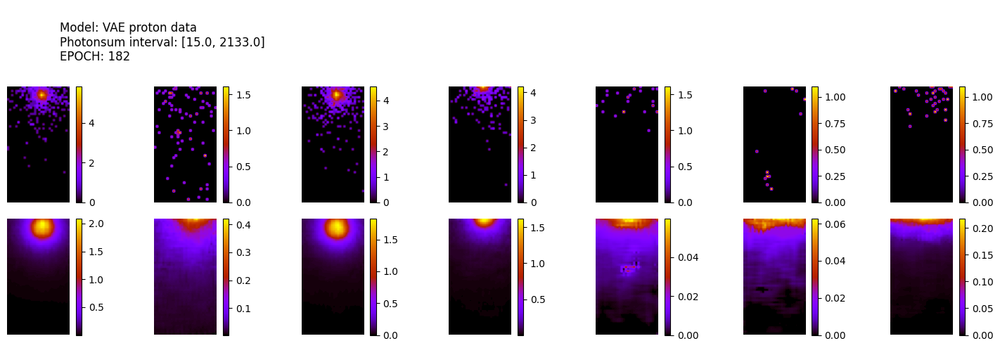

305/305 [==============================] - 1s 4ms/step
ws mean 26.91 ch1 62.22 ch2 4.85 ch3 0.24 ch4 0.01 ch5 67.23 Time for epoch 183 is 28.064318656921387 sec
55900 [Total loss: 89.46] [Recon_loss: 89.35] [KL loss: 0.15]
56000 [Total loss: 86.88] [Recon_loss: 86.84] [KL loss: 0.06]
56100 [Total loss: 100.85] [Recon_loss: 100.73] [KL loss: 0.17]


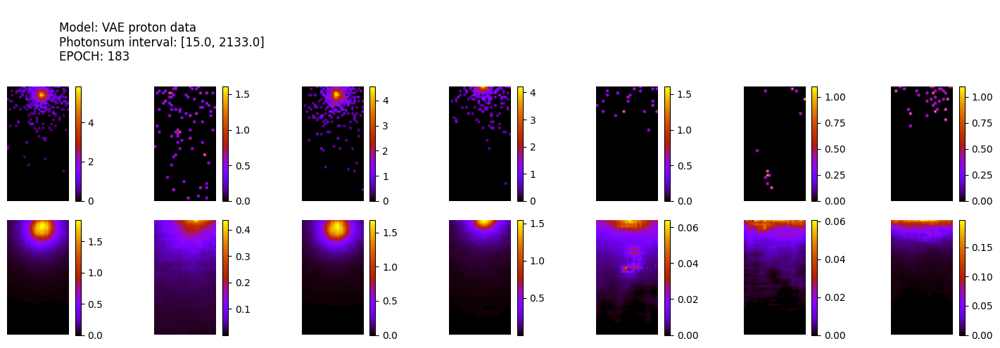

305/305 [==============================] - 1s 4ms/step
ws mean 29.47 ch1 67.95 ch2 5.41 ch3 0.25 ch4 0.01 ch5 73.71 Time for epoch 184 is 28.04167914390564 sec
56200 [Total loss: 107.21] [Recon_loss: 107.11] [KL loss: 0.13]
56300 [Total loss: 105.12] [Recon_loss: 104.98] [KL loss: 0.20]
56400 [Total loss: 100.94] [Recon_loss: 100.89] [KL loss: 0.06]


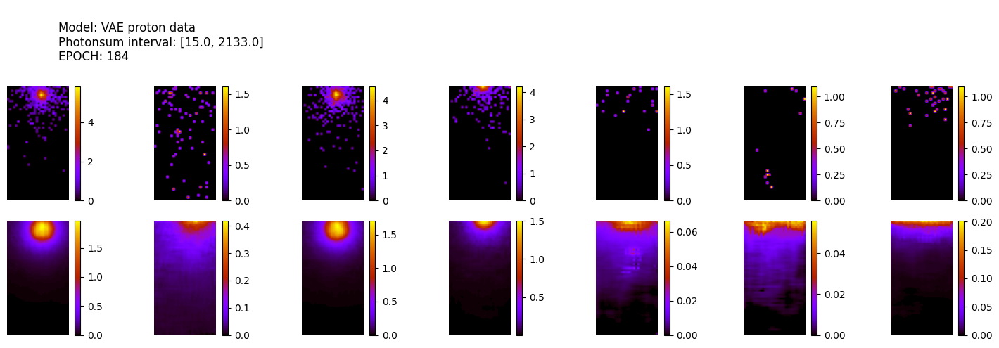

305/305 [==============================] - 1s 4ms/step
ws mean 28.45 ch1 65.61 ch2 5.27 ch3 0.26 ch4 0.01 ch5 71.12 Time for epoch 185 is 28.46707844734192 sec
56500 [Total loss: 106.18] [Recon_loss: 105.84] [KL loss: 0.48]
56600 [Total loss: 95.00] [Recon_loss: 94.91] [KL loss: 0.12]
56700 [Total loss: 88.32] [Recon_loss: 88.27] [KL loss: 0.07]


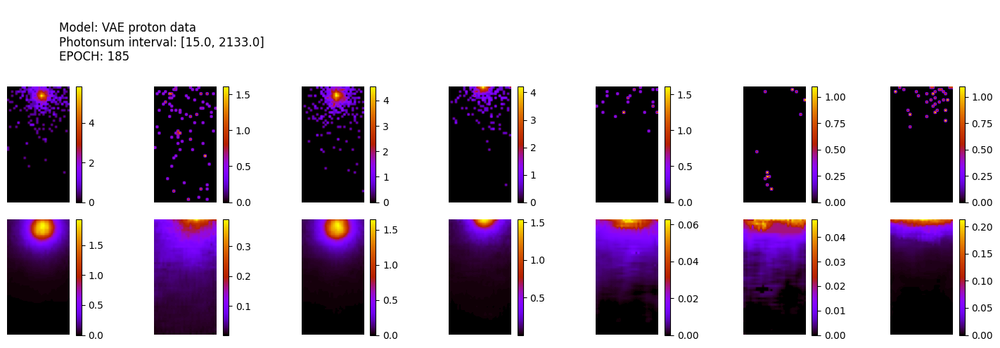

305/305 [==============================] - 1s 4ms/step
ws mean 28.96 ch1 66.62 ch2 5.45 ch3 0.26 ch4 0.01 ch5 72.47 Time for epoch 186 is 28.068816661834717 sec
56800 [Total loss: 95.93] [Recon_loss: 95.90] [KL loss: 0.04]
56900 [Total loss: 82.70] [Recon_loss: 82.66] [KL loss: 0.07]
57000 [Total loss: 101.15] [Recon_loss: 101.13] [KL loss: 0.03]


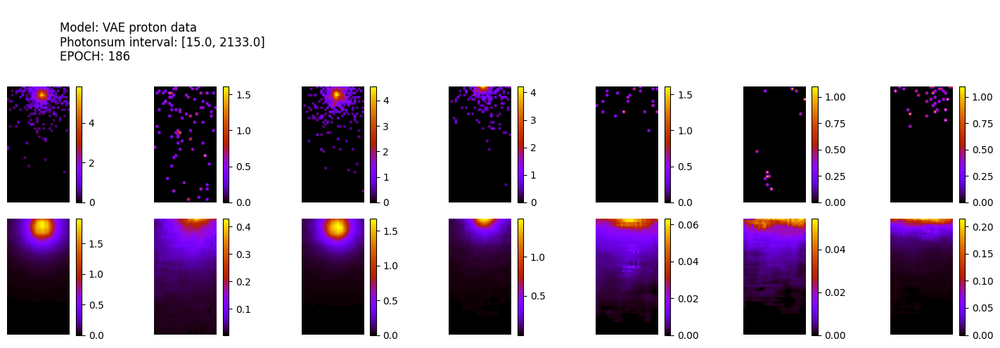

305/305 [==============================] - 1s 4ms/step
ws mean 28.52 ch1 65.63 ch2 5.39 ch3 0.26 ch4 0.01 ch5 71.30 Time for epoch 187 is 28.435723304748535 sec
57100 [Total loss: 100.70] [Recon_loss: 100.54] [KL loss: 0.23]
57200 [Total loss: 89.72] [Recon_loss: 89.63] [KL loss: 0.12]
57300 [Total loss: 104.69] [Recon_loss: 104.62] [KL loss: 0.10]


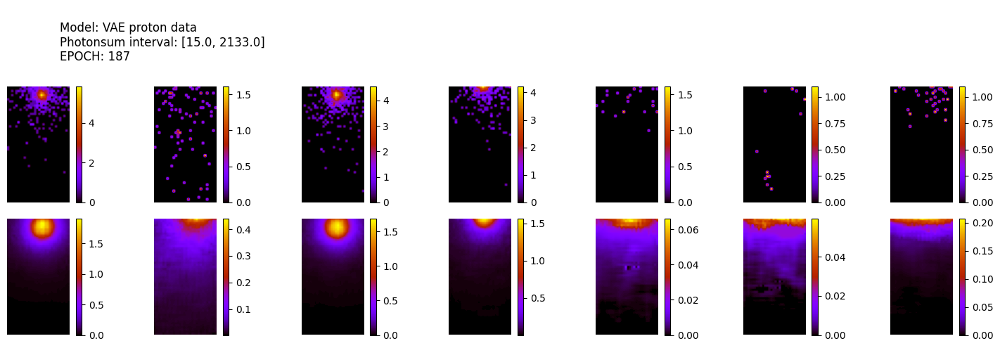

305/305 [==============================] - 1s 4ms/step
ws mean 28.32 ch1 65.39 ch2 5.15 ch3 0.23 ch4 0.01 ch5 70.83 Time for epoch 188 is 28.490423679351807 sec
57400 [Total loss: 103.95] [Recon_loss: 103.87] [KL loss: 0.11]
57500 [Total loss: 99.92] [Recon_loss: 99.77] [KL loss: 0.21]
57600 [Total loss: 101.33] [Recon_loss: 101.30] [KL loss: 0.05]


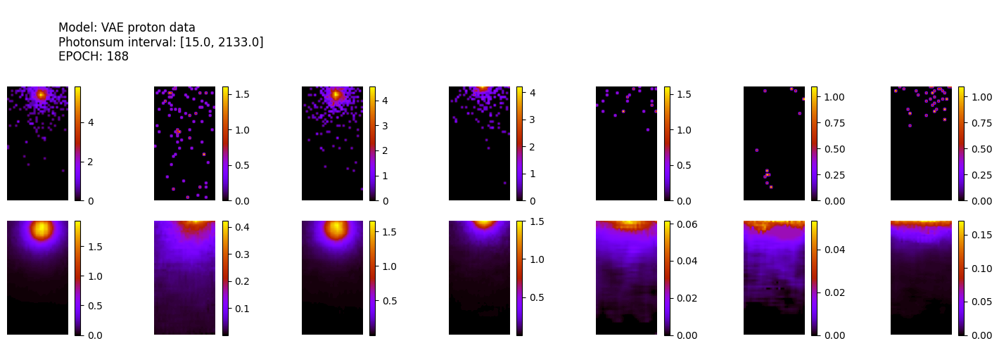

305/305 [==============================] - 1s 4ms/step
ws mean 28.42 ch1 65.66 ch2 5.16 ch3 0.24 ch4 0.01 ch5 71.02 Time for epoch 189 is 28.08831024169922 sec
57700 [Total loss: 80.24] [Recon_loss: 80.21] [KL loss: 0.04]
57800 [Total loss: 96.08] [Recon_loss: 95.95] [KL loss: 0.18]
57900 [Total loss: 80.34] [Recon_loss: 80.31] [KL loss: 0.04]


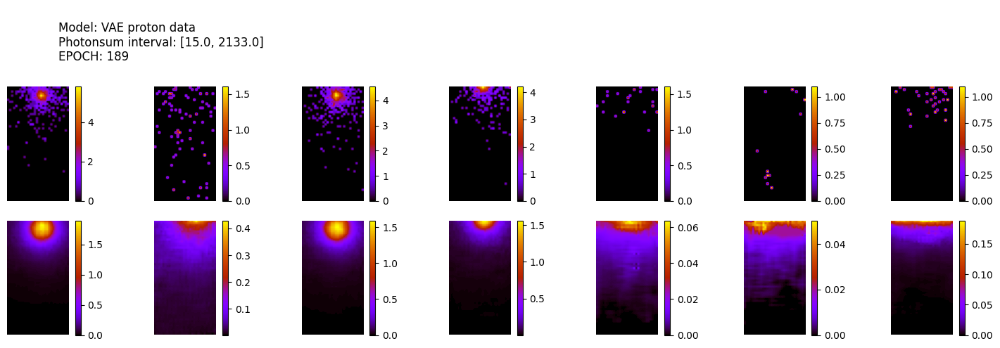

305/305 [==============================] - 1s 4ms/step
ws mean 28.58 ch1 65.85 ch2 5.37 ch3 0.23 ch4 0.01 ch5 71.46 Time for epoch 190 is 28.518946409225464 sec
58000 [Total loss: 98.40] [Recon_loss: 98.29] [KL loss: 0.16]
58100 [Total loss: 81.21] [Recon_loss: 81.12] [KL loss: 0.13]
58200 [Total loss: 85.12] [Recon_loss: 84.87] [KL loss: 0.36]


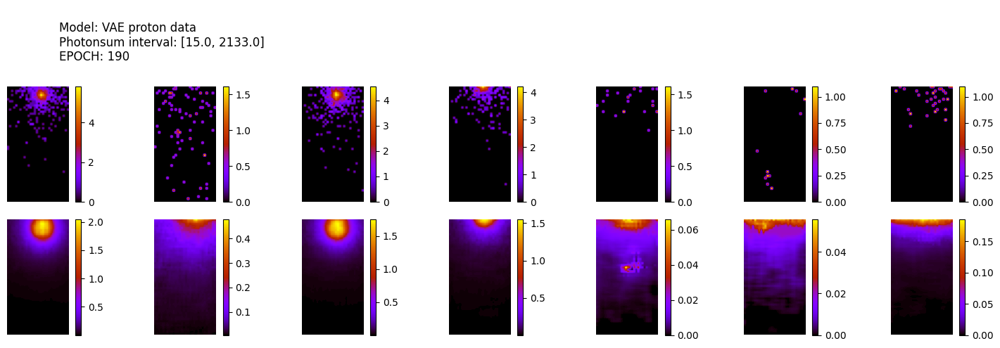

305/305 [==============================] - 1s 4ms/step
ws mean 27.30 ch1 63.08 ch2 4.99 ch3 0.23 ch4 0.01 ch5 68.20 Time for epoch 191 is 28.134325981140137 sec
58300 [Total loss: 92.45] [Recon_loss: 92.28] [KL loss: 0.24]
58400 [Total loss: 95.31] [Recon_loss: 95.18] [KL loss: 0.18]
58500 [Total loss: 84.34] [Recon_loss: 84.33] [KL loss: 0.02]


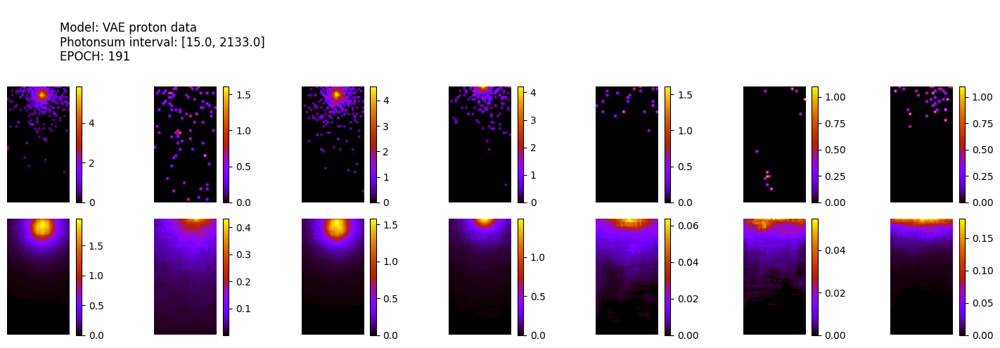

305/305 [==============================] - 1s 4ms/step
ws mean 28.22 ch1 64.88 ch2 5.33 ch3 0.24 ch4 0.01 ch5 70.63 Time for epoch 192 is 28.158448457717896 sec
58600 [Total loss: 101.01] [Recon_loss: 100.80] [KL loss: 0.31]
58700 [Total loss: 105.86] [Recon_loss: 105.60] [KL loss: 0.36]
58800 [Total loss: 93.68] [Recon_loss: 93.64] [KL loss: 0.05]


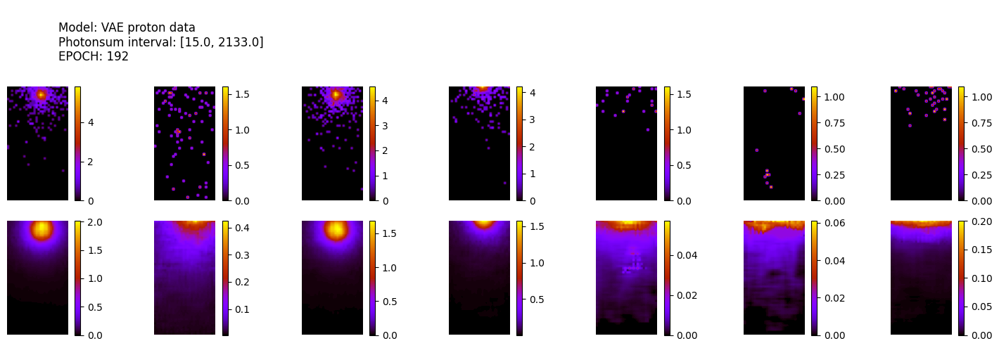

305/305 [==============================] - 1s 4ms/step
ws mean 27.81 ch1 64.20 ch2 5.11 ch3 0.25 ch4 0.01 ch5 69.48 Time for epoch 193 is 28.488129377365112 sec
58900 [Total loss: 93.76] [Recon_loss: 93.74] [KL loss: 0.03]
59000 [Total loss: 95.83] [Recon_loss: 95.78] [KL loss: 0.07]
59100 [Total loss: 89.14] [Recon_loss: 89.03] [KL loss: 0.15]


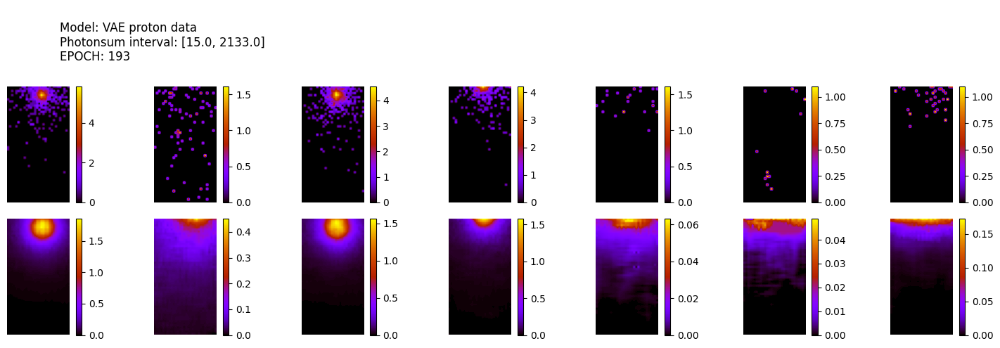

305/305 [==============================] - 1s 4ms/step
ws mean 29.04 ch1 66.92 ch2 5.32 ch3 0.24 ch4 0.01 ch5 72.69 Time for epoch 194 is 28.194178342819214 sec
59200 [Total loss: 96.11] [Recon_loss: 96.07] [KL loss: 0.06]
59300 [Total loss: 110.65] [Recon_loss: 110.57] [KL loss: 0.12]
59400 [Total loss: 98.76] [Recon_loss: 98.58] [KL loss: 0.27]


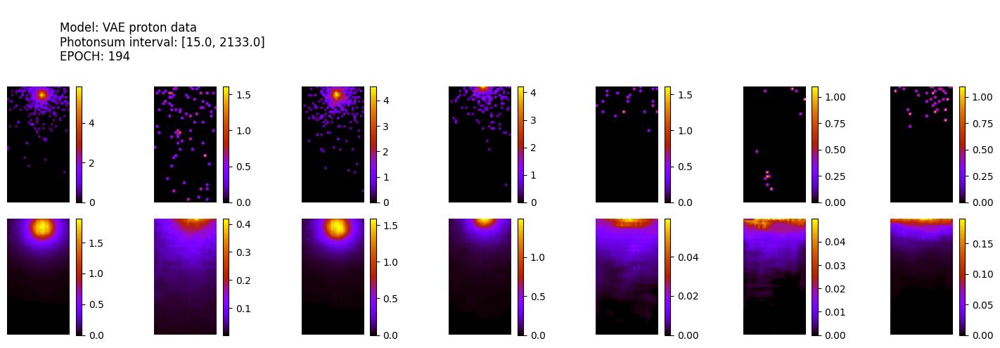

305/305 [==============================] - 1s 4ms/step
ws mean 28.42 ch1 65.29 ch2 5.44 ch3 0.22 ch4 0.01 ch5 71.13 Time for epoch 195 is 28.51718306541443 sec
59500 [Total loss: 87.50] [Recon_loss: 87.47] [KL loss: 0.04]
59600 [Total loss: 100.61] [Recon_loss: 100.49] [KL loss: 0.18]
59700 [Total loss: 92.91] [Recon_loss: 92.87] [KL loss: 0.05]


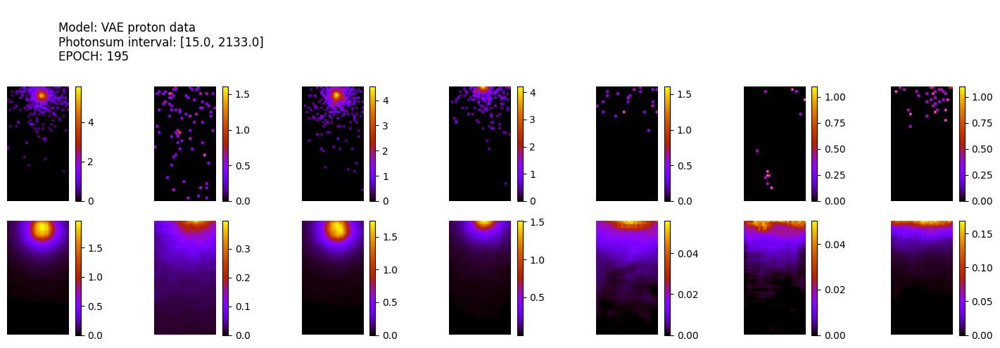

305/305 [==============================] - 1s 4ms/step
ws mean 27.84 ch1 63.95 ch2 5.35 ch3 0.23 ch4 0.01 ch5 69.68 Time for epoch 196 is 28.46743679046631 sec
59800 [Total loss: 89.27] [Recon_loss: 89.19] [KL loss: 0.11]
59900 [Total loss: 96.80] [Recon_loss: 96.77] [KL loss: 0.04]
60000 [Total loss: 77.10] [Recon_loss: 77.09] [KL loss: 0.02]


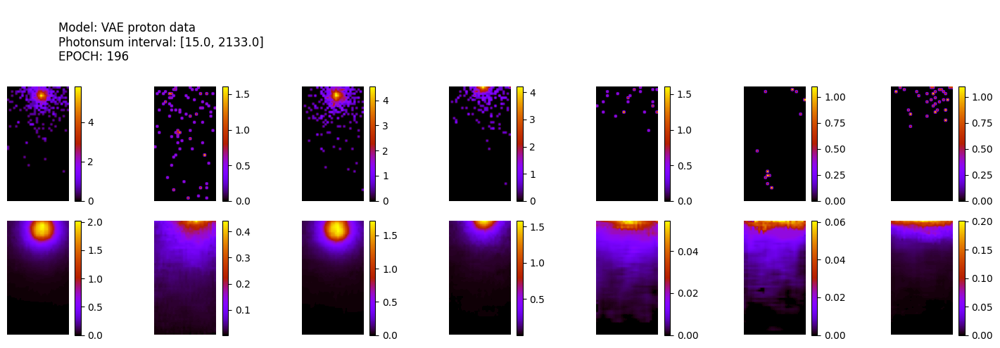

305/305 [==============================] - 1s 4ms/step
ws mean 26.48 ch1 61.22 ch2 4.79 ch3 0.23 ch4 0.01 ch5 66.17 Time for epoch 197 is 28.134870290756226 sec
60100 [Total loss: 97.89] [Recon_loss: 97.83] [KL loss: 0.09]
60200 [Total loss: 96.20] [Recon_loss: 96.14] [KL loss: 0.09]
60300 [Total loss: 92.73] [Recon_loss: 92.72] [KL loss: 0.02]


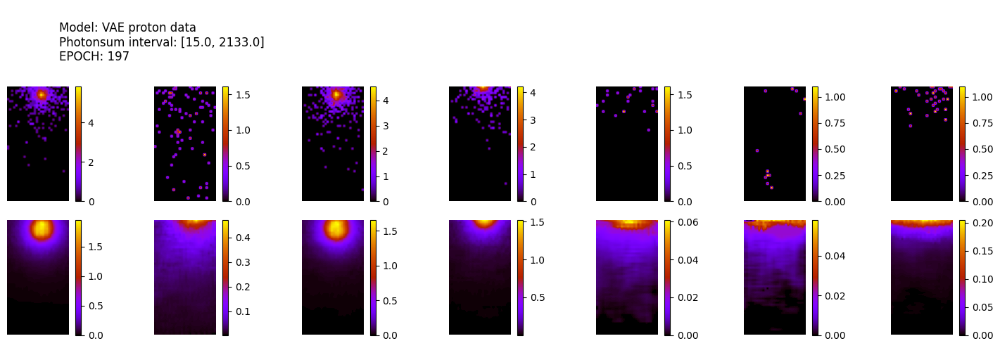

305/305 [==============================] - 1s 4ms/step
ws mean 26.76 ch1 61.97 ch2 4.74 ch3 0.21 ch4 0.01 ch5 66.89 Time for epoch 198 is 28.510753870010376 sec
60400 [Total loss: 83.97] [Recon_loss: 83.96] [KL loss: 0.01]
60500 [Total loss: 80.83] [Recon_loss: 80.82] [KL loss: 0.01]
60600 [Total loss: 79.97] [Recon_loss: 79.95] [KL loss: 0.03]


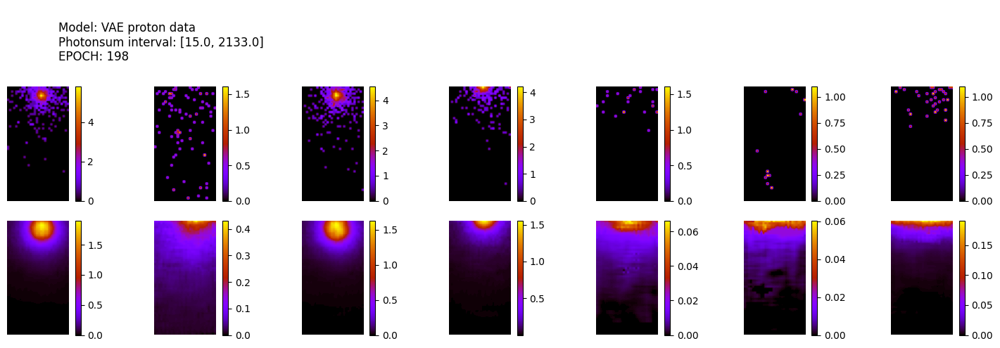

305/305 [==============================] - 1s 4ms/step
ws mean 28.22 ch1 65.23 ch2 5.04 ch3 0.23 ch4 0.01 ch5 70.59 Time for epoch 199 is 28.14343810081482 sec
60700 [Total loss: 80.62] [Recon_loss: 80.57] [KL loss: 0.07]
60800 [Total loss: 94.74] [Recon_loss: 94.64] [KL loss: 0.14]
60900 [Total loss: 100.28] [Recon_loss: 100.10] [KL loss: 0.26]
61000 [Total loss: 103.25] [Recon_loss: 102.84] [KL loss: 0.59]


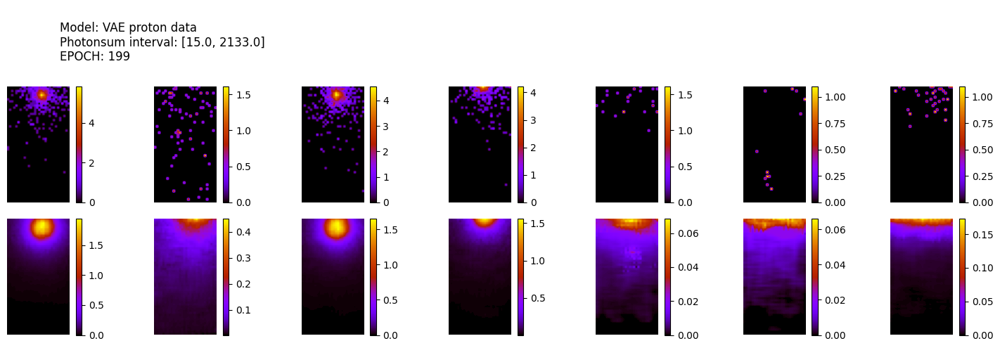

305/305 [==============================] - 1s 4ms/step
ws mean 27.36 ch1 63.51 ch2 4.72 ch3 0.24 ch4 0.01 ch5 68.35 Time for epoch 200 is 28.5481379032135 sec


In [24]:
history=train(dataset_with_cond, EPOCHS)

## Visualize losses

In [22]:
import seaborn as sns

sns.set_context('notebook', font_scale = 1)

In [23]:
# total_loss, reconstruction_loss, kl_loss
history_losses = np.array([[float(loss) for loss in losses] for losses in history])

In [24]:
total_loss = history_losses[:,0]
reconstruction_loss = history_losses[:,1]
kl_loss = history_losses[:,2]

In [25]:
a4_dims = (14, 5)
def print_loss(loss_values, loss_str):
    fig, ax = plt.subplots(figsize=a4_dims)
    sns.lineplot(loss_values)
    plt.xscale('log')
    plt.yscale('log')
    ax.set_title(f"{loss_str} loss in each epoch")
    ax.set_xlabel("Epoch number")
    ax.set_ylabel(f"{loss_str} loss value")
    plt.savefig(os.path.join(filepath_img, f"{loss_str}_loss"))

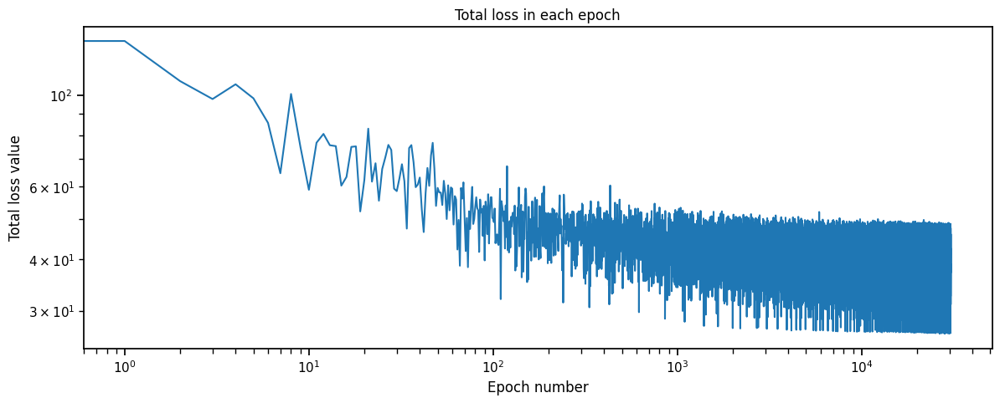

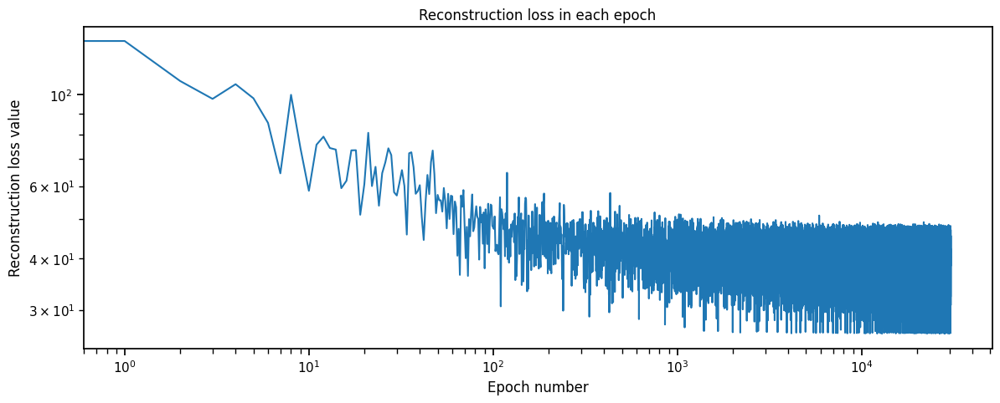

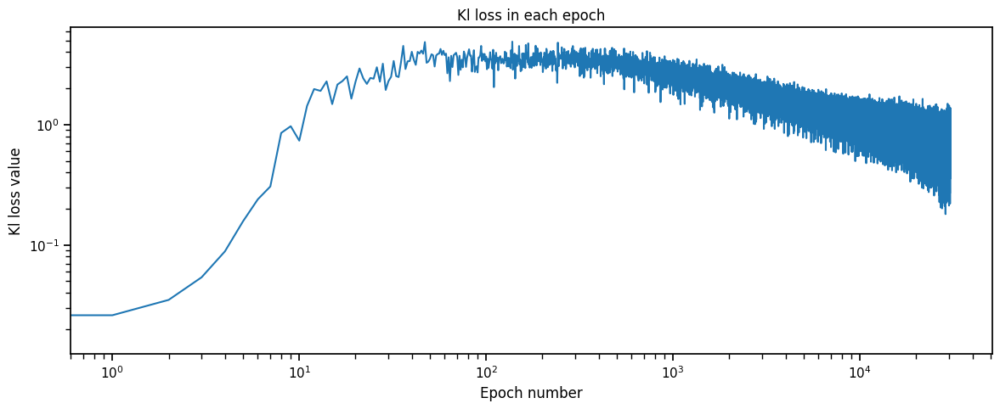

In [26]:
print_loss(total_loss, "Total")
print_loss(reconstruction_loss, "Reconstruction")
print_loss(kl_loss, "Kl")